# Neural ODEs for Phase Space Estimation
By Mankrit Singh, Raghav Juyal and Yilin Tang

## Imports

In [25]:
pip install --quiet numpy==1.21.1

Note: you may need to restart the kernel to use updated packages.


ERROR: Exception:
Traceback (most recent call last):
  File "c:\Users\singh\anaconda3\Lib\site-packages\pip\_internal\cli\base_command.py", line 180, in exc_logging_wrapper
    status = run_func(*args)
             ^^^^^^^^^^^^^^^
  File "c:\Users\singh\anaconda3\Lib\site-packages\pip\_internal\cli\req_command.py", line 245, in wrapper
    return func(self, options, args)
           ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "c:\Users\singh\anaconda3\Lib\site-packages\pip\_internal\commands\install.py", line 377, in run
    requirement_set = resolver.resolve(
                      ^^^^^^^^^^^^^^^^^
  File "c:\Users\singh\anaconda3\Lib\site-packages\pip\_internal\resolution\resolvelib\resolver.py", line 95, in resolve
    result = self._result = resolver.resolve(
                            ^^^^^^^^^^^^^^^^^
  File "c:\Users\singh\anaconda3\Lib\site-packages\pip\_vendor\resolvelib\resolvers.py", line 546, in resolve
    state = resolution.resolve(requirements, max_rounds=max_rounds)
            ^

In [26]:
pip install --quiet pysindy==1.7.3

Note: you may need to restart the kernel to use updated packages.


In [27]:
%matplotlib inline
import time
import pysindy as ps
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset

from tqdm import tqdm

try:
    import torchdiffeq
except ModuleNotFoundError:
    !pip install --quiet torchdiffeq
    import torchdiffeq

try:
    import rich
except ModuleNotFoundError:
    !pip install --quiet rich
    import rich

try:
    import pytorch_lightning as pl
except ModuleNotFoundError:
    !pip install --quiet pytorch-lightning>=1.4
    import pytorch_lightning as pl

pl.seed_everything(42)

torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
from torch.utils.data import DataLoader, random_split
from scipy.spatial.distance import directed_hausdorff
from scipy.optimize import fmin
from scipy.interpolate import LinearNDInterpolator

device = torch.device("cpu")
print(f"Device: {device}")

Seed set to 42


Device: cpu


## Class for 2D systems

This class generates data, implements the Neural ODE, computs error metrics and Plots outputs for 2D systems

In [28]:
class NODE():
  def __init__(self, equation=None, train_parameters = [100,1.0,0.01,0.1,0.1,None], test_parameters = [100,1.0,0.01,0.1,0.1,None] , train_data=None, test_data=None):
        """
            Initialize the NODE (Neural ODE) class.

            Parameters:
            - equation: function representing the ground truth ODE system (used for data generation)
            - train_parameters: list containing parameters for training data generation:
                [num_trajectories, time_span, step_size, theta_range, omega_range, starting_points]
            - test_parameters: list containing parameters for testing data generation (same format as train_parameters)
            - train_data: optional preloaded training data (if not generating from equation)
            - test_data: optional preloaded testing data

            Behavior:
            - If equation is provided, synthetic training and testing datasets are generated.
            - If train_data and test_data are provided instead, they are used directly.
            - Initializes placeholders for model, learner, dataset, and logging variables.
            - Optionally prepares for sparse identification of dynamics (SINDy) via sindy_data.
        """
        super().__init__()
        self.equation = equation
        self.train_num_trajectories = train_parameters[0]
        self.train_time_span = train_parameters[1]
        self.train_h = train_parameters[2]
        self.train_theta_range = train_parameters[3]
        self.train_omega_range = train_parameters[4]
        self.train_starting_points = train_parameters[5]

        self.test_num_trajectories = test_parameters[0]
        self.test_time_span = test_parameters[1]
        self.test_h = test_parameters[2]
        self.test_theta_range = test_parameters[3]
        self.test_omega_range = test_parameters[4]
        self.test_starting_points = test_parameters[5]

        self.train_data = train_data
        self.test_data = test_data

        self.model = None
        self.learner = None
        self.t_span = None
        self.dataset = None
        self.start_time = None
        self.end_time = None
        if (self.train_data is None or self.test_data is None) and self.equation is None:
          print("Need both train and test data or equation")
          exit(1)
        if self.equation is not None:
          self.train_data = self.generate_dataset(self.equation, num_trajectories=self.train_num_trajectories, time_span=self.train_time_span, h=self.train_h, theta_range = self.train_theta_range, omega_range = self.train_omega_range,starting_points = self.train_starting_points)
          self.test_data = self.generate_dataset(self.equation, num_trajectories=self.test_num_trajectories, time_span=self.test_time_span, h=self.test_h, theta_range = self.test_theta_range, omega_range = self.test_omega_range,starting_points = self.test_starting_points)

        self.sindy_data = None

  def rk4(self,f, x0, y0, h, n):
    """
        Runge-Kutta 4th order (RK4) integrator for solving a 2D ODE system.

        Parameters:
        - f: callable representing the vector field, must return a 2D array [dx/dt, dy/dt]
        - x0: initial x value
        - y0: initial y value
        - h: step size
        - n: number of integration steps

        Returns:
        - t: array of time points from 0 to n*h
        - v: array of shape (n+1, 2), containing the trajectory of the system
        """
    v = [0]*(n+1)
    v[0] = np.array([x0, y0])
    x = x0
    y = y0
    for i in range(1, n + 1):
        k1 = h*f(x, y)
        k2 = h*f(x + 0.5*k1[0], y + 0.5*k1[1])
        k3 = h*f(x + 0.5*k2[0], y + 0.5*k2[1])
        k4 = h*f(x + k3[0], y + k3[1])
        v[i] =  v[i-1] + (k1 + k2 + k2 + k3 + k3 + k4)/6
        x = v[i][0]
        y = v[i][1]

    t = np.array([i*h for i in range(0, n+1)])
    return t, np.array(v)

  def generate_dataset(self,f, num_trajectories=100, time_span=1.0, h=0.01,theta_range = 1, omega_range = 1,starting_points = None):
    """
    Generates a dataset of trajectories for a given 2D dynamical system using the RK4 integrator.

    Parameters:
    - f: callable representing the vector field (θ', ω')
    - num_trajectories: number of trajectories to simulate
    - time_span: total time of simulation
    - h: integration step size
    - theta_range: scalar or [min, max] range for initial θ
    - omega_range: scalar or [min, max] range for initial ω
    - starting_points: optional list of specific (θ₀, ω₀) initial conditions

    Returns:
    - dataset: list of tuples (initial_state, time_points, trajectory) for each trajectory
    """
    n = int(time_span / h)
    t = np.linspace(0, time_span, n + 1)
    
    dataset = []
    if starting_points is None:
      for _ in range(num_trajectories):
          # Sample random initial conditions: theta ∈ [-π, π], omega ∈ [-1, 1]
          if type(theta_range) is not list:
            theta0 = np.random.uniform(-theta_range, theta_range)
          else:
            theta0 = np.random.uniform(theta_range[0],theta_range[1])
          if type(omega_range) is not list:
            omega0 = np.random.uniform(-omega_range, omega_range)
          else:
            omega0 = np.random.uniform(omega_range[0],omega_range[1])

          _, v = self.rk4(f, theta0, omega0, h, n)  # shape: (n+1, 2)
          dataset.append((np.array([theta0, omega0]), t, v))  # (initial_state, time_points, trajectory)
    else:
      for theta0, omega0 in starting_points:
        _, v = self.rk4(f, theta0, omega0, h, n)  # shape: (n+1, 2)
        dataset.append((np.array([theta0, omega0]), t, v))  # (initial_state, time_points, trajectory)

    return dataset

  class Dataset(Dataset):
    """
    PyTorch-compatible dataset wrapper for trajectory data.

    Parameters:
    - raw_dataset: list of tuples (initial_state, time_points, trajectory)

    Each sample returned contains:
    - 'initial': the initial state as a float32 tensor
    - 'trajectory': the trajectory as a float32 tensor
    """
    def __init__(self, raw_dataset):
        self.data = raw_dataset

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        x0, t, traj = self.data[idx]
        return {
            'initial': torch.tensor(x0, dtype=torch.float32),
            'trajectory': torch.tensor(traj, dtype=torch.float32),
        }
  def plot_trajectory_actual(self,raw_data = None,title = 'Trajectories in Phase Space'):
    """
    Plots the true trajectories in phase space from the dataset.

    Parameters:
    - raw_data: list of tuples (initial_state, time_points, trajectory). If None, uses self.train_data.
    - title: title of the plot.

    Displays:
    - A 2D phase space plot with trajectories (x vs. y) for each initial condition.
    """
    if raw_data is None:
      raw_data = self.train_data
    fig, ax = plt.subplots(figsize=(8, 6))
    for theta, t, traj in raw_data:
        ax.plot(traj[:, 0], traj[:, 1])
    ax.set_xlabel(r'x')
    ax.set_ylabel(r'y')
    ax.set_title(title)
    ax.grid(True)
    plt.tight_layout()
    plt.show()

  class DataModule(pl.LightningDataModule):
    """
    PyTorch Lightning data module for handling dataset splits and data loaders.
    """
    def __init__(self, dataset, batch_size=32):
        super().__init__()
        self.dataset = dataset
        self.batch_size = batch_size

    def setup(self, stage=None):
        total_size = len(self.dataset)
        val_size = test_size = total_size // 10
        train_size = total_size - val_size - test_size
        self.train_dataset, self.val_dataset, self.test_dataset = random_split(
            self.dataset, [train_size, val_size, test_size]
        )

    def train_dataloader(self):
        return DataLoader(self.train_dataset, batch_size=self.batch_size, shuffle=True)

    def val_dataloader(self):
        return DataLoader(self.val_dataset, batch_size=self.batch_size)

    def test_dataloader(self):
        return DataLoader(self.test_dataset, batch_size=self.batch_size)

  class _ODEFunc(nn.Module):
    """
    Wraps a neural network module to define a differentiable ODE function.
    """
    def __init__(self, module, autonomous=True):
        super().__init__()
        self.module = module
        self.autonomous = autonomous

    def forward(self, t, x):
        if not self.autonomous:
            x = torch.cat([torch.ones_like(x[:, [0]]) * t, x], 1)
        return self.module(x)


  class ODEBlock(nn.Module):
    """
    Encapsulates an ODE solver that integrates a neural ODE function over a time interval.

    Parameters:
    - odefunc: nn.Module representing the dynamics of the system (i.e., f(x) or f(t, x)).
    - solver: ODE solver method name (e.g., 'dopri5', 'rk4').
    - rtol: Relative tolerance for the ODE solver.
    - atol: Absolute tolerance for the ODE solver.
    - adjoint: Whether to use the adjoint sensitivity method for backpropagation.
    - autonomous: Whether the dynamics are time-invariant (if False, time is included in the input).
    """
    def __init__(self, odefunc: nn.Module, solver: str = 'dopri5',
                rtol: float = 1e-4, atol: float = 1e-4, adjoint: bool = True,
                autonomous: bool = True):
        super().__init__()
        self.odefunc = NODE._ODEFunc(odefunc, autonomous=autonomous)
        self.rtol = rtol
        self.atol = atol
        self.solver = solver
        self.use_adjoint = adjoint
        self.integration_time = torch.tensor([0, 1], dtype=torch.float32)

    @property
    def ode_method(self):
        return torchdiffeq.odeint_adjoint if self.use_adjoint else torchdiffeq.odeint

    def forward(self, x: torch.Tensor, adjoint: bool = True, integration_time=None):
        integration_time = self.integration_time if integration_time is None else integration_time
        integration_time = integration_time.to(x.device)
        ode_method =  torchdiffeq.odeint_adjoint if adjoint else torchdiffeq.odeint
        out = ode_method(
            self.odefunc, x, integration_time, rtol=self.rtol,
            atol=self.atol, method=self.solver)
        return out

  class Learner(pl.LightningModule):
    """
    PyTorch Lightning module for training a Neural ODE model using mean squared error loss.

    Parameters:
    - model: A neural ODE model, typically wrapped in an ODEBlock.
    - t_span: A 1D tensor of time points over which the trajectory is predicted.
    - learning_rate: Learning rate for the optimizer (default: 5e-3).
    """
    def __init__(self, model: nn.Module, t_span: torch.Tensor, learning_rate: float = 5e-3):
        super().__init__()
        self.model = model
        self.t_span = t_span
        self.learning_rate = learning_rate

    def forward(self, x, t):
        return self.model(x, integration_time=t)

    def training_step(self, batch, batch_idx):
        x0 = batch['initial']
        t = self.t_span
        y_true = batch['trajectory']
        y_pred = self.model(x0, adjoint=True, integration_time=t)
        loss = F.mse_loss(y_pred.transpose(0, 1), y_true)  # Shape [batch, time, dim]
        self.log('train_loss', loss, prog_bar=True)
        return loss

    def validation_step(self, batch, batch_idx):
        x0 = batch['initial']
        t = self.t_span
        y_true = batch['trajectory']
        y_pred = self.model(x0, adjoint=False, integration_time=t)
        loss = F.mse_loss(y_pred.transpose(0, 1), y_true)
        self.log('val_loss', loss, prog_bar=True)
        return loss

    def test_step(self, batch, batch_idx):
        x0 = batch['initial']
        t = self.t_span
        y_true = batch['trajectory']
        y_pred = self.model(x0, adjoint=False, integration_time=t)
        loss = F.mse_loss(y_pred.transpose(0, 1), y_true)
        self.log('test_loss', loss, prog_bar=True)
        return loss

        z_pred = self.model(z0, integration_time=t)
        loss = torch.mean((z_pred - z_true) ** 2)
        self.log('test_loss', loss, prog_bar=True)
        return loss

    def configure_optimizers(self):
        return torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)

  def train(self,raw_dataset = None):
    """
    Trains the Neural ODE model on the provided dataset or on the default training data.

    Parameters:
    - raw_dataset: Optional dataset to train on. If None, uses the class's stored training data.
    """
    if raw_dataset is None:
      raw_dataset = self.train_data
    adjoint = True
    # Create your dataset and datamodule
    self.dataset = self.Dataset(raw_dataset)
    data_module = self.DataModule(self.dataset)

    # Define model
    f = nn.Sequential(
        nn.Linear(2, 64),
        nn.SiLU(),
        nn.Linear(64, 64),
        nn.SiLU(),
        nn.Linear(64, 2)
    )
    self.model = self.ODEBlock(f, adjoint=adjoint)

    # Define learner
    self.t_span = torch.tensor(raw_dataset[0][1], dtype=torch.float32)  # assuming all share same t
    self.learner = self.Learner(self.model, self.t_span)
    self.start_time = time.time()
    # Train
    trainer = pl.Trainer(
        max_epochs=200,
        accelerator="cpu",
        devices=1,
        callbacks=[
            pl.callbacks.ModelCheckpoint(monitor="val_loss", mode="min"),
            pl.callbacks.RichProgressBar()
        ],
        log_every_n_steps=1,
        default_root_dir="/lightning_logs"
    )
    trainer.fit(self.learner, datamodule=data_module)
    val_result = trainer.validate(self.learner, datamodule=data_module)
    test_result = trainer.test(self.learner, datamodule=data_module)
    self.end_time = time.time()
    
  def plot_phase_space_from_sample(self,sample_idx = 0, dataset = None, learner = None):
    """
    Plots the phase space trajectory comparing true and predicted solutions for a single sample.

    Parameters:
    - sample_idx: Index of the trajectory sample to plot.
    - dataset: Optional dataset to use; defaults to the class's dataset.
    - learner: Optional trained model to generate predictions; defaults to the class's learner.
    """
    if dataset is None:
      dataset = self.dataset
    if learner is None:
      learner = self.learner
    sample = dataset[sample_idx]
    x0 = sample['initial'].unsqueeze(0)  # shape [1, 2]
    t = self.t_span
    true_traj = sample['trajectory'].numpy()

    learner.eval()
    with torch.no_grad():
        pred_traj = learner(x0, t).squeeze().cpu().numpy()

    plt.figure(figsize=(6, 6))
    plt.plot(true_traj[:, 0], true_traj[:, 1], label="True", lw=2)
    plt.plot(pred_traj[:, 0], pred_traj[:, 1], '--', label="Predicted", lw=2)
    plt.xlabel(r"x")
    plt.ylabel(r"y")
    plt.title(f"Phase Space (sample {sample_idx})")
    plt.legend()
    plt.grid(True)
    plt.axis('equal')
    plt.show()

  def plot_trajectory_vs_time_from_sample(self,sample_idx = 0, dataset=None, learner=None):
    """
    Plots the true and predicted trajectories of system variables over time for a single sample.

    Parameters:
    - sample_idx: Index of the trajectory sample to plot.
    - dataset: Optional dataset to use; defaults to the class's dataset.
    - learner: Optional trained model to generate predictions; defaults to the class's learner.
    """
    if dataset is None:
      dataset = self.dataset
    if learner is None:
      learner = self.learner
    sample = dataset[sample_idx]
    x0 = sample['initial'].unsqueeze(0)
    t = self.t_span
    true_traj = sample['trajectory'].numpy()

    learner.eval()
    with torch.no_grad():
        pred_traj = learner(x0, t).squeeze().cpu().numpy()

    t_np = t.cpu().numpy()
    fig, axs = plt.subplots(2, 1, figsize=(10, 5), sharex=True)

    axs[0].plot(t_np, true_traj[:, 0], label='True θ', lw=2)
    axs[0].plot(t_np, pred_traj[:, 0], '--', label='Pred θ')
    axs[0].set_ylabel(r"$\theta$")
    axs[0].legend()
    axs[0].grid(True)

    axs[1].plot(t_np, true_traj[:, 1], label='True ω', lw=2)
    axs[1].plot(t_np, pred_traj[:, 1], '--', label='Pred ω')
    axs[1].set_ylabel(r"$\omega$")
    axs[1].set_xlabel("Time")
    axs[1].legend()
    axs[1].grid(True)

    plt.tight_layout()
    plt.show()

  def plot_learned_vector_field(self,model_func= None, theta_range=(-5, 5), omega_range=(-5, 5), density=20):
    """
    Plots the learned vector field from the NODE model over a specified range of theta and omega values.

    Parameters:
    - model_func: Optional function representing the learned dynamics; defaults to the learner's ODE function.
    - theta_range: Tuple specifying the min and max values for theta axis.
    - omega_range: Tuple specifying the min and max values for omega axis.
    - density: Number of points per axis to evaluate the vector field (controls resolution).
    """
    if model_func is None:
      model_func = self.learner.model.odefunc
    # Create a grid of theta and omega values
    theta = np.linspace(*theta_range, density)
    omega = np.linspace(*omega_range, density)
    THETA, OMEGA = np.meshgrid(theta, omega)
    grid = np.stack([THETA.ravel(), OMEGA.ravel()], axis=1)

    with torch.no_grad():
        grid_tensor = torch.tensor(grid, dtype=torch.float32)
        # NODE expects (t, x) as input
        vectors = model_func(0, grid_tensor).cpu().numpy()

    U = vectors[:, 0].reshape(THETA.shape)
    V = vectors[:, 1].reshape(OMEGA.shape)
    magnitude = np.sqrt(U**2 + V**2)

    plt.figure(figsize=(7, 6))
    plt.contourf(THETA, OMEGA, magnitude, cmap='RdYlBu', levels=50)
    plt.quiver(THETA, OMEGA, U, V, angles='xy', color='k', alpha=0.8, width=0.002)
    # plt.quiver(THETA, OMEGA, U, V, angles='xy')
    plt.xlabel(r"$\theta$")
    plt.ylabel(r"$\omega$")
    plt.title("Learned Vector Field")
    plt.grid(True)
    plt.axis('equal')
    plt.show()

  def plot_phase_space_for_all_samples(self, dataset = None, learner = None,t=None):
    """
    Plots the predicted phase space trajectories (θ vs ω) for all samples in the dataset.

    Parameters:
    - dataset: Optional dataset containing trajectory samples; defaults to the class's dataset.
    - learner: Optional trained model to generate predictions; defaults to the class's learner.
    - t: Optional time array over which to evaluate trajectories; defaults to the class's time span.
    """
    if dataset is None:
      dataset = self.dataset
    if learner is None:
      learner = self.learner
    if t is None:
      t = self.t_span
    learner.eval()
    plt.figure(figsize=(10, 6))

    for sample_idx, sample in enumerate(dataset):
        x0 = sample['initial'].unsqueeze(0)  # shape [1, 2]
        true_traj = sample['trajectory'].numpy()

        with torch.no_grad():
            pred_traj = learner(x0, t).squeeze().cpu().numpy()

        # plt.plot(true_traj[:, 0], true_traj[:, 1], label=f"True (sample {sample_idx})", lw=2,color = "C0")
        plt.plot(pred_traj[:, 0], pred_traj[:, 1], '--', label=f"Predicted (sample {sample_idx})", lw=2,color = "C0")
        plt.ylim(-3, 3)

    plt.xlabel(r"$\theta$")
    plt.ylabel(r"$\omega$")
    plt.title(f"Phase Space for All Samples")
    plt.grid(True)
    plt.axis('equal')
    plt.show()
    
  def evaluate_errors(self, dataset=None, learner=None, t=None):
    """
    Computes evaluation metrics comparing the learned trajectory predictions to ground truth trajectories.

    Parameters:
    - dataset: Optional dataset of trajectory samples; defaults to the class's dataset.
    - learner: Optional trained model to generate predictions; defaults to the class's learner.
    - t: Optional time points at which trajectories are evaluated; defaults to the class's time span.

    Returns:
    A dictionary containing average error metrics over the dataset:
    - MSE (Mean Squared Error)
    - MAE (Mean Absolute Error)
    - Chamfer Distance (measures similarity between point sets)
    - Hausdorff Distance (measures maximum deviation between point sets)
    """
    if dataset is None:
        dataset = self.dataset
    if learner is None:
        learner = self.learner
    if t is None:
        t = self.t_span
    learner.eval()

    mse_total = 0
    mae_total = 0
    chamfer_total = 0
    hausdorff_total = 0
    total = len(dataset)

    with torch.no_grad():
        for sample in dataset:
            x0 = sample['initial'].unsqueeze(0)  # shape [1, 2]
            true_traj = sample['trajectory'].numpy()
            pred_traj = learner(x0, t).squeeze().cpu().numpy()

            # Mean Square Error
            mse_total += np.mean((true_traj - pred_traj)**2)

            # Mean Absolute Error
            mae_total += np.mean(np.abs(true_traj - pred_traj))

            # Chamfer Distance
            d_true_to_pred = np.mean([np.min(np.sum((pred_traj - pt)**2, axis=1)) for pt in true_traj])
            d_pred_to_true = np.mean([np.min(np.sum((true_traj - pt)**2, axis=1)) for pt in pred_traj])
            chamfer_total += d_true_to_pred + d_pred_to_true

            # Hausdorff Distance (symmetric)
            hausdorff_ab = directed_hausdorff(true_traj, pred_traj)[0]
            hausdorff_ba = directed_hausdorff(pred_traj, true_traj)[0]
            hausdorff_total += max(hausdorff_ab, hausdorff_ba)

    return {
        'mse': mse_total / total,
        'mae': mae_total / total,
        'chamfer': chamfer_total / total,
        'hausdorff': hausdorff_total / total
    }
  def time_taken(self):
    return self.end_time - self.start_time
  
  def get_learned_vector_field(self):
    """
    Returns a function that computes the learned vector field from the trained Neural ODE model.
    """
    model_func = self.learner.model.odefunc

    def vf(x, y=None):
        if y is None and isinstance(x, np.ndarray) and x.ndim > 1:
            pts = x
        else:
            pts = np.array([[x, y]])
        pts_tensor = torch.tensor(pts, dtype=torch.float32)
        with torch.no_grad():
            out = model_func(0, pts_tensor).cpu().numpy()
        return out if len(out) > 1 else out[0]

    return vf

  @staticmethod
  def estimate_vector_field(raw_data = None, grid_size=20):
    """
    Estimates a vector field from raw trajectory data using finite differences and interpolation.

    Parameters:
    - raw_data: list of (initial_condition, time_array, trajectory) tuples.
    - grid_size: resolution for grid-based evaluation (not directly used here).

    Returns:
    - A vector field function that interpolates derivatives at given points.
    """

    # Extract all points and their derivatives
    points = []
    derivatives = []

    for _, _, trajectory in raw_data:
        for i in range(len(trajectory) - 1):
            point = trajectory[i]
            # Calculate derivatives using finite difference
            dt = 0.01  # Assuming h=0.01 from generate_dataset
            derivative = (trajectory[i + 1] - trajectory[i]) / dt

            points.append(point)
            derivatives.append(derivative)

    points = np.array(points)
    derivatives = np.array(derivatives)

    # Create interpolator for each component of the vector field
    interpolator_x = LinearNDInterpolator(points, derivatives[:, 0])
    interpolator_y = LinearNDInterpolator(points, derivatives[:, 1])

    def vector_field(x, y=None):
        if y is None and isinstance(x, np.ndarray) and x.ndim > 1:
            # Handle case when called with a single array of points
            return np.vstack([interpolator_x(x), interpolator_y(x)]).T
        else:
            # Handle case when called with individual coordinates
            return np.array([interpolator_x(x, y), interpolator_y(x, y)])

    return vector_field
    
  @staticmethod
  def find_fixed_points(vector_field, bounds=(-1, 1), num_initial_guesses=10):
    """
    Finds fixed points (zeros) of a vector field within given bounds by minimizing vector magnitude squared.

    Parameters:
    - vector_field: function taking (x,y) and returning vector field value.
    - bounds: tuple defining search area for initial guesses.
    - num_initial_guesses: number of random starting points for minimization.

    Returns:
    - List of unique fixed points found.
    """
    fixed_points = []

    def magnitude_squared(p):
        v = vector_field(p[0], p[1])
        return np.sum(v**2)  # Minimizing magnitude squared

    # Try multiple initial guesses to find all fixed points
    for _ in range(num_initial_guesses):
        initial_guess = np.random.uniform(bounds[0], bounds[1], 2)
        result = fmin(magnitude_squared, initial_guess, disp=False)

        # Check if this is actually a fixed point (magnitude close to zero)
        if (
            magnitude_squared(result) < 1e-4
            and bounds[0] <= result[0] <= bounds[1]
            and bounds[0] <= result[1] <= bounds[1]
        ):

            # Check if we've already found this fixed point
            is_new = True
            for existing in fixed_points:
                if np.linalg.norm(existing - result) < 1e-2:
                    is_new = False
                    break

            if is_new:
                result = result.round(4)
                fixed_points.append(result)

    return fixed_points
    
  @staticmethod
  def compute_jacobian(vector_field, point, h=1e-5):
    """
    Computes the Jacobian matrix of the vector field at a given point using finite differences.

    Parameters:
    - vector_field: function of (x,y) returning vector field.
    - point: coordinate (x,y) at which to compute Jacobian.
    - h: finite difference step size.

    Returns:
    - 2x2 Jacobian matrix as a numpy array.
    """
    x, y = point

    # Compute vector field at slightly perturbed points
    f_center = vector_field(x, y)
    f_x_plus = vector_field(x + h, y)
    f_y_plus = vector_field(x, y + h)

    # Compute partial derivatives using finite differences
    df_dx = (f_x_plus - f_center) / h
    df_dy = (f_y_plus - f_center) / h

    # Construct the Jacobian matrix
    J = np.column_stack([df_dx, df_dy])

    return J
    
  def analyze_stability(self,vector_field, fixed_points):
    """
    Analyzes the stability of fixed points by computing Jacobians and their eigenvalues.

    Parameters:
    - vector_field: function returning vector field values.
    - fixed_points: list of fixed points to analyze.

    Returns:
    - List of tuples (point, eigenvalues, stability description).
    """
    results = []

    for point in fixed_points:
        J = self.compute_jacobian(vector_field, point)
        eigenvalues = np.linalg.eigvals(J).round(1)

        # Determine stability based on eigenvalues
        real_parts = np.real(eigenvalues)
        imag_parts = np.imag(eigenvalues)

        if np.all(real_parts < 0):
            stability = "Stable node/focus"
            if np.any(imag_parts != 0):
                stability = "Stable focus (spiral sink)"
            else:
                stability = "Stable node"
        elif np.all(real_parts > 0):
            stability = "Unstable node/focus"
            if np.any(imag_parts != 0):
                stability = "Unstable focus (spiral source)"
            else:
                stability = "Unstable node"
        elif np.any(real_parts == 0) and np.all(real_parts <= 0):
            stability = "Marginally stable (center or non-hyperbolic)"
            if np.all(real_parts == 0) and np.any(imag_parts != 0):
                stability = "Center (neutrally stable)"
        elif np.any(real_parts > 0) and np.any(real_parts < 0):
            stability = "Saddle point (unstable)"
        else:
            stability = "Non-hyperbolic fixed point (further analysis required)"

        results.append((point, eigenvalues, stability))

    return results
    
  @staticmethod
  def visualize_results(vector_field, fixed_points_analysis, bounds=(-1, 1), grid_size=20):
      """
    Visualizes the vector field and fixed points with stability classification on a 2D grid.

    Parameters:
    - vector_field: function returning vector values.
    - fixed_points_analysis: list of (point, eigenvalues, stability).
    - bounds: plotting area limits.
    - grid_size: resolution of the grid.
    """
      # Create a grid
      x = np.linspace(bounds[0], bounds[1], grid_size)
      y = np.linspace(bounds[0], bounds[1], grid_size)
      X, Y = np.meshgrid(x, y)

      # Compute vector field on the grid
      U = np.zeros_like(X)
      V = np.zeros_like(Y)

      for i in range(grid_size):
          for j in range(grid_size):
              vf = vector_field(X[i, j], Y[i, j])
              U[i, j] = vf[0]
              V[i, j] = vf[1]

      # Plot the vector field
      plt.figure(figsize=(10, 8))
      plt.streamplot(X, Y, U, V, density=1.5, linewidth=1, arrowsize=1.2, color='gray')

      # Color and label map
      color_map = {
          "Stable node": "green",
          "Stable focus (spiral sink)": "darkgreen",
          "Unstable node": "red",
          "Unstable focus (spiral source)": "darkred",
          "Saddle point (unstable)": "blue",
          "Center (neutrally stable)": "orange",
          "Marginally stable (center or non-hyperbolic)": "purple",
          "Non-hyperbolic fixed point (further analysis required)": "black"
      }

      plotted_labels = set()

      # Plot fixed points with stability coloring and filtering
      for point, _, stability in fixed_points_analysis:
          x, y = point
          if bounds[0] <= x <= bounds[1] and bounds[0] <= y <= bounds[1]:
              color = color_map.get(stability, "gray")
              label = stability if stability not in plotted_labels else None
              plt.plot(x, y, 'o', markersize=10, color=color, label=label)
              plotted_labels.add(stability)

      plt.xlim(bounds)
      plt.ylim(bounds)
      plt.title('Vector Field and Fixed Points')
      plt.xlabel('x')
      plt.ylabel('y')
      plt.grid(True)
      plt.axis('equal')

      plt.legend()
      plt.show()


  def analyze_fixed_points(self, vector_field_function=None, raw_data=None, bounds=(-1, 1), visualize=True):
    """
    Finds, analyzes, and optionally visualizes fixed points and their stability from a vector field or raw data.

    Parameters:
    - vector_field_function: callable vector field function.
    - raw_data: raw trajectory data to estimate vector field if vector_field_function not provided.
    - bounds: search and visualization bounds.
    - visualize: whether to plot the vector field and fixed points.

    Returns:
    - Stability analysis results as list of (point, eigenvalues, stability).
    """
    if vector_field_function is not None:
        vector_field = vector_field_function
    elif raw_data is not None:
        vector_field = self.estimate_vector_field(raw_data)
    else:
        raise ValueError("You must provide either a vector_field_function or raw_data.")

    # Find fixed points
    fixed_points = self.find_fixed_points(vector_field, bounds)

    # Analyze stability
    stability_analysis = self.analyze_stability(vector_field, fixed_points)

    # Print results
    print(f"Found {len(fixed_points)} fixed point(s):")
    for i, (point, eigenvalues, stability) in enumerate(stability_analysis):
        print(f"Fixed point {i+1}: {point}")
        print(f"  Eigenvalues: {eigenvalues}")
        print(f"  Stability: {stability}")

    # Visualize if requested
    if visualize:
        self.visualize_results(vector_field, stability_analysis, bounds)

    return stability_analysis

  def generate_sindy_points(self, model):
      """
    Generates trajectory datasets by simulating the SINDy-learned dynamical system.

    Parameters:
    - model: A trained SINDy model with accessible coefficients.

    Returns:
    - A dataset of trajectories generated by integrating the SINDy system
      over test initial conditions and time spans specified in the class.
    """
      coef = model.coefficients()
      def sindy_equation(x, y):
          input_features = np.array([
              1,
              x, y,
              x**2, x*y, y**2,
          ])

          dxdt = np.dot(coef[0], input_features)
          dydt = np.dot(coef[1], input_features)

          return np.array([dxdt, dydt])
      
      return self.generate_dataset(sindy_equation, num_trajectories=self.test_num_trajectories, time_span=self.test_time_span, h=self.test_h, theta_range = self.test_theta_range, omega_range = self.test_omega_range,starting_points = self.test_starting_points)


  def evaluate_errors_sindy(self, real_dataset=None, sindy_dataset=None):
    """
    Evaluates error metrics between real trajectories and SINDy-predicted trajectories.

    Parameters:
    - real_dataset: Dataset of ground truth trajectories (default: class dataset).
    - sindy_dataset: Dataset of trajectories generated by SINDy.

    Returns:
    - Dictionary containing averaged errors:
        * Mean Squared Error (MSE)
        * Mean Absolute Error (MAE)
        * Chamfer Distance (measures set similarity)
        * Hausdorff Distance (measures max deviation)
    """
    if real_dataset is None:
        real_dataset = self.dataset
    assert len(real_dataset) == len(sindy_dataset), "Datasets must have same length"

    mse_total = 0
    mae_total = 0
    chamfer_total = 0
    hausdorff_total = 0
    total = len(real_dataset)

    with torch.no_grad():
        for i in range(total):
            true_traj = real_dataset[i]['trajectory'].numpy()
            pred_traj = sindy_dataset[i]['trajectory'].numpy()

            # Ensure they are the same length
            n_compare = min(len(true_traj), len(pred_traj))
            true_traj = true_traj[:n_compare]
            pred_traj = pred_traj[:n_compare]

            # Mean Squared Error
            mse_total += np.mean((true_traj - pred_traj) ** 2)

            # Mean Absolute Error
            mae_total += np.mean(np.abs(true_traj - pred_traj))

            # Chamfer Distance
            d_true_to_pred = np.mean([np.min(np.sum((pred_traj - pt)**2, axis=1)) for pt in true_traj])
            d_pred_to_true = np.mean([np.min(np.sum((true_traj - pt)**2, axis=1)) for pt in pred_traj])
            chamfer_total += d_true_to_pred + d_pred_to_true

            # Hausdorff Distance (symmetric)
            hausdorff_ab = directed_hausdorff(true_traj, pred_traj)[0]
            hausdorff_ba = directed_hausdorff(pred_traj, true_traj)[0]
            hausdorff_total += max(hausdorff_ab, hausdorff_ba)

    return {
        'mse': mse_total / total,
        'mae': mae_total / total,
        'chamfer': chamfer_total / total,
        'hausdorff': hausdorff_total / total
    }
                

In [29]:
# This function is used to call all of the output functions 
def outputs(node = None, theta_range=(-1, 1), omega_range=(-1, 1), density=20, visualize=True,bounds=(-1, 1)):
    """
    Runs a series of diagnostic and visualization functions for a given NODE instance.

    Parameters:
    - node: an instance of the NODE class (required)
    - theta_range: tuple specifying x-axis range for vector field plots
    - omega_range: tuple specifying y-axis range for vector field plots
    - density: resolution (number of points per axis) for vector field visualization
    - visualize: whether to show plots (currently unused in function, consider adding)
    - bounds: range limits for fixed point analysis

    Functionality:
    - Plots phase space for sample 0 (train data)
    - Plots trajectory vs time for sample 0
    - Visualizes the learned vector field over specified ranges
    - Performs fixed point analysis on the learned vector field
    - Plots phase space for all training samples
    - Plots phase space for all test samples
    - Evaluates and prints error metrics (MSE, MAE, Chamfer, Hausdorff)
    - Prints total training time
    """
    print("Plotting phase space from sample 0")
    node.plot_phase_space_from_sample()
    print("Plotting trajectory vs time from sample 0")
    node.plot_trajectory_vs_time_from_sample()
    print("Plotting learned vector field")
    node.plot_learned_vector_field(theta_range=theta_range, omega_range=omega_range,density=density)
    print("Plotting fixed points")
    node.analyze_fixed_points(bounds=bounds, vector_field_function=node.get_learned_vector_field())
    print("Plotting phase space for all samples for train data")
    node.plot_phase_space_for_all_samples()
    print("Plotting phase space for all samples for test data")
    node.plot_phase_space_for_all_samples(node.Dataset(node.test_data),node.learner,torch.tensor(node.test_data[0][1],dtype=torch.float32))
    errors = node.evaluate_errors(node.Dataset(node.test_data),node.learner,torch.tensor(node.test_data[0][1],dtype=torch.float32))
    print("Time taken to train in seconds: ",node.time_taken())
    print("MSE:", errors['mse'])
    print("MAE:", errors['mae'])
    print("Chamfer:", errors['chamfer'])
    print("Hausdorff:", errors['hausdorff'])

## A Nonlinear Homoclinic System

### Input

In [30]:
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, (x**2)/2 - x])
train_parameters = [500,1.0,0.01,2,2,None]
test_starting_points = [
    np.random.uniform([-1, -1], [1, 1]) for _ in range(300)
]
test_parameters = [300,3.0,0.01,1,1,test_starting_points]

In [31]:
node = NODE(equations,train_parameters,test_parameters)

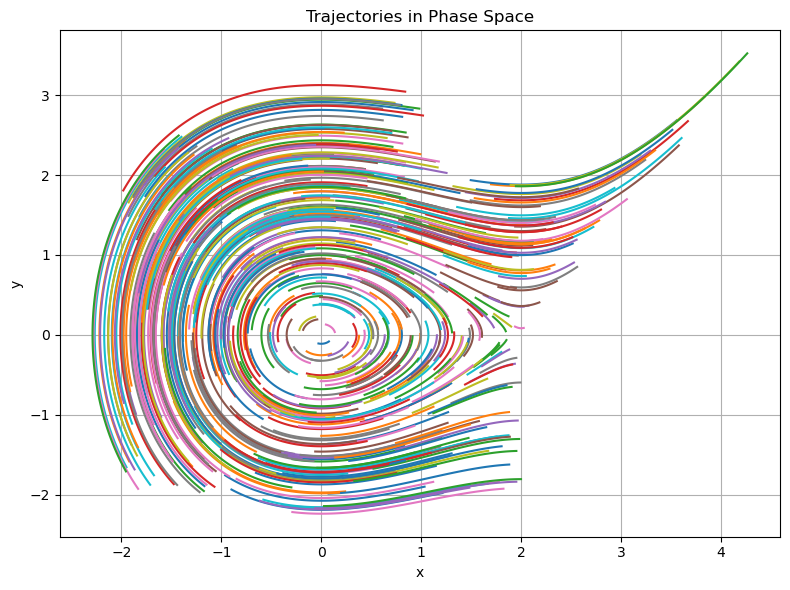

In [32]:
node.plot_trajectory_actual(node.train_data)

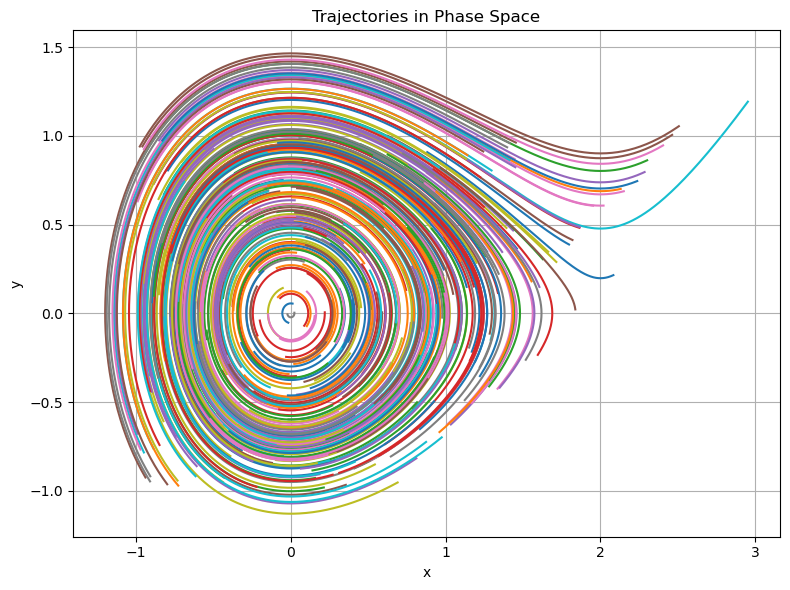

In [33]:
node.plot_trajectory_actual(node.test_data)

### Train

In [34]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │    0.00015091328532435    │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │  0.00018432096112519503   │
└───────────────────────────┴───────────────────────────┘

### Output

Plotting phase space from sample 0


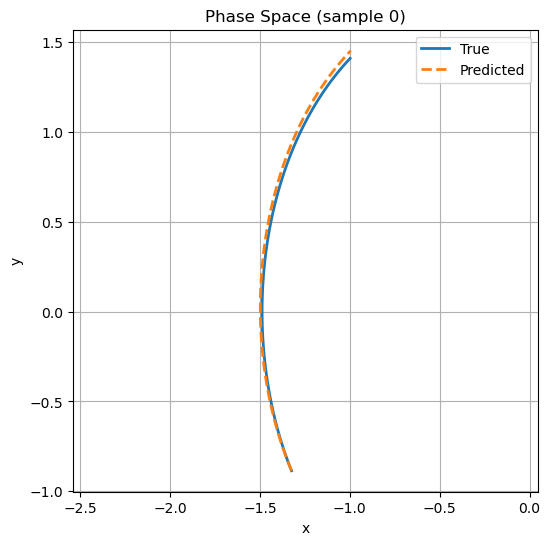

Plotting trajectory vs time from sample 0


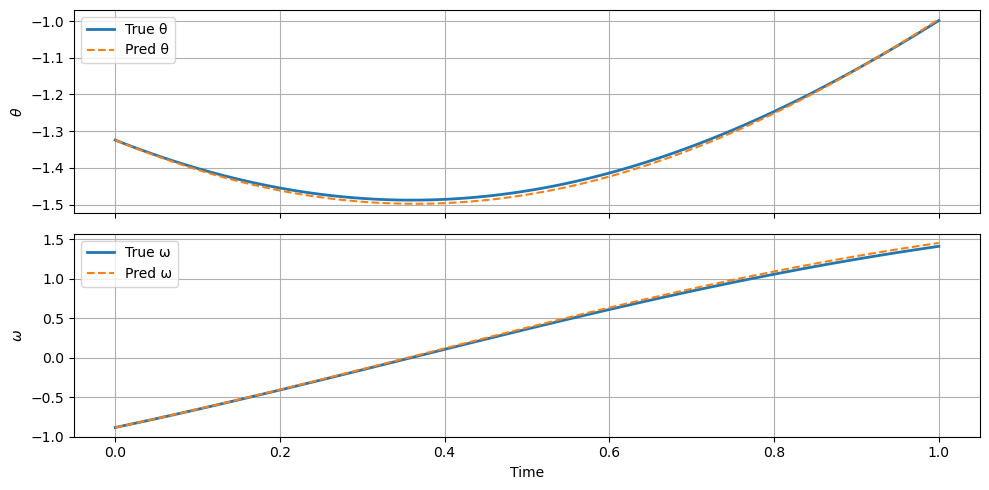

Plotting learned vector field


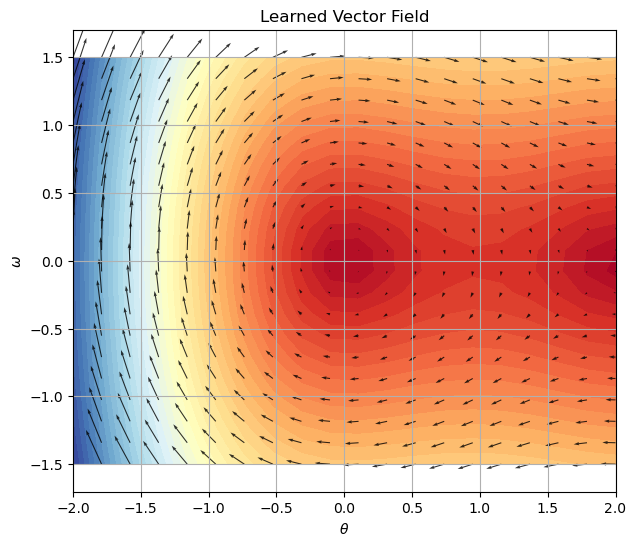

Plotting fixed points
Found 2 fixed point(s):
Fixed point 1: [0.0097 0.0001]
  Eigenvalues: [0.+1.j 0.-1.j]
  Stability: Center (neutrally stable)
Fixed point 2: [ 1.9805 -0.0237]
  Eigenvalues: [ 1. -1.]
  Stability: Saddle point (unstable)


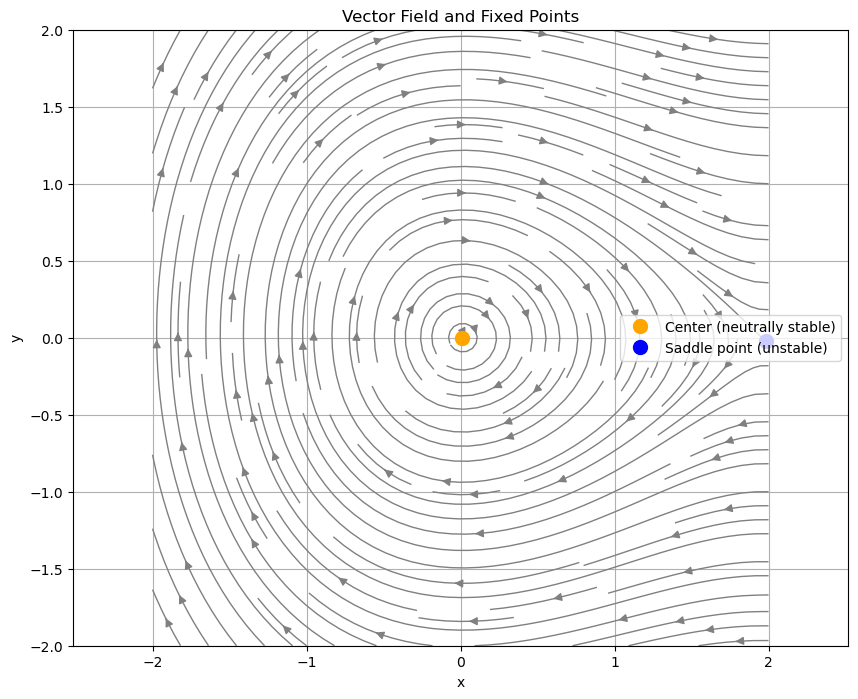

Plotting phase space for all samples for train data


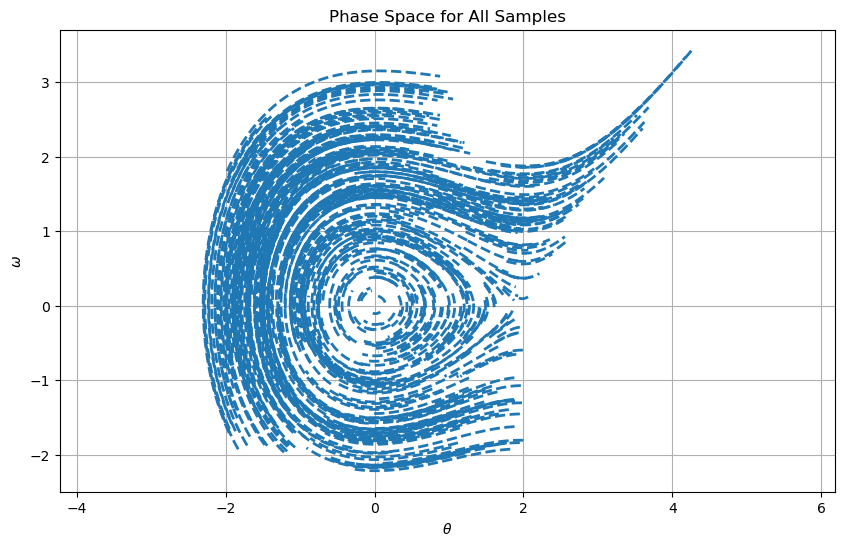

Plotting phase space for all samples for test data


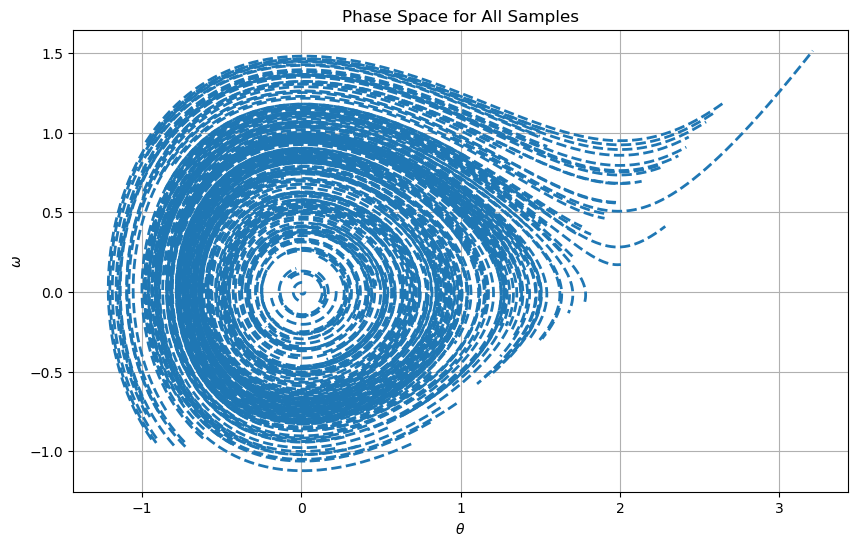

Time taken to train in seconds:  2514.1934113502502
MSE: 0.0008433898756751053
MAE: 0.020255436827428638
Chamfer: 0.0014305700625724665
Hausdorff: 0.06849288938433705


In [35]:
outputs(node=node, theta_range=(-2, 2), omega_range=(-1.5, 1.5), density=20, visualize=True,bounds=(-2, 2))

### SINDy

In [36]:
# Extract trajectories and time arrays for PySINDy
trajectories = []
time_arrays = []

for i, (x0, t, traj) in enumerate(node.train_data):
    trajectories.append(traj)
    time_arrays.append(t)

model = ps.SINDy(
    feature_library=ps.PolynomialLibrary(degree=2),
    optimizer=ps.STLSQ(threshold=0.02, alpha=0.01, max_iter=20),
    feature_names=['x', 'y'],
    differentiation_method=ps.FiniteDifference(order=2)
)

start_time = time.time()
model.fit(trajectories, t=time_arrays, multiple_trajectories=True)
end_time = time.time()

print("\nDiscovered equations:")
print("=" * 50)
model.print()
print("=" * 50)


Discovered equations:
(x)' = 1.000 y
(y)' = -1.000 x + 0.500 x^2


In [37]:
sindy_data = node.generate_sindy_points(model)
errors = node.evaluate_errors_sindy(real_dataset=node.Dataset(node.test_data), sindy_dataset=node.Dataset(sindy_data))

print(f"Time taken to train in seconds: {end_time - start_time:.2f}")
print("MSE:", errors['mse'])
print("MAE:", errors['mae'])
print("Chamfer:", errors['chamfer'])
print("Hausdorff:", errors['hausdorff'])

Time taken to train in seconds: 0.16
MSE: 8.939244157112984e-10
MAE: 2.0648149080481442e-05
Chamfer: 3.575697683309148e-09
Hausdorff: 6.642036450160524e-05


## Van der Pol Equation - Studying Bifurcations

Here we vary $\mu$ from -3 to 3 and observe the change in the nature of the fixed points to find where the hopf bifurcation(change in nature) occurs

### Van der Pol Equation ($\mu = 3$)

#### Input

In [38]:
mu = 3
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, mu*(1-x**2)*y - x])
train_parameters = [500,0.1,0.1,2,2,None]
test_parameters = [200,1,0.1,2,2,None]

In [39]:
node = NODE(equations,train_parameters,test_parameters)

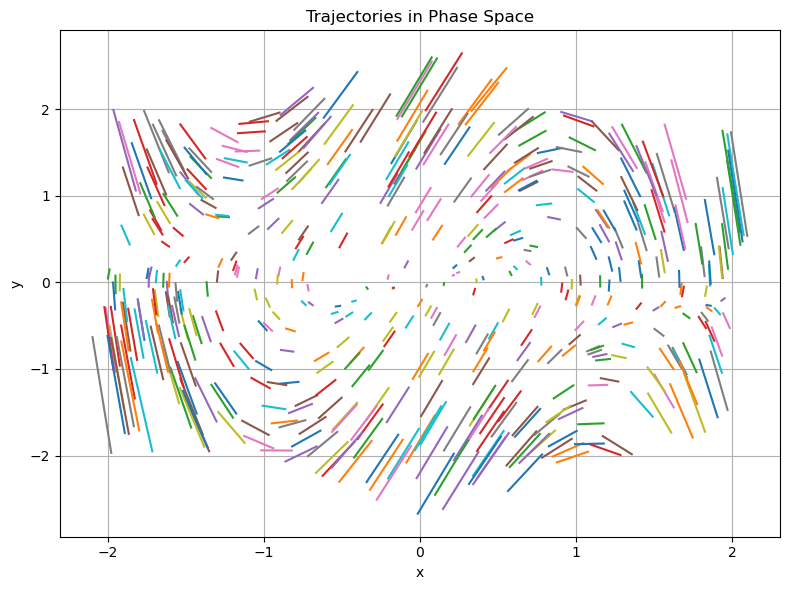

In [40]:
node.plot_trajectory_actual(node.train_data)

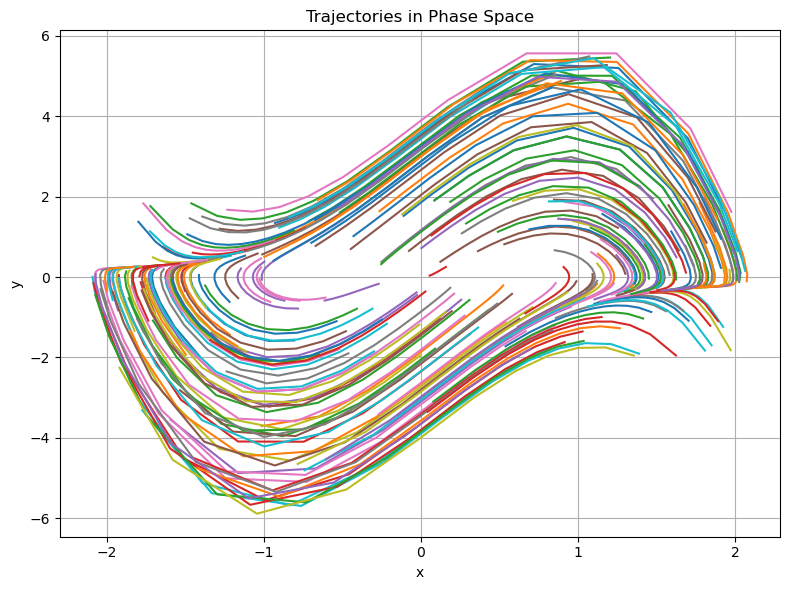

In [41]:
node.plot_trajectory_actual(node.test_data)

#### Train

In [42]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │  3.7436561797221657e-06   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │  4.7647808969486505e-06   │
└───────────────────────────┴───────────────────────────┘

#### Output

Plotting phase space from sample 0


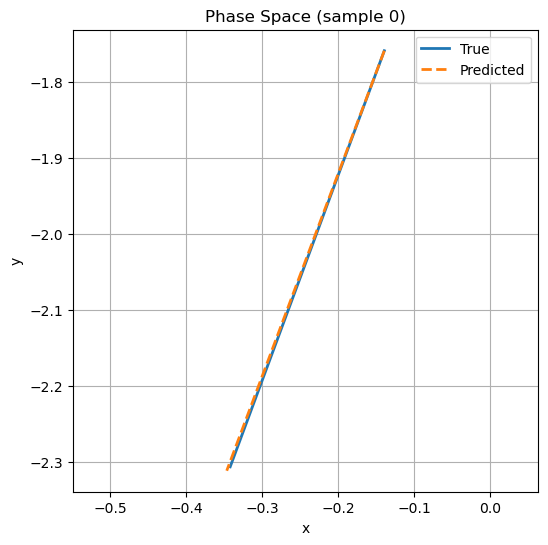

Plotting trajectory vs time from sample 0


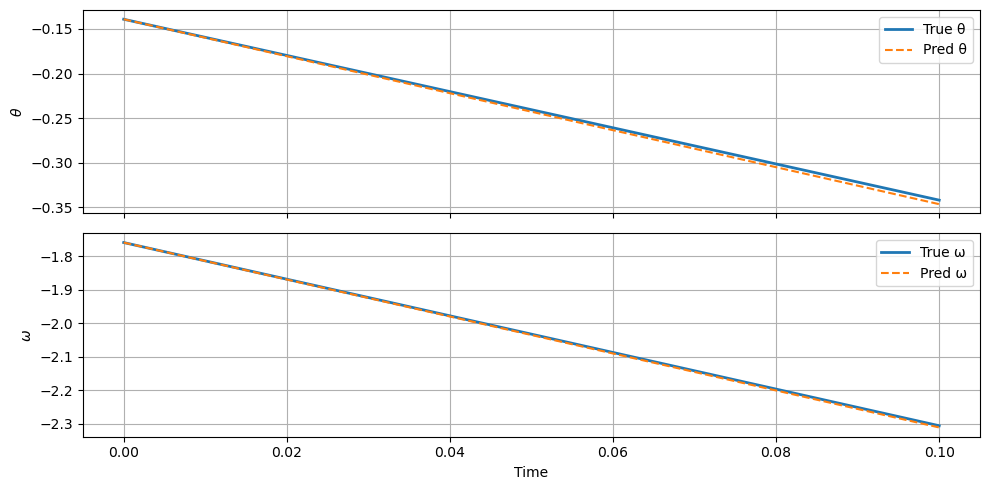

Plotting learned vector field


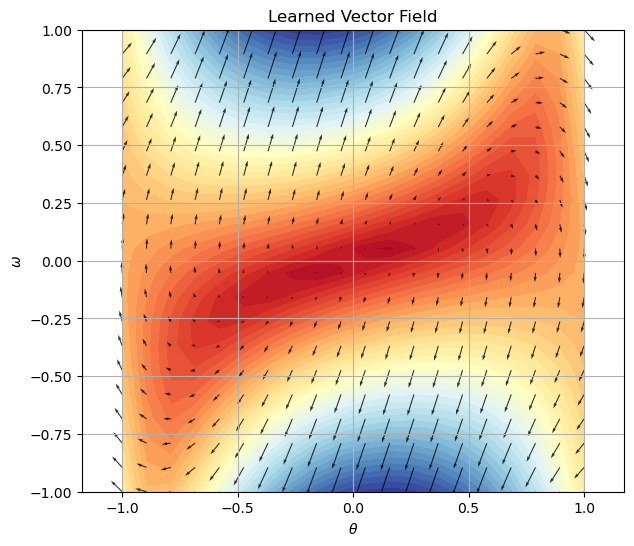

Plotting fixed points
Found 1 fixed point(s):
Fixed point 1: [0.0072 0.0097]
  Eigenvalues: [0.4 2.6]
  Stability: Unstable node


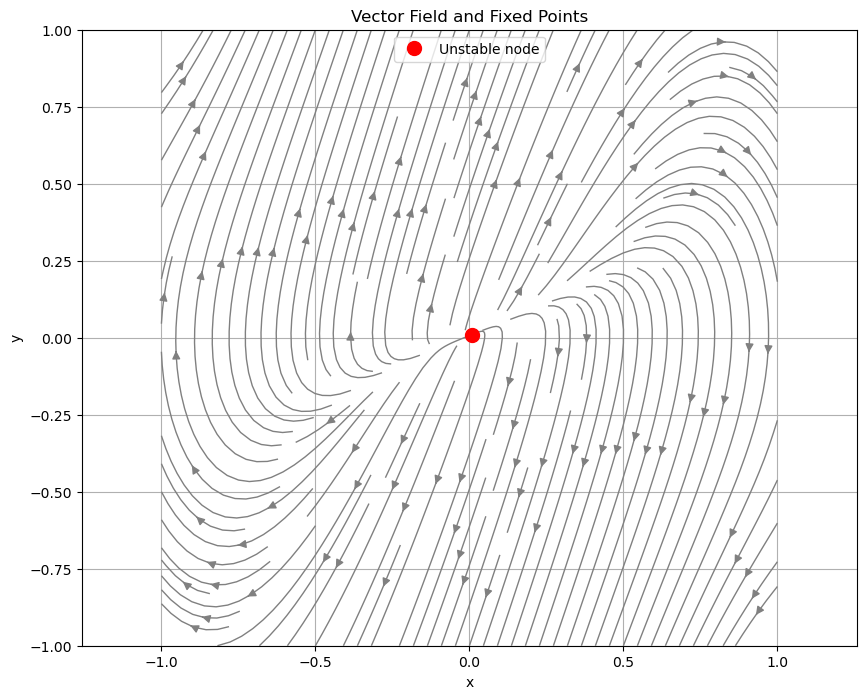

Plotting phase space for all samples for train data


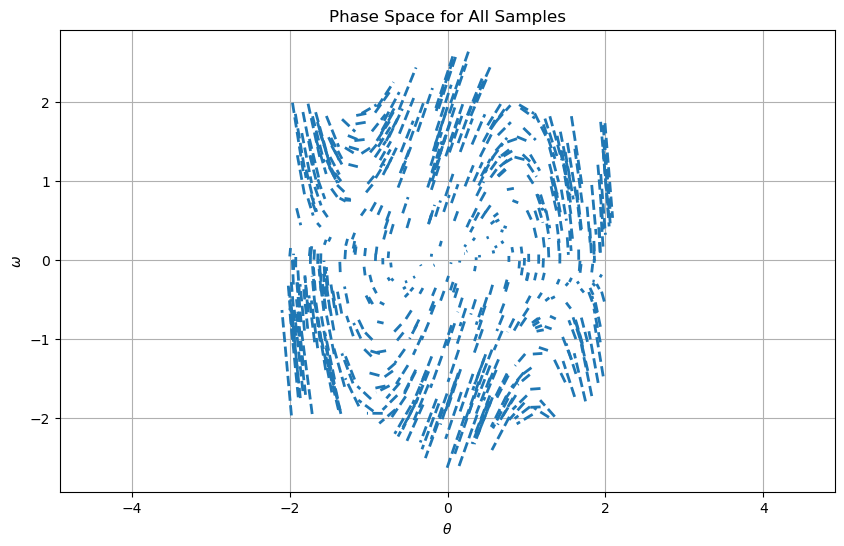

Plotting phase space for all samples for test data


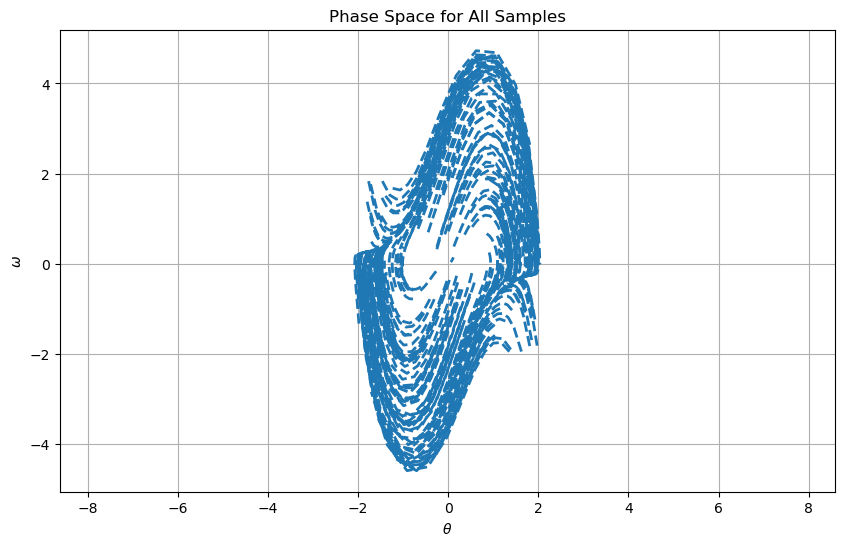

Time taken to train in seconds:  87.72744655609131
MSE: 0.015478757286998643
MAE: 0.039264741226215844
Chamfer: 0.052034640817209946
Hausdorff: 0.2232702657502884


In [43]:
outputs(node=node, theta_range=(-1, 1), omega_range=(-1, 1), density=20, visualize=True,bounds=(-1, 1))

### Van der Pol Equation ($\mu = 1$)

#### Input

In [44]:
mu = 1
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, mu*(1-x**2)*y - x])

train_parameters = [500,0.1,0.1,2,2,None]
test_parameters = [200,2,0.1,2,2,None]

In [45]:
node = NODE(equations,train_parameters,test_parameters)

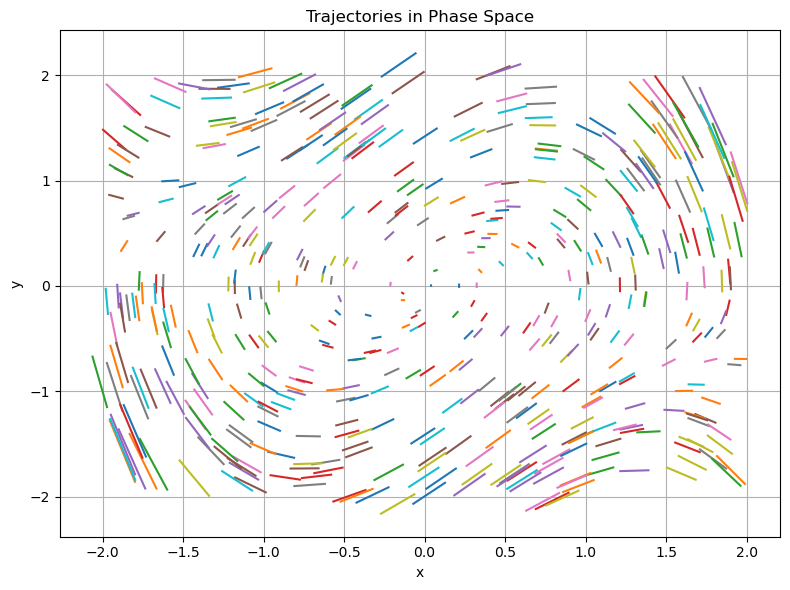

In [46]:
node.plot_trajectory_actual(node.train_data)

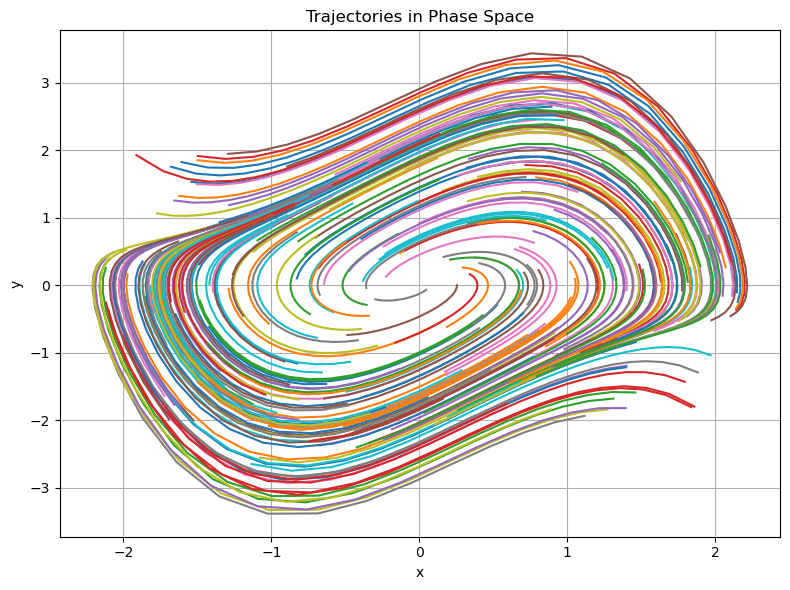

In [47]:
node.plot_trajectory_actual(node.test_data)

#### Train

In [48]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │  2.5602314508432755e-06   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   2.447265160299139e-06   │
└───────────────────────────┴───────────────────────────┘

#### Output

Plotting phase space from sample 0


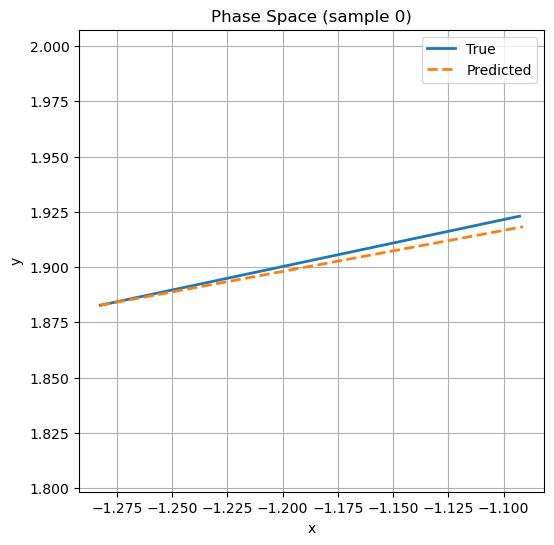

Plotting trajectory vs time from sample 0


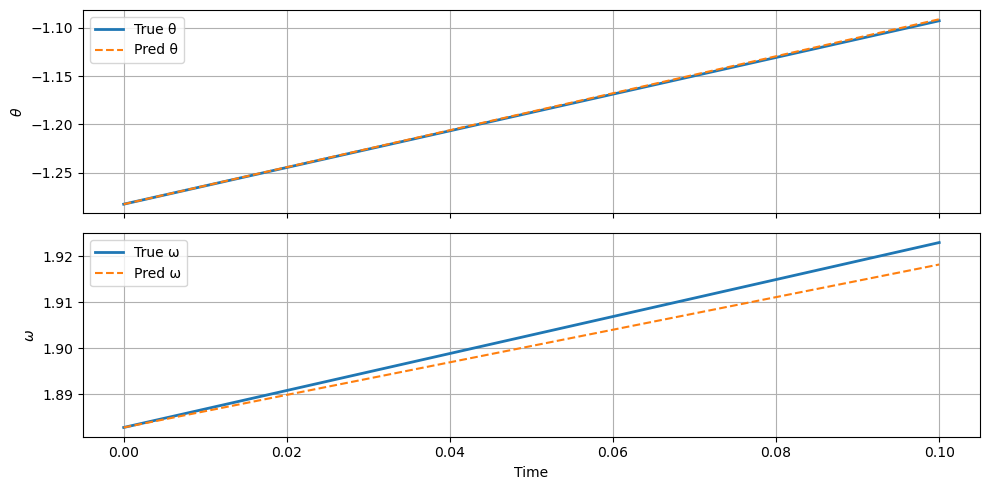

Plotting learned vector field


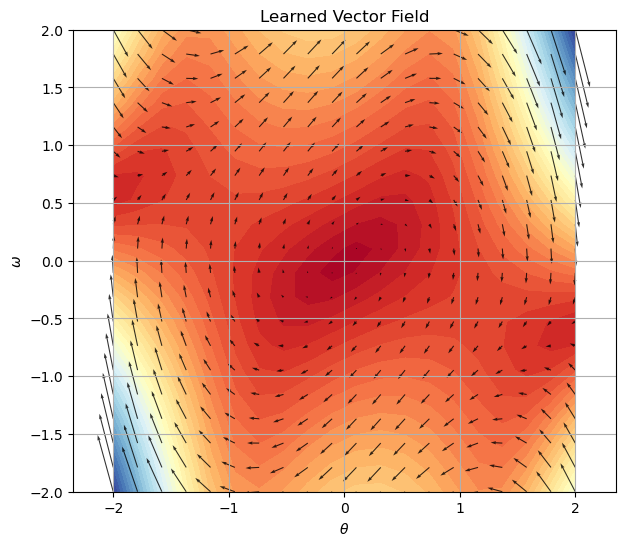

Plotting fixed points
Found 1 fixed point(s):
Fixed point 1: [ 0.0149 -0.0061]
  Eigenvalues: [0.5+0.9j 0.5-0.9j]
  Stability: Unstable focus (spiral source)


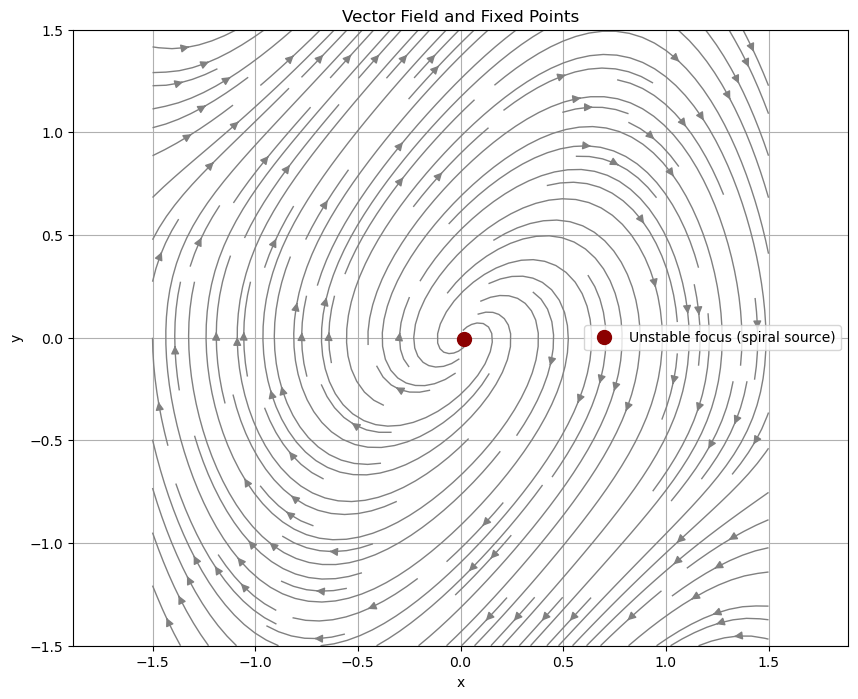

Plotting phase space for all samples for train data


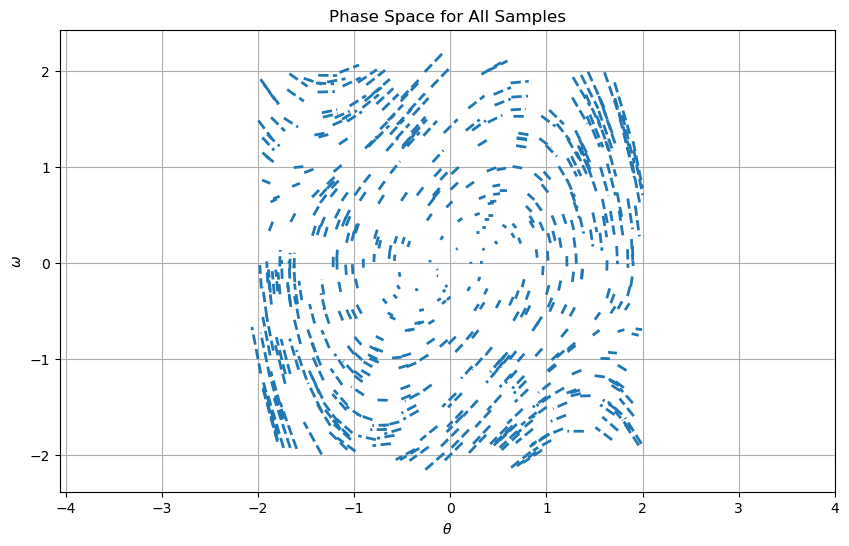

Plotting phase space for all samples for test data


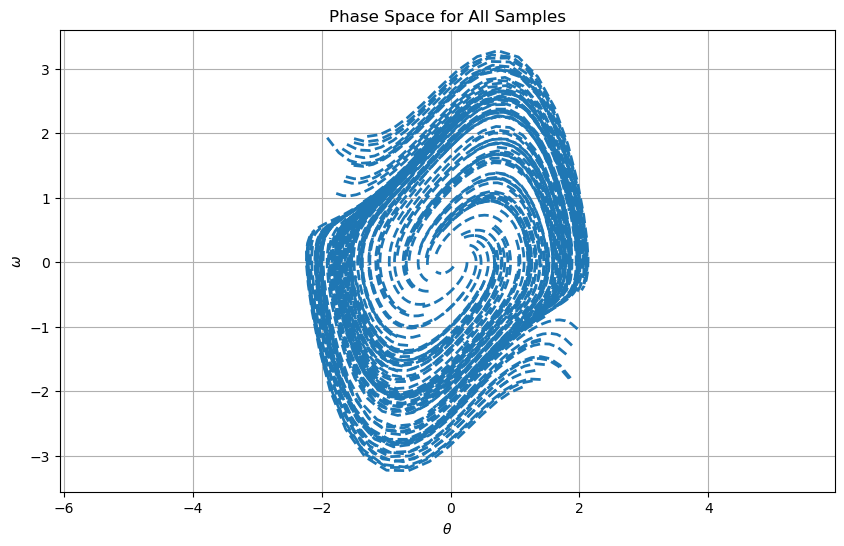

Time taken to train in seconds:  86.48908042907715
MSE: 0.000884420839397535
MAE: 0.018786030603805556
Chamfer: 0.003419105191478593
Hausdorff: 0.07065286132272026


In [49]:
outputs(node=node, theta_range=(-2, 2), omega_range=(-2, 2), density=20, visualize=True,bounds=(-1.5, 1.5))

### Van der Pol Equation ($\mu = 0.1$)

#### Input

In [50]:
mu = 0.1
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, mu*(1-x**2)*y - x])
train_parameters = [500,1,0.01,5,5,None]
test_parameters = [200,10,0.01,5,5,None]

In [51]:
node = NODE(equations,train_parameters,test_parameters)

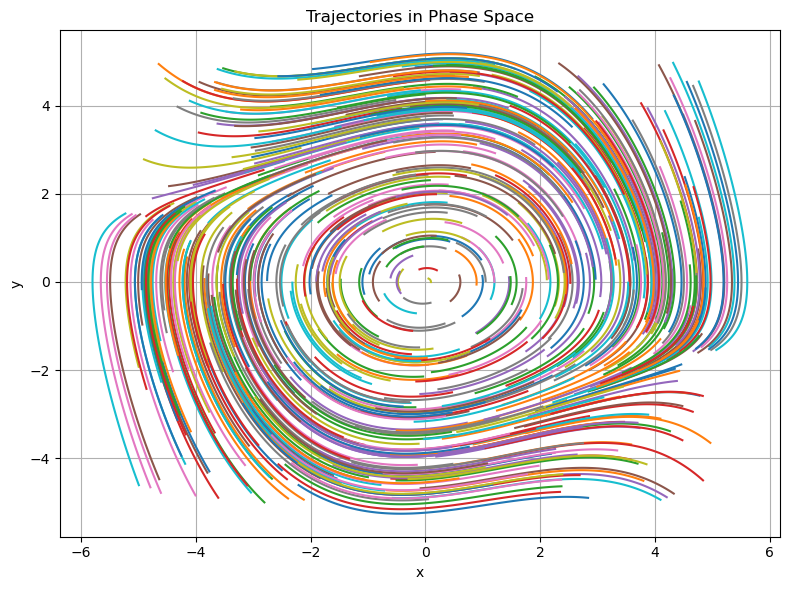

In [52]:
node.plot_trajectory_actual(node.train_data)

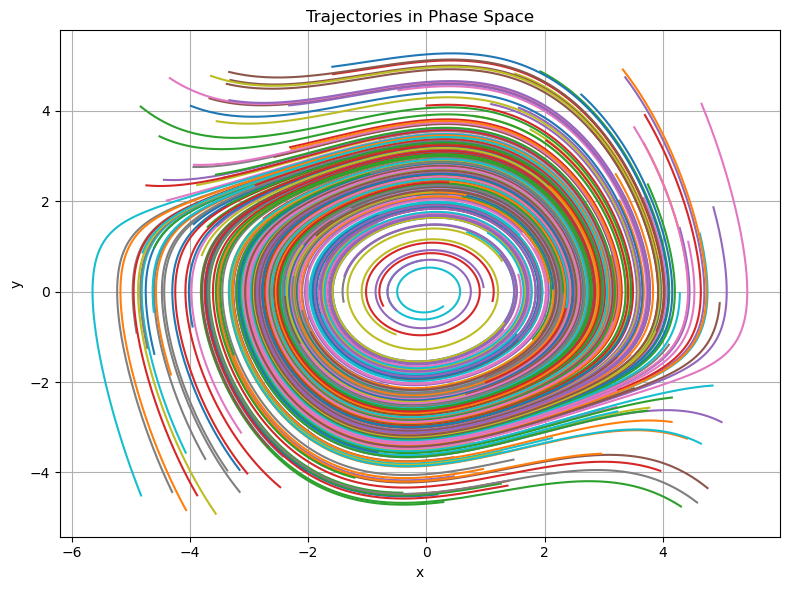

In [53]:
node.plot_trajectory_actual(node.test_data)

#### Train

In [54]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │  0.00048399082152172923   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   0.0005931167397648096   │
└───────────────────────────┴───────────────────────────┘

#### Output

Plotting phase space from sample 0


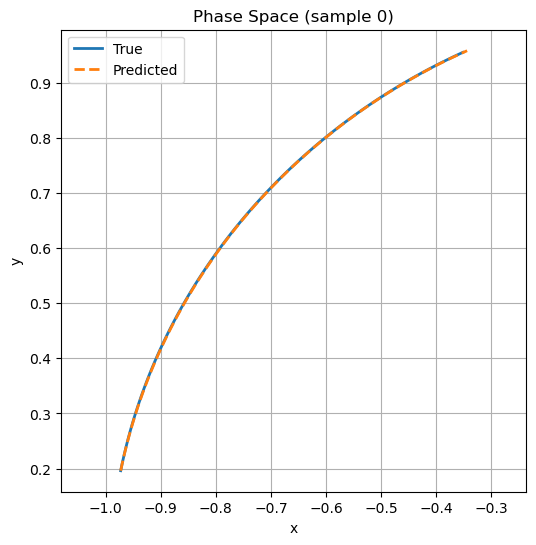

Plotting trajectory vs time from sample 0


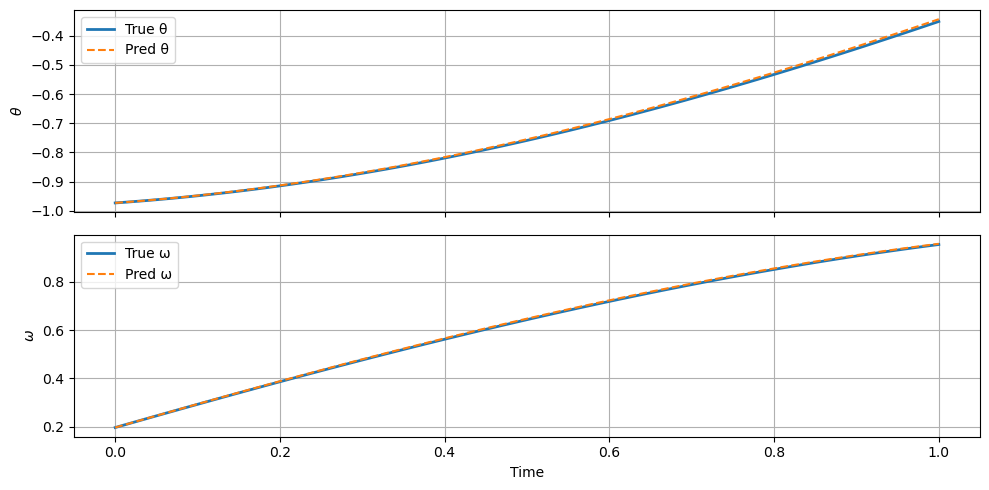

Plotting learned vector field


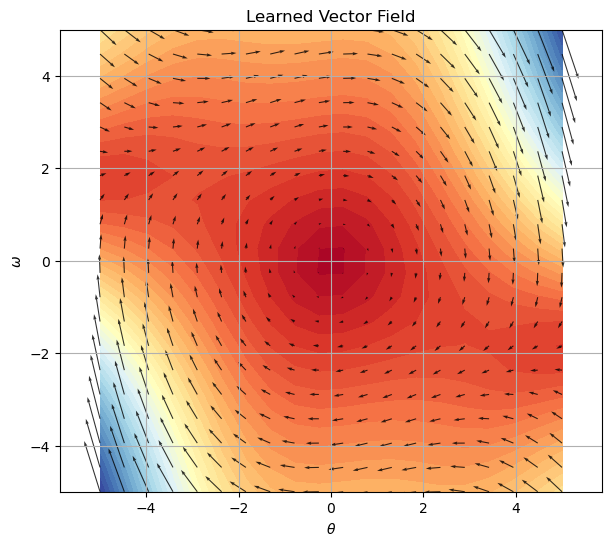

Plotting fixed points
Found 1 fixed point(s):
Fixed point 1: [ 0.0043 -0.0106]
  Eigenvalues: [0.1+1.j 0.1-1.j]
  Stability: Unstable focus (spiral source)


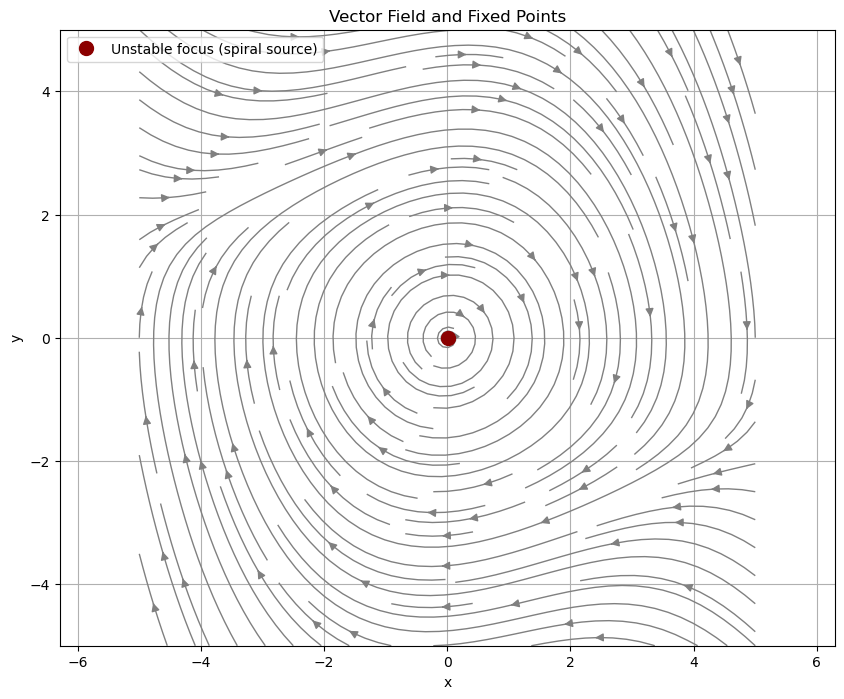

Plotting phase space for all samples for train data


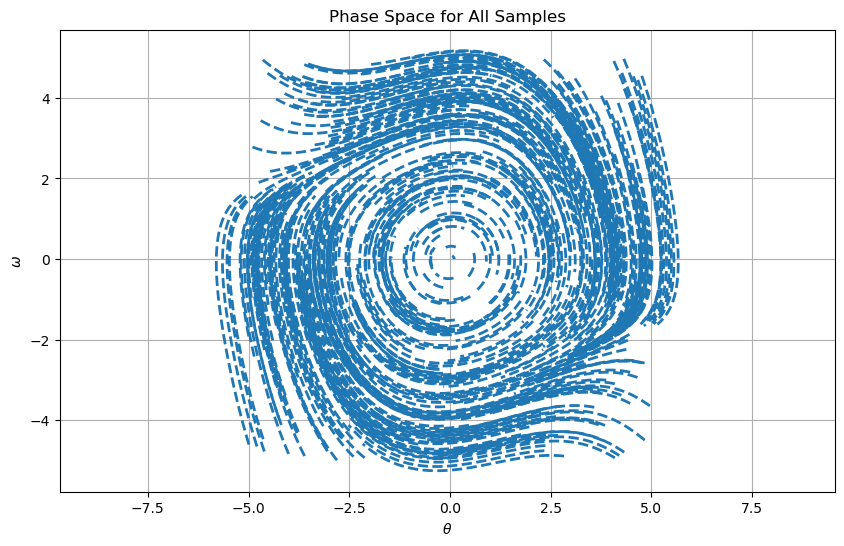

Plotting phase space for all samples for test data


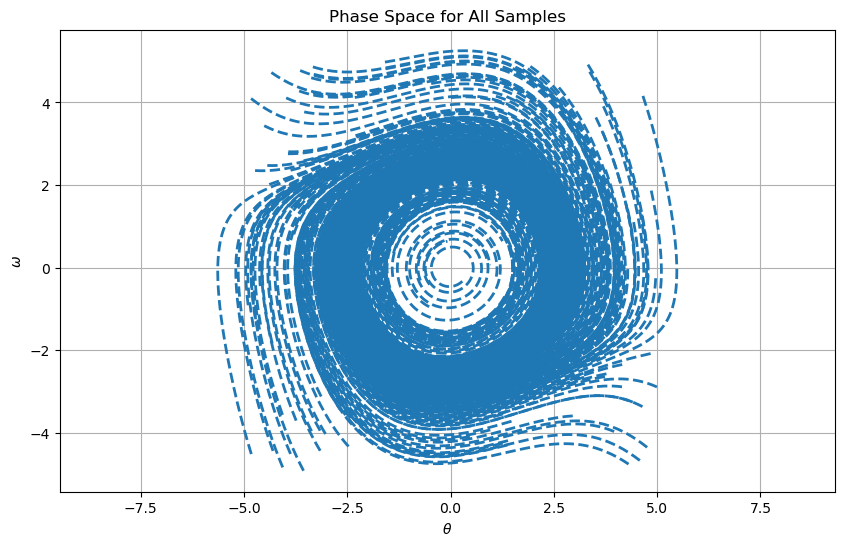

Time taken to train in seconds:  2214.4088237285614
MSE: 0.0016779741743812337
MAE: 0.031358230579644444
Chamfer: 0.0022679214720847086
Hausdorff: 0.07068516863940792


In [55]:
outputs(node=node, theta_range=(-5, 5), omega_range=(-5, 5), density=20, visualize=True,bounds=(-5, 5))

### Van der Pol Equation ($\mu = 0$)

#### Input

In [56]:
mu = 0
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, mu*(1-x**2)*y - x])
train_parameters = [500,1,0.01,0.025,0.025,None]
test_parameters = [200,10,0.01,0.025,0.025,None]

In [57]:
node = NODE(equations,train_parameters,test_parameters)

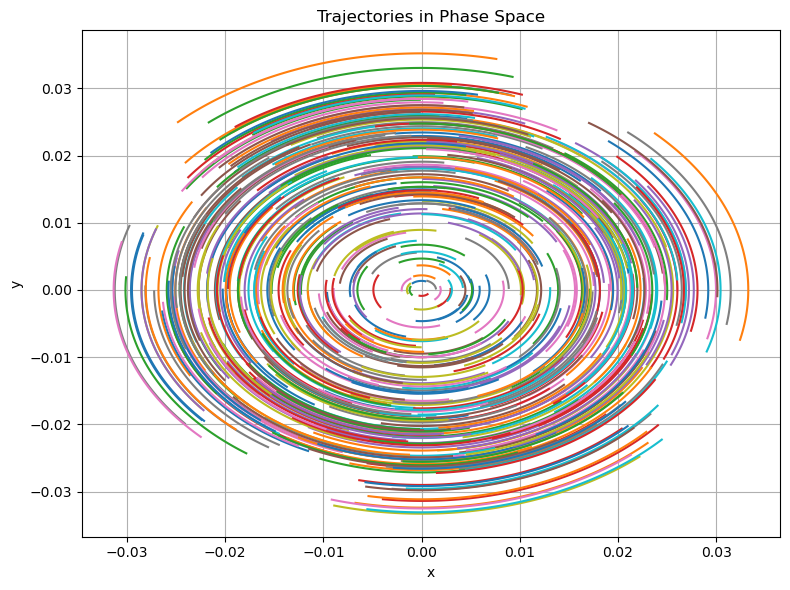

In [58]:
node.plot_trajectory_actual(node.train_data)

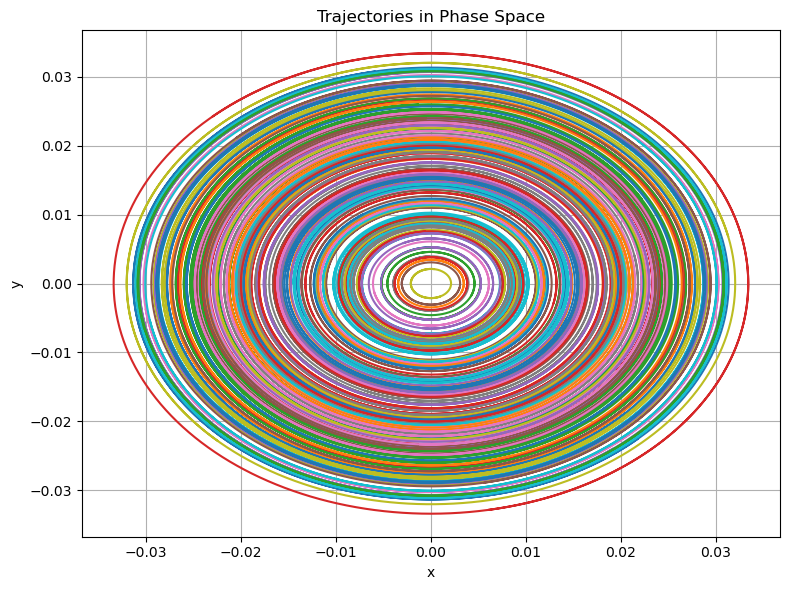

In [59]:
node.plot_trajectory_actual(node.test_data)

#### Train

In [60]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │  1.7128764184803913e-08   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │  2.0827142677148913e-08   │
└───────────────────────────┴───────────────────────────┘

#### Output

Plotting phase space from sample 0


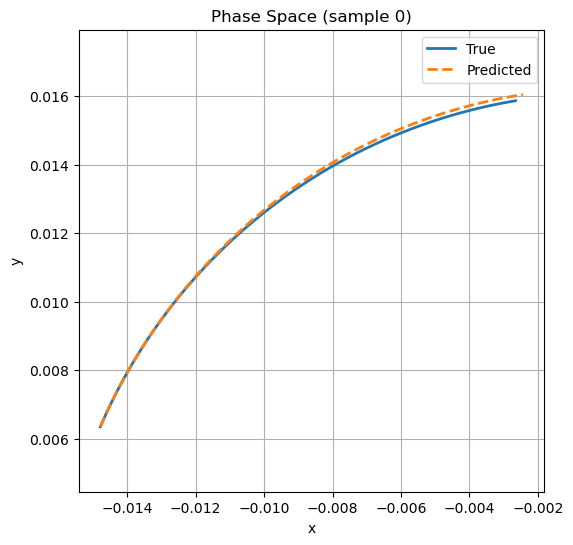

Plotting trajectory vs time from sample 0


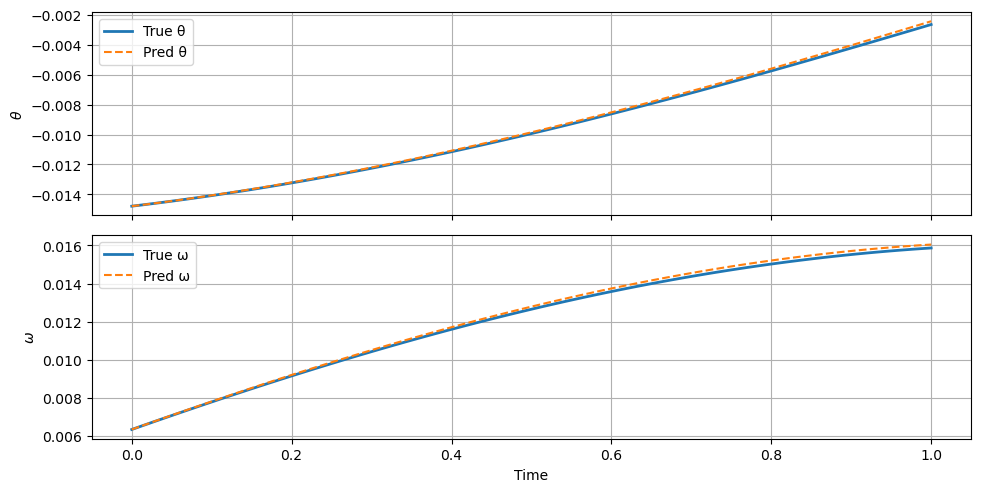

Plotting learned vector field


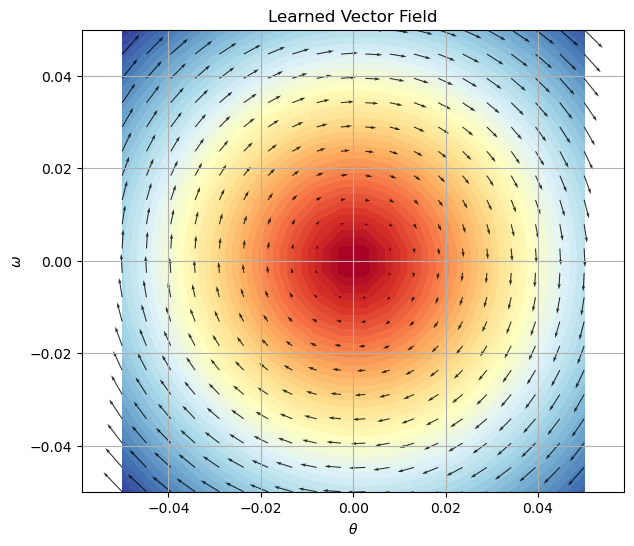

Plotting fixed points
Found 1 fixed point(s):
Fixed point 1: [ 0.0001 -0.0001]
  Eigenvalues: [-0.+1.j -0.-1.j]
  Stability: Center (neutrally stable)


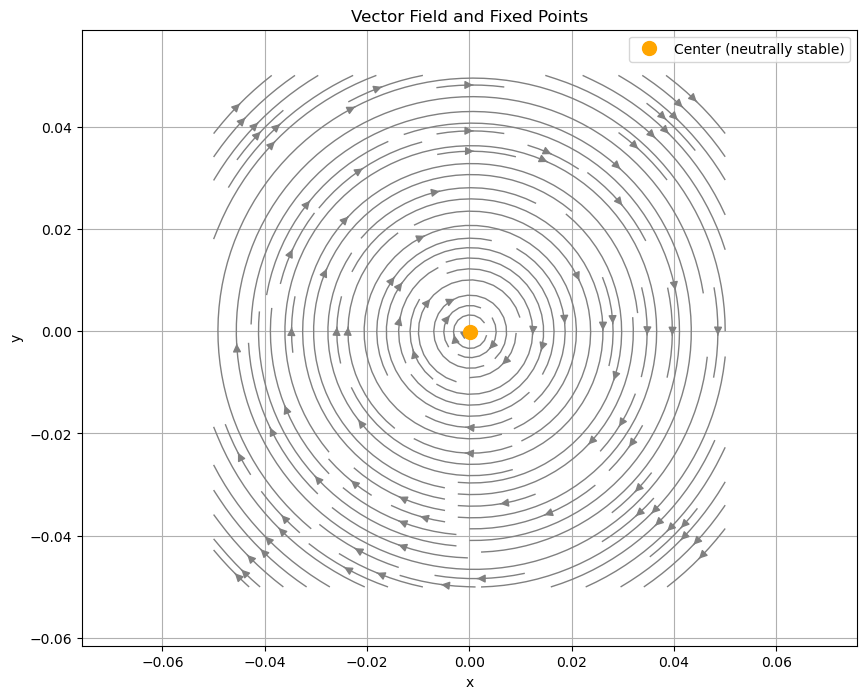

Plotting phase space for all samples for train data


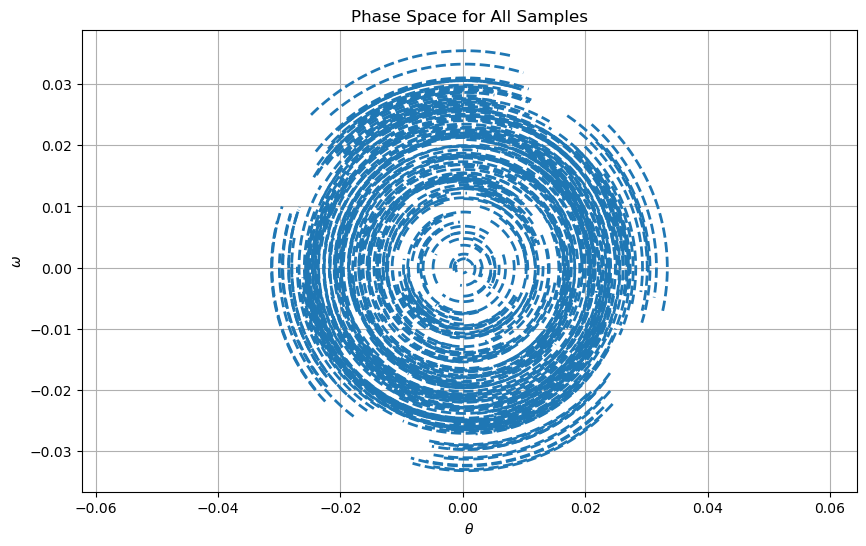

Plotting phase space for all samples for test data


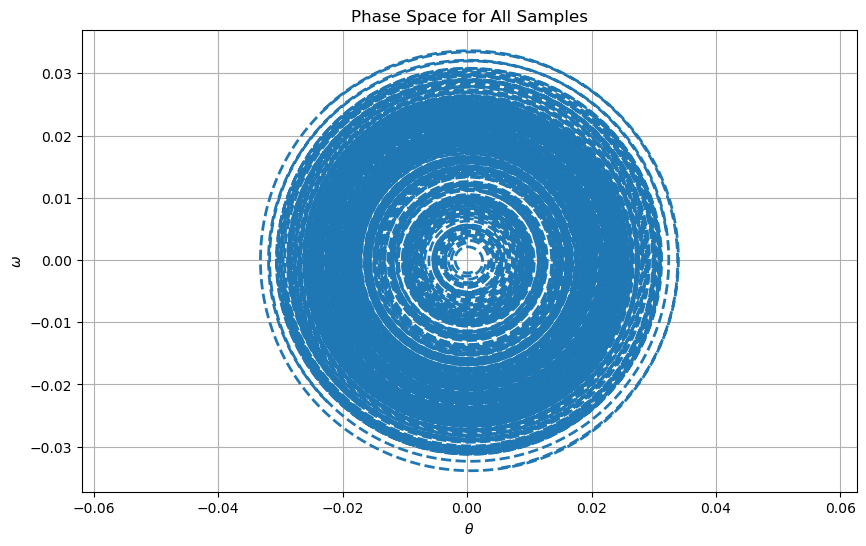

Time taken to train in seconds:  2176.198756456375
MSE: 2.5850431669027783e-07
MAE: 0.00038929126152652314
Chamfer: 1.627424401906552e-07
Hausdorff: 0.0005170099959839275


In [61]:
outputs(node=node, theta_range=(-0.05, 0.05), omega_range=(-0.05, 0.05), density=20, visualize=True,bounds=(-0.05, 0.05))

### Van der Pol Equation ($\mu = -0.1$)

#### Input

In [62]:
mu = -0.1
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, mu*(1-x**2)*y - x])
train_parameters = [500,1,0.01,1,1,None]
test_parameters = [200,10,0.01,1,1,None]

In [63]:
node = NODE(equations,train_parameters,test_parameters)

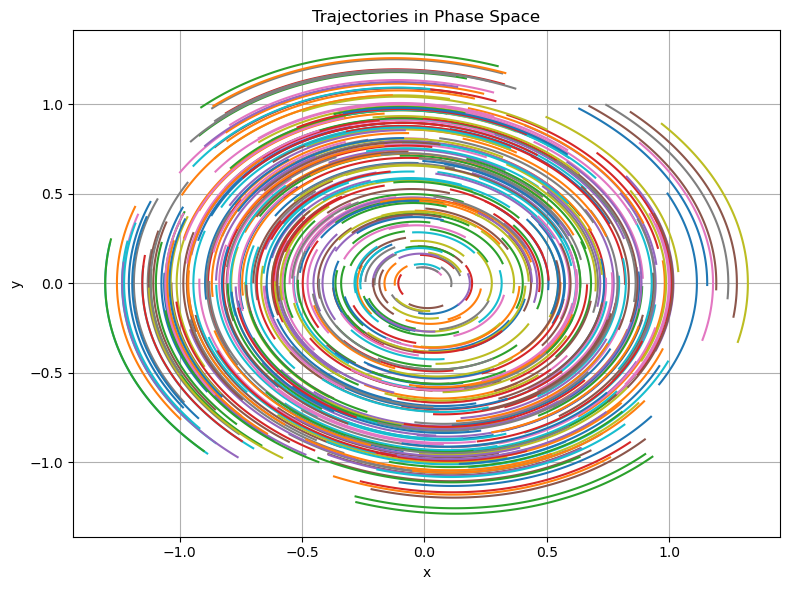

In [64]:
node.plot_trajectory_actual(node.train_data)

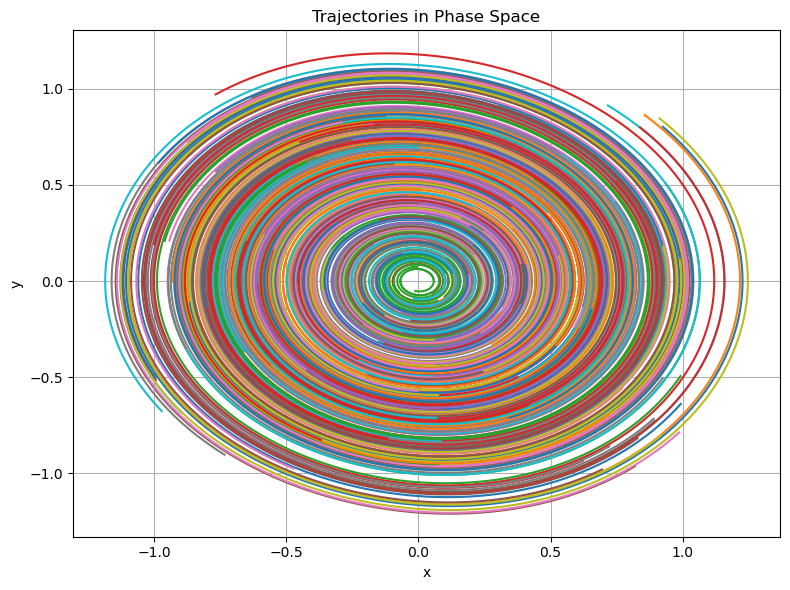

In [65]:
node.plot_trajectory_actual(node.test_data)

#### Train

In [66]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │  2.6291150788892992e-05   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │  2.8769694836228155e-05   │
└───────────────────────────┴───────────────────────────┘

#### Output

Plotting phase space from sample 0


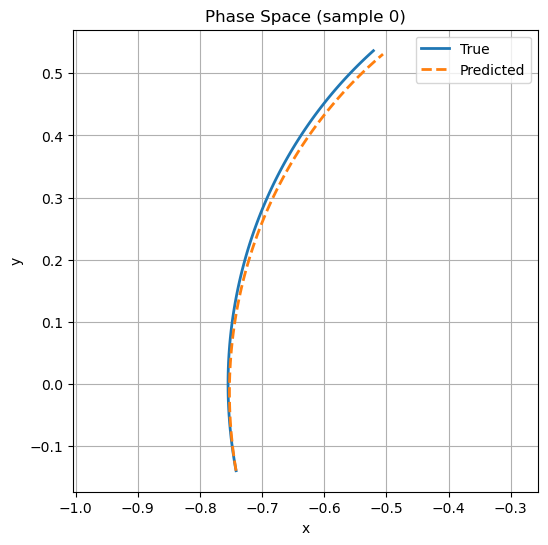

Plotting trajectory vs time from sample 0


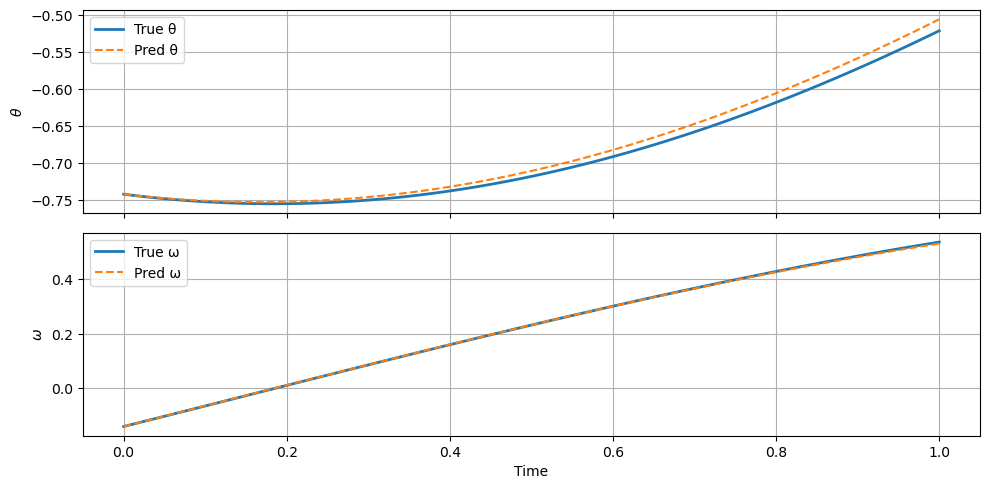

Plotting learned vector field


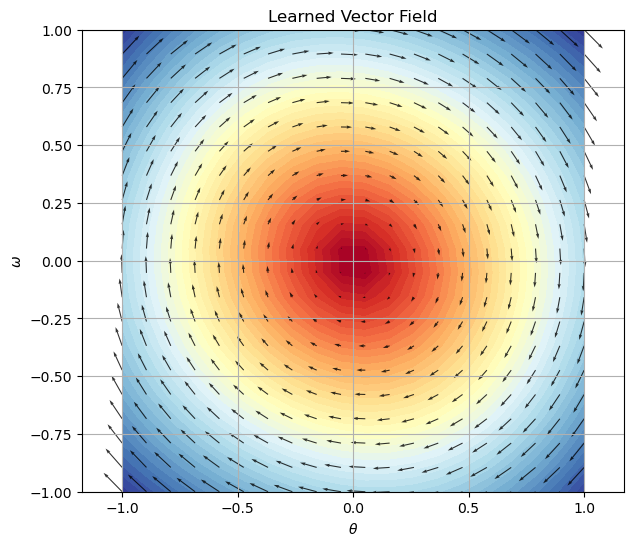

Plotting fixed points
Found 1 fixed point(s):
Fixed point 1: [ 0.0054 -0.0057]
  Eigenvalues: [-0.1+1.j -0.1-1.j]
  Stability: Stable focus (spiral sink)


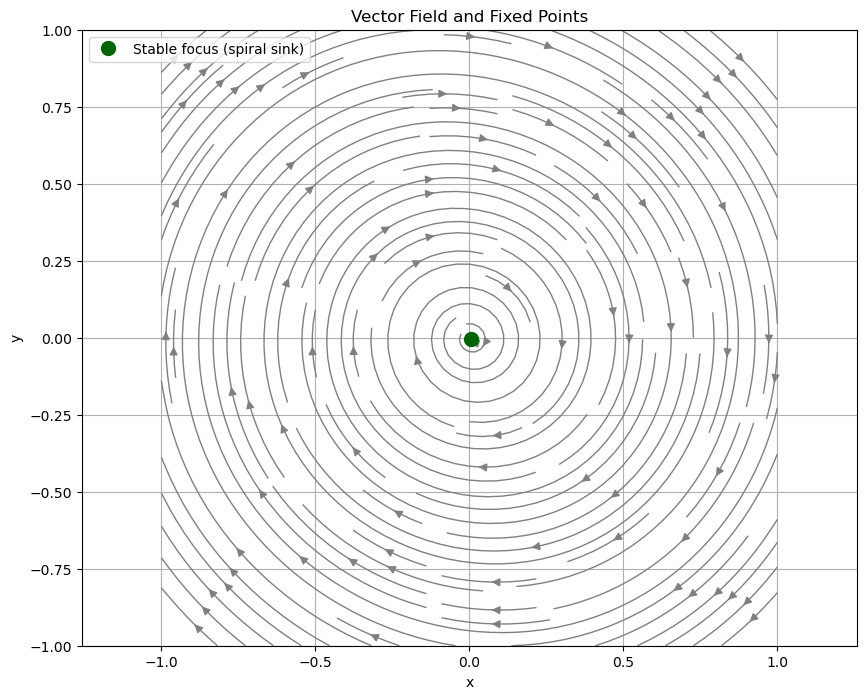

Plotting phase space for all samples for train data


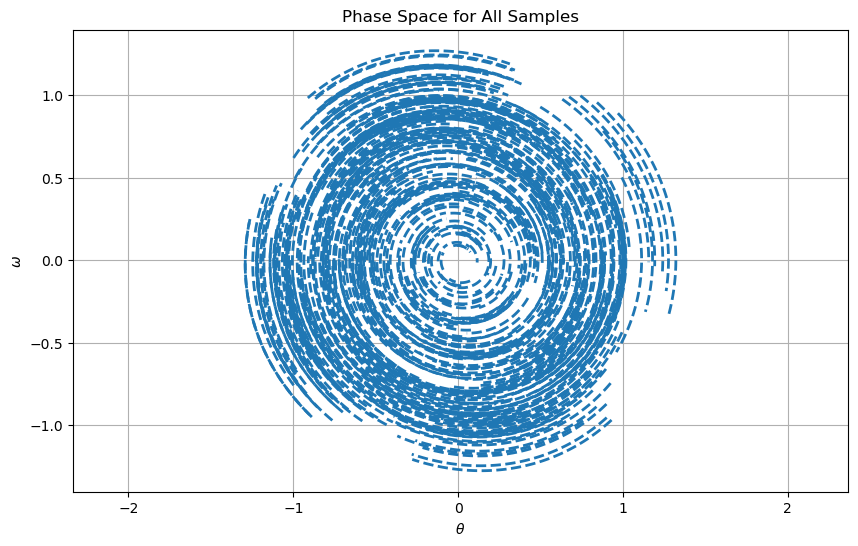

Plotting phase space for all samples for test data


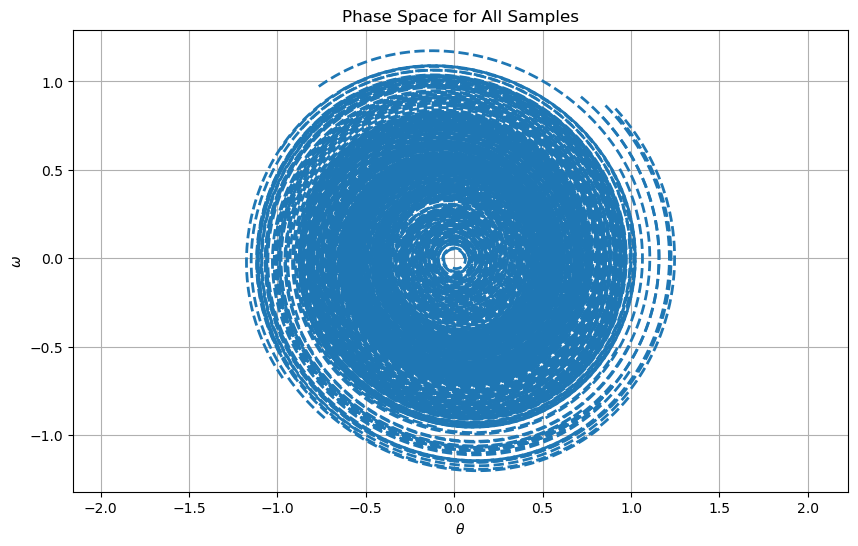

Time taken to train in seconds:  2127.1118886470795
MSE: 0.0008209670515316247
MAE: 0.0216335450229235
Chamfer: 0.002319195115160255
Hausdorff: 0.05657376684371803


In [67]:
outputs(node=node, theta_range=(-1, 1), omega_range=(-1, 1), density=20, visualize=True,bounds=(-1, 1))

### Van der Pol Equation ($\mu = -1$)

#### Input

In [68]:
mu = -1
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, mu*(1-x**2)*y - x])
train_parameters = [500,0.1,0.1,1,1,None]
test_parameters = [200,2,0.1,1,1,None]

In [69]:
node = NODE(equations,train_parameters,test_parameters)

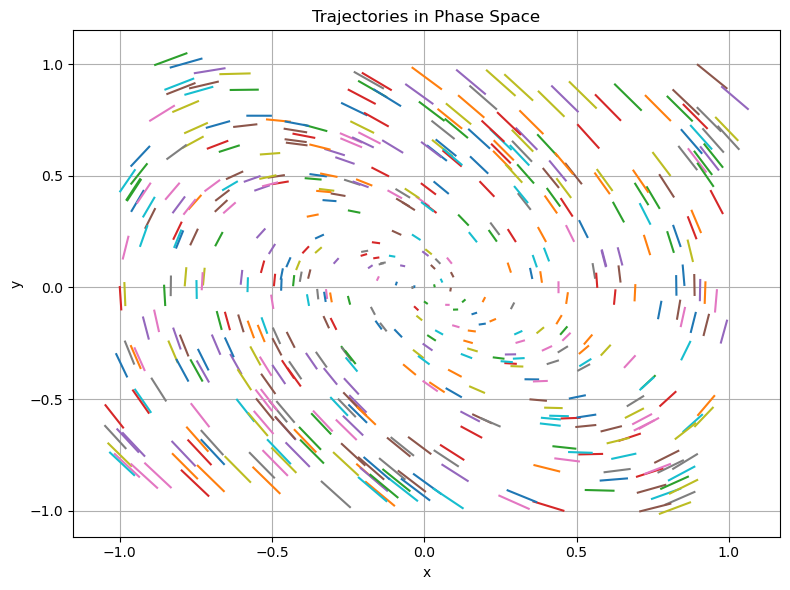

In [70]:
node.plot_trajectory_actual(node.train_data)

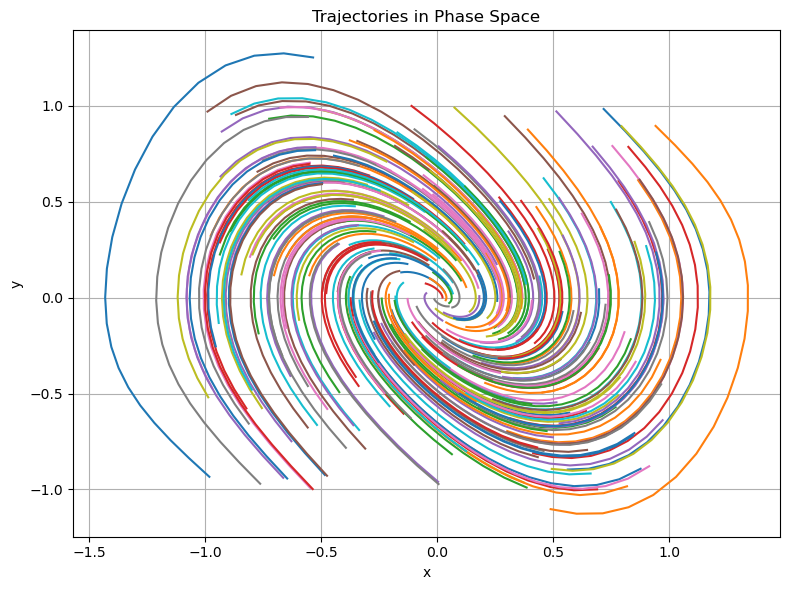

In [71]:
node.plot_trajectory_actual(node.test_data)

#### Train

In [72]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │   8.502431114720821e-07   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   5.322264655660547e-07   │
└───────────────────────────┴───────────────────────────┘

#### Output

Plotting phase space from sample 0


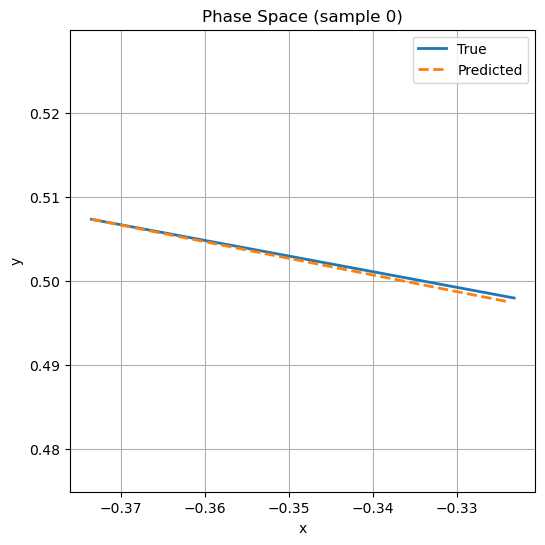

Plotting trajectory vs time from sample 0


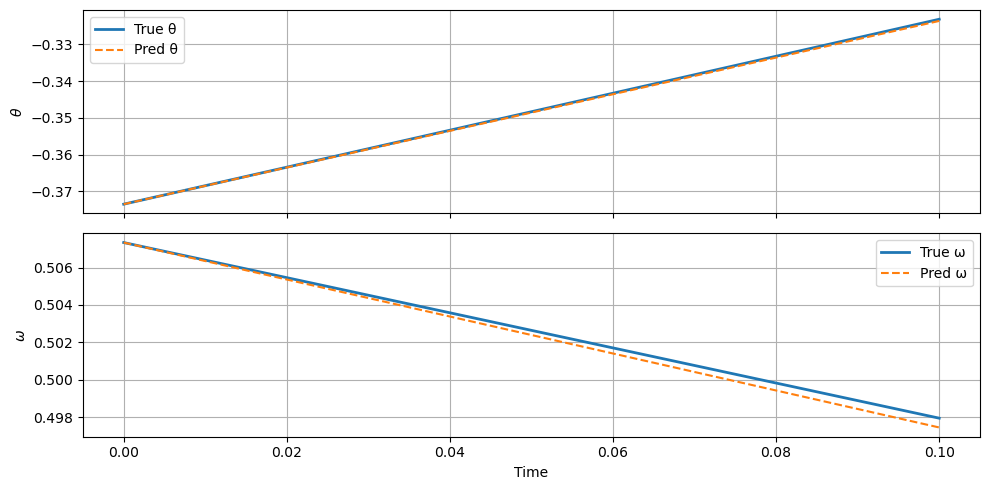

Plotting learned vector field


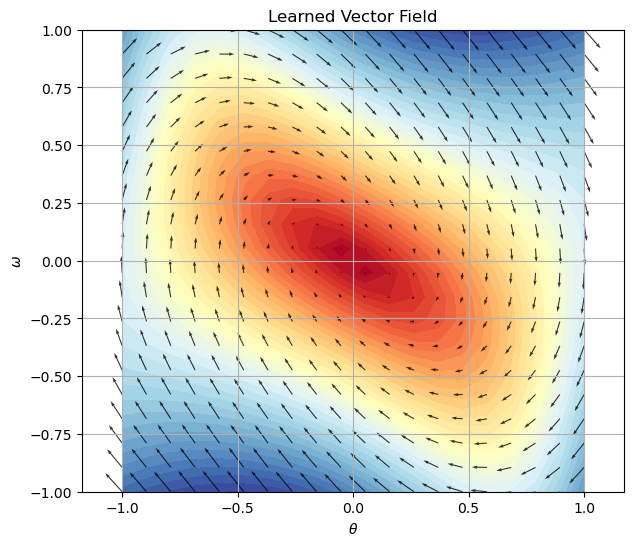

Plotting fixed points
Found 1 fixed point(s):
Fixed point 1: [-0.0019  0.0027]
  Eigenvalues: [-0.5+0.9j -0.5-0.9j]
  Stability: Stable focus (spiral sink)


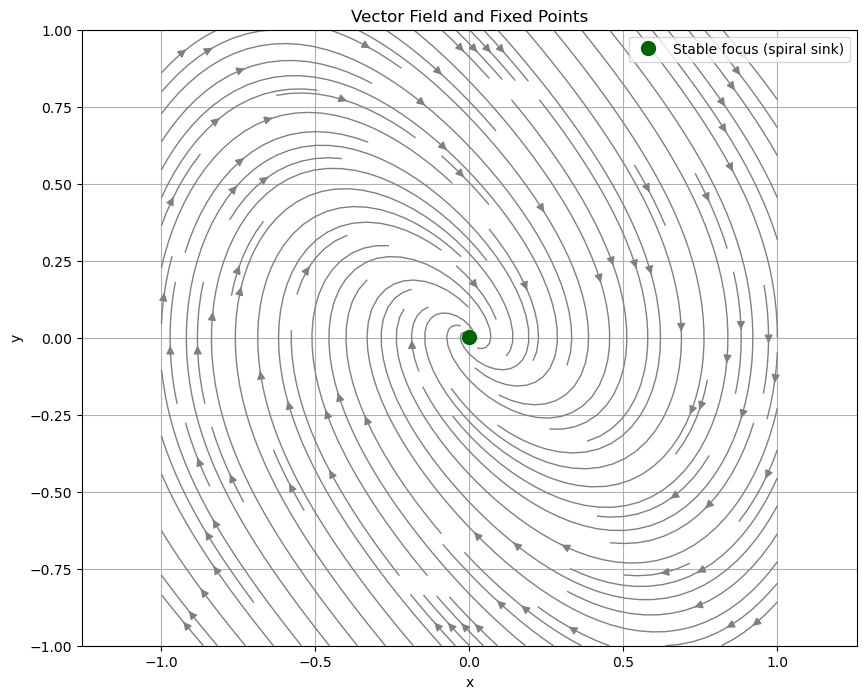

Plotting phase space for all samples for train data


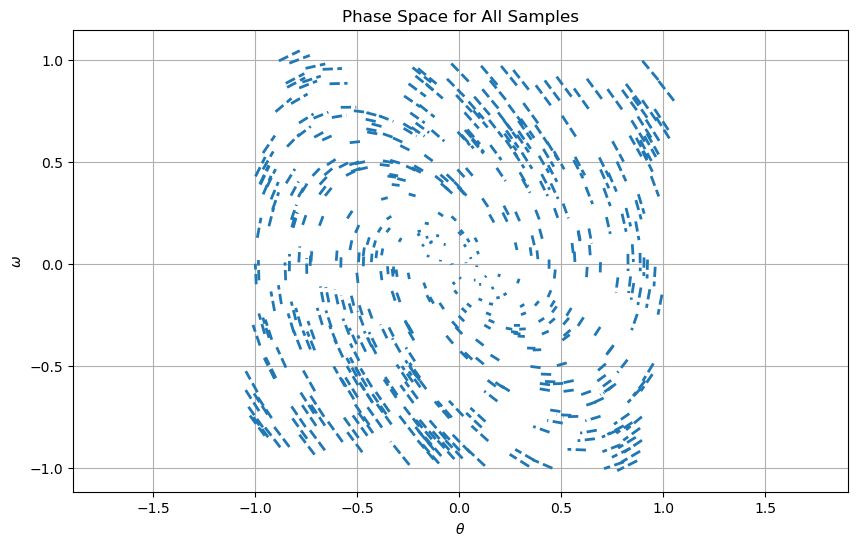

Plotting phase space for all samples for test data


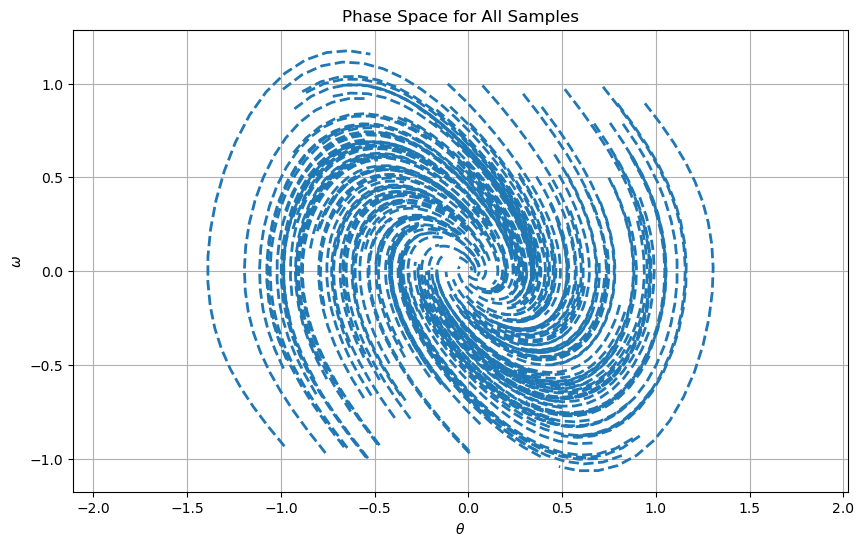

Time taken to train in seconds:  84.58090734481812
MSE: 5.703600650235785e-05
MAE: 0.0050114405946806075
Chamfer: 0.00022638239634829914
Hausdorff: 0.012103773792435935


In [73]:
outputs(node=node, theta_range=(-1, 1), omega_range=(-1, 1), density=20, visualize=True,bounds=(-1, 1))

### Van der Pol Equation ($\mu = -3$)

#### Input

In [74]:
mu = -3
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, mu*(1-x**2)*y - x])
train_parameters = [500,0.1,0.1,2,2,None]
test_parameters = [200,1,0.1,0.9,0.9,None]

In [75]:
node = NODE(equations,train_parameters,test_parameters)

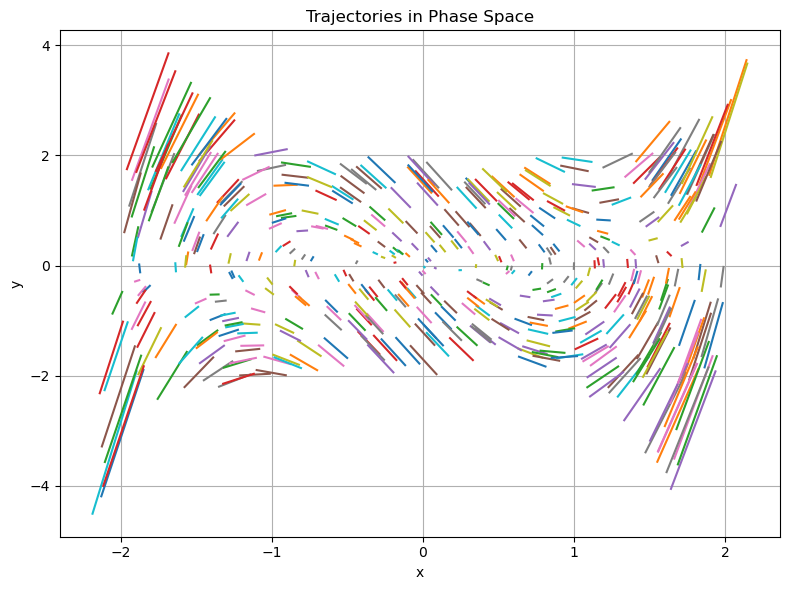

In [76]:
node.plot_trajectory_actual(node.train_data)

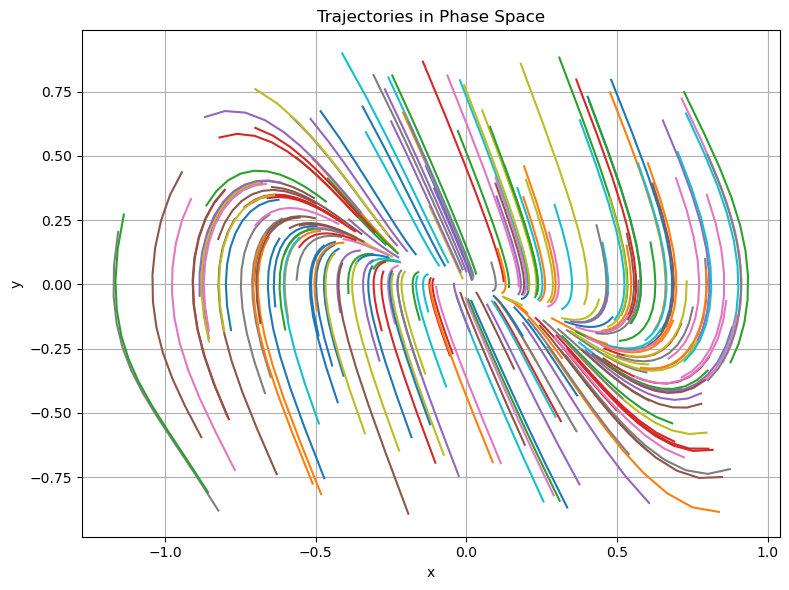

In [77]:
node.plot_trajectory_actual(node.test_data)

#### Train

In [78]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │   5.619931107503362e-05   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   8.564338349970058e-05   │
└───────────────────────────┴───────────────────────────┘

#### Output

Plotting phase space from sample 0


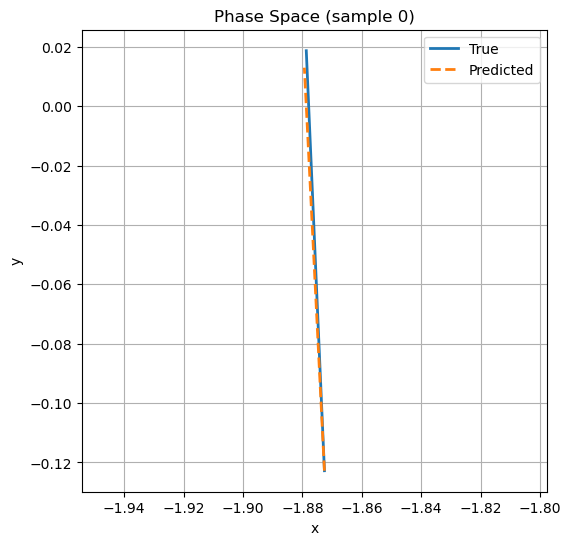

Plotting trajectory vs time from sample 0


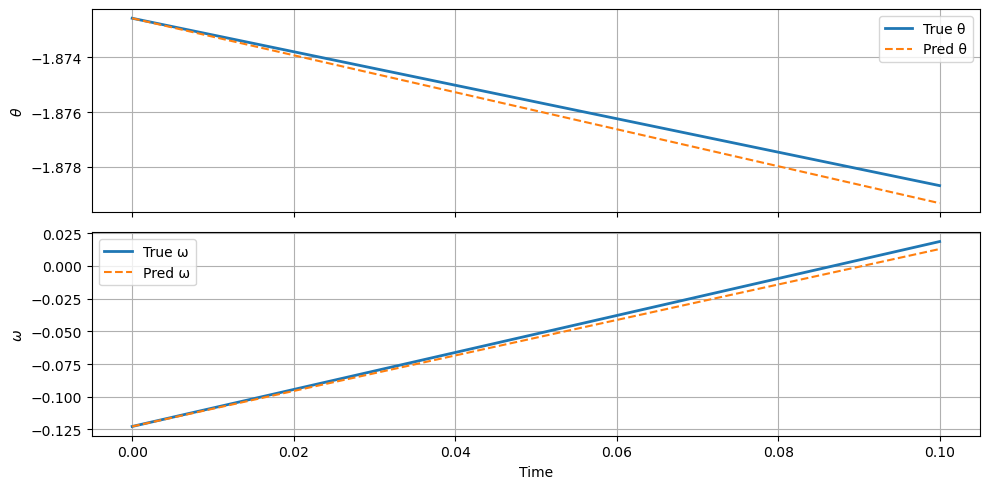

Plotting learned vector field


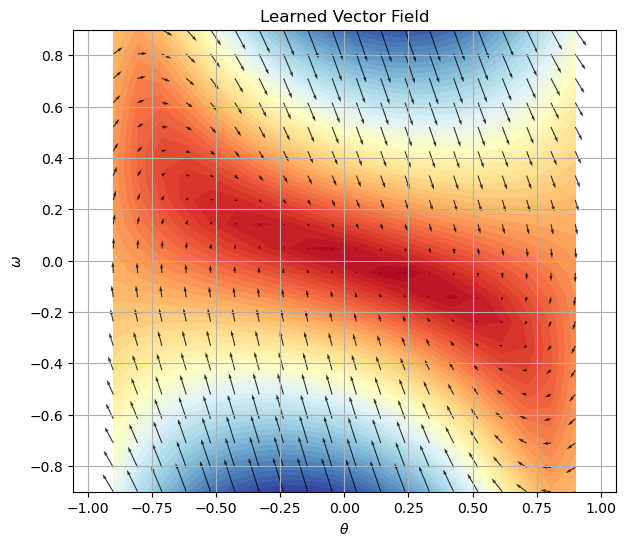

Plotting fixed points
Found 1 fixed point(s):
Fixed point 1: [ 0.2101 -0.0515]
  Eigenvalues: [-0.4 -2.5]
  Stability: Stable node


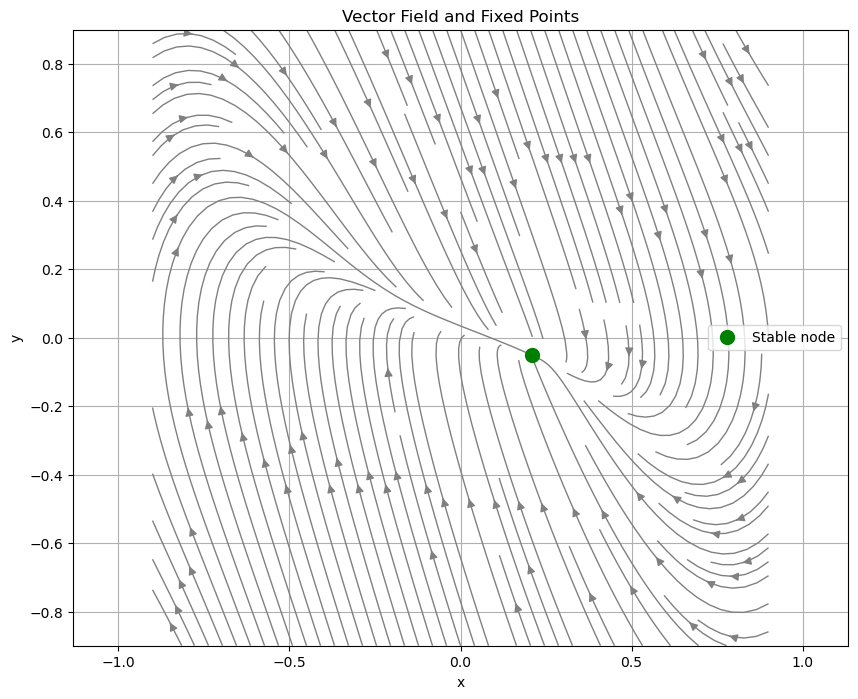

Plotting phase space for all samples for train data


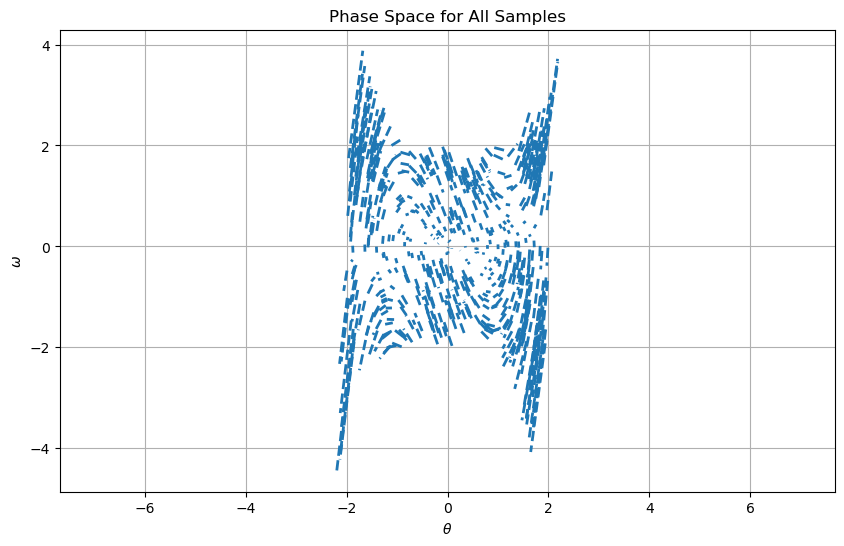

Plotting phase space for all samples for test data


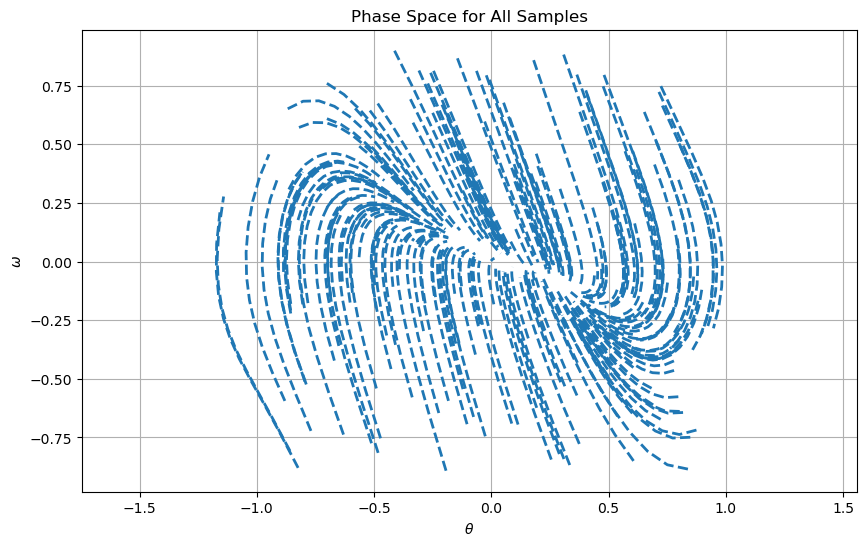

Time taken to train in seconds:  85.71334505081177
MSE: 0.00039946770836195354
MAE: 0.014424932256806642
Chamfer: 0.0013553738037080621
Hausdorff: 0.04281171382362859


In [79]:
outputs(node=node, theta_range=(-0.9, 0.9), omega_range=(-0.9, 0.9), density=20, visualize=True,bounds=(-0.9, 0.9))

## Interpolation vs Extrapolation

### Input

In [80]:
def equations(x, y):
  # dtheta/dt = omega
  # domega/dt = -theta
  return np.array([y, (x**2)/2 - x])
train_parameters = [500,1,0.01,[-2.5,2.5],[-3,2],None]
test_parameters_1 = [600,1.0,0.001,1,1,None]
test_parameters_2 = [600,5.0,0.01,1,1,None]
test_parameters_3 = [600,1.0,0.01,5,5,None]
test_parameters_4 = [600,1.0,0.001,[2,2.5],[1.5,2],None]

In [81]:
node = NODE(equations,train_parameters,train_parameters) # First see performance on train data

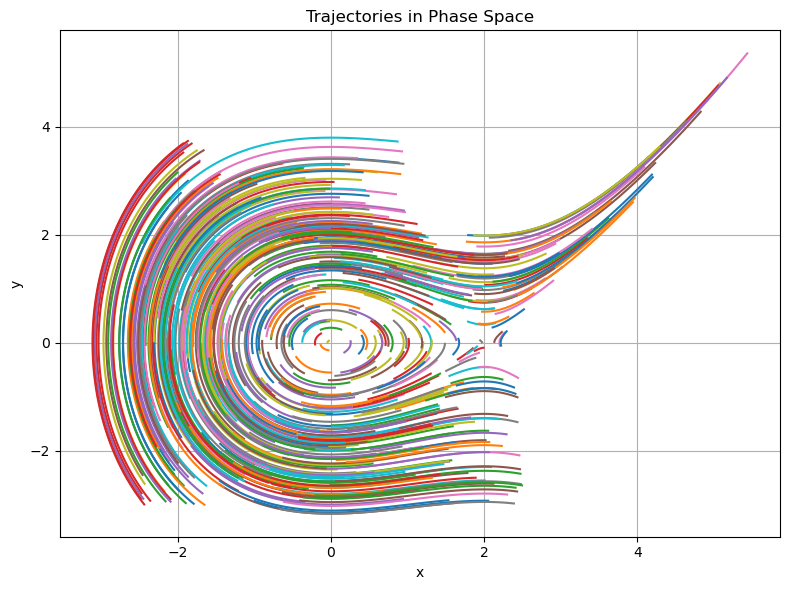

In [82]:
node.plot_trajectory_actual(node.train_data)

### Train

In [83]:
node.train()

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │  4.5 K │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 4.5 K                                                                                            
Non-trainable params: 0                                                                                            
Total params: 4.5 K                                                                                                
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 8                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=200` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │   0.0017094925278797746   │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │   0.0017793247243389487   │
└───────────────────────────┴───────────────────────────┘

### Outputs

#### Train Data

Plotting phase space from sample 0


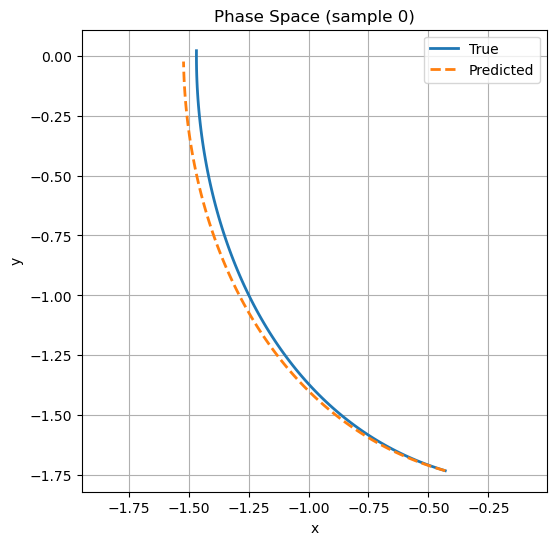

Plotting trajectory vs time from sample 0


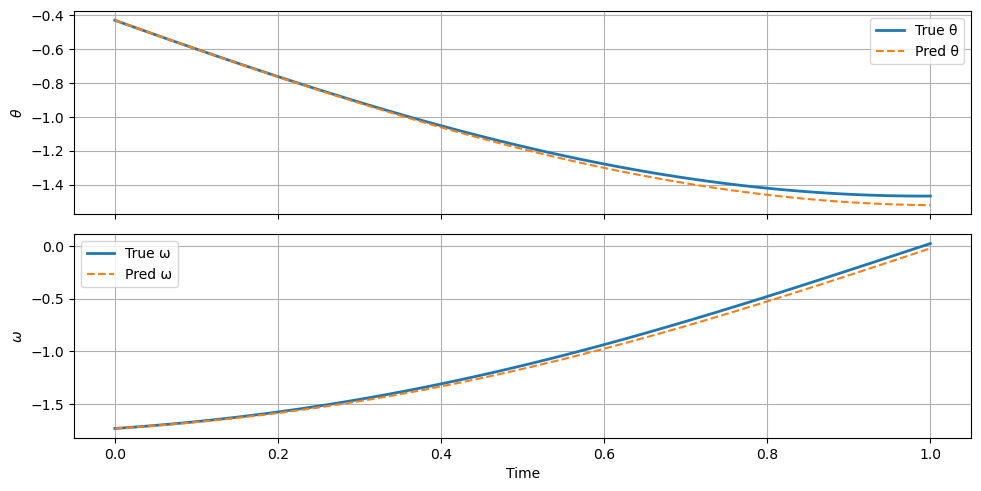

Plotting learned vector field


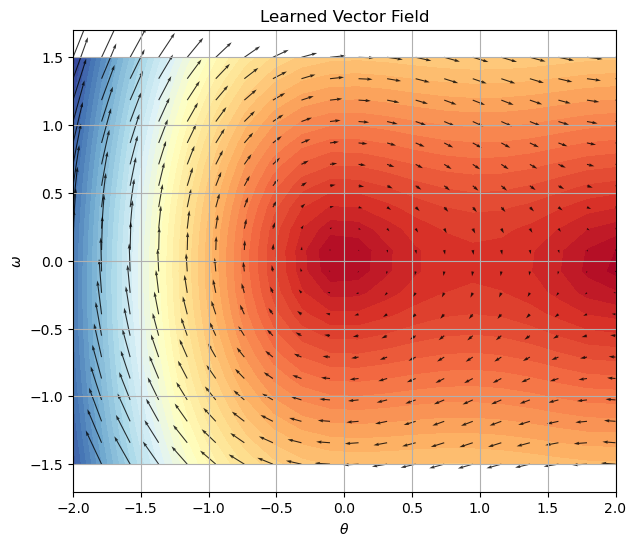

Plotting fixed points
Found 2 fixed point(s):
Fixed point 1: [-0.0211  0.0165]
  Eigenvalues: [0.+1.j 0.-1.j]
  Stability: Center (neutrally stable)
Fixed point 2: [ 1.9774 -0.0186]
  Eigenvalues: [ 1. -1.]
  Stability: Saddle point (unstable)


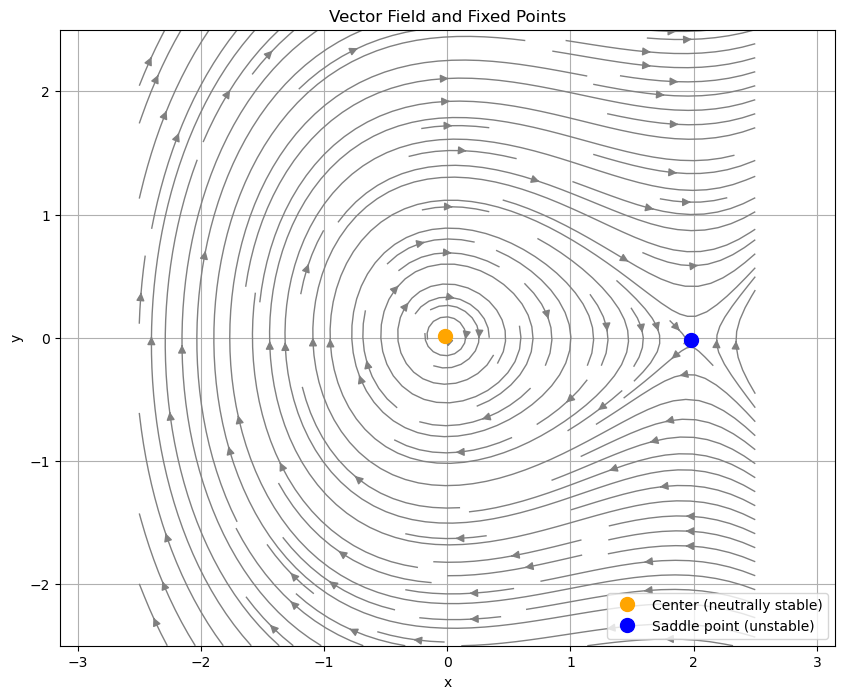

Plotting phase space for all samples for train data


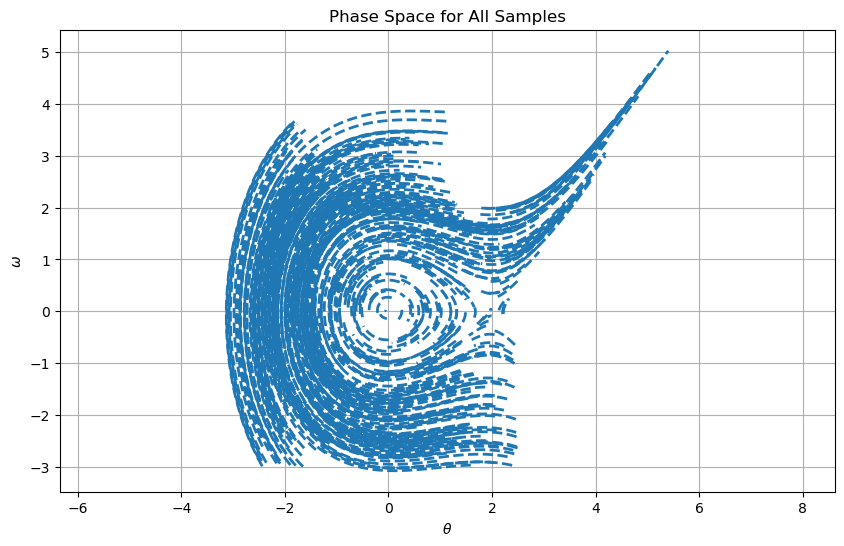

Plotting phase space for all samples for test data


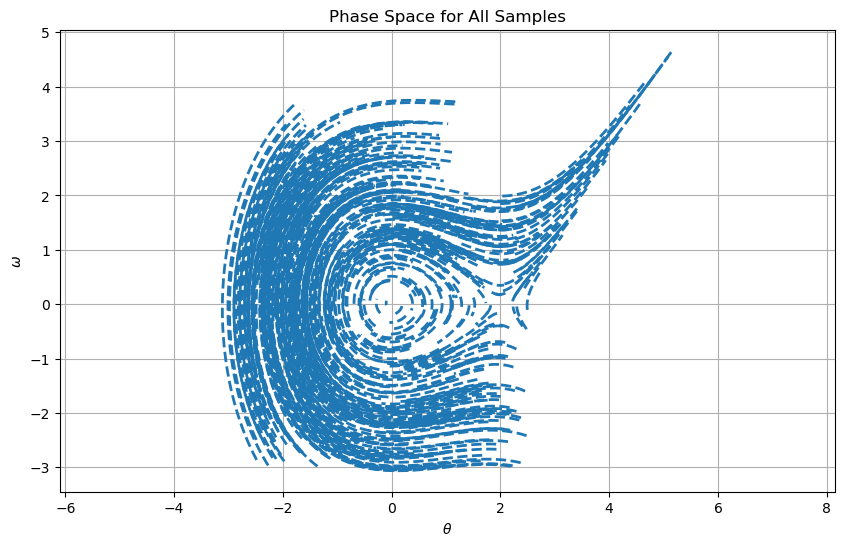

Time taken to train in seconds:  2159.0482335090637
MSE: 0.0013703229238294626
MAE: 0.024793194124707953
Chamfer: 0.0018948649965968797
Hausdorff: 0.06742615183299316


In [84]:
outputs(node=node, theta_range=(-2, 2), omega_range=(-1.5, 1.5), density=20, visualize=True,bounds=(-2.5, 2.5))

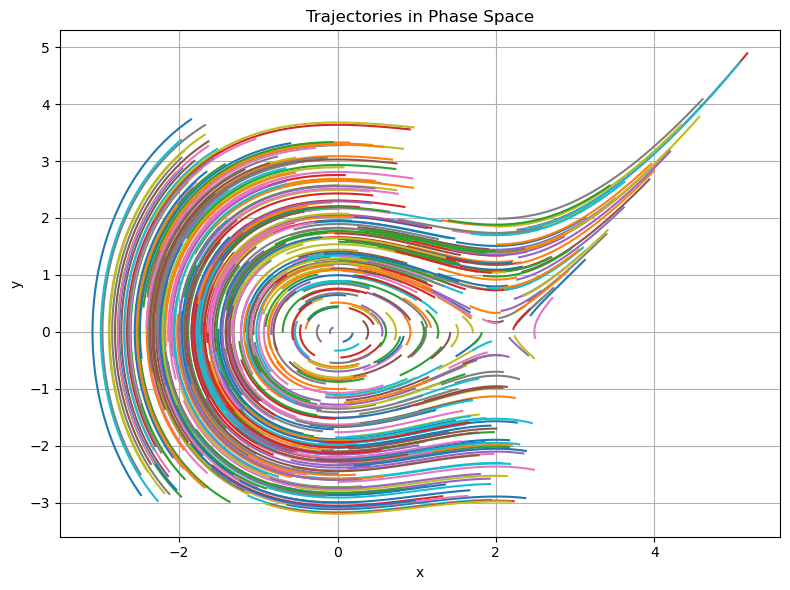

In [85]:
node.plot_trajectory_actual(node.test_data)

#### Interpolation(slow moving region)

In [86]:
node.test_data = node.generate_dataset(node.equation, num_trajectories=test_parameters_1[0], time_span=test_parameters_1[1], h=test_parameters_1[2], theta_range = test_parameters_1[3], omega_range = test_parameters_1[4],starting_points = test_parameters_1[5])

Plotting phase space from sample 0


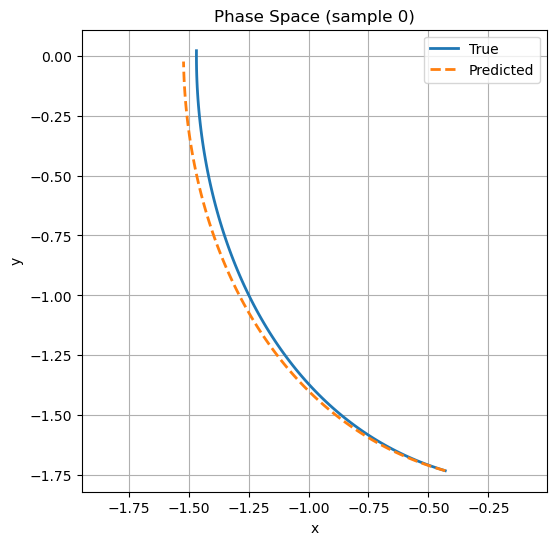

Plotting trajectory vs time from sample 0


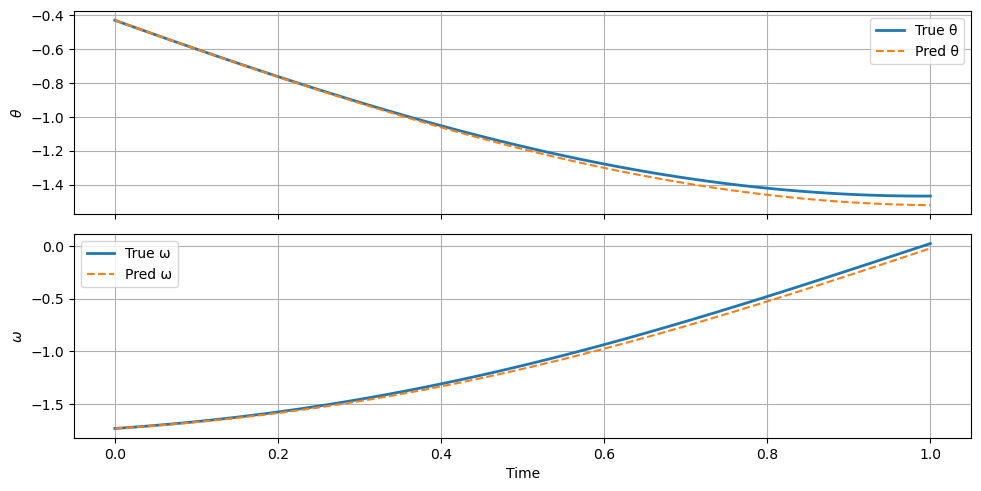

Plotting learned vector field


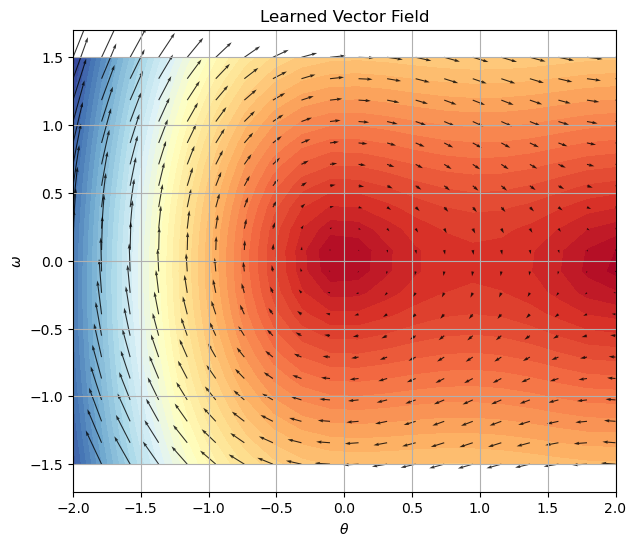

Plotting fixed points
Found 2 fixed point(s):
Fixed point 1: [ 1.9774 -0.0186]
  Eigenvalues: [ 1. -1.]
  Stability: Saddle point (unstable)
Fixed point 2: [-0.0211  0.0165]
  Eigenvalues: [0.+1.j 0.-1.j]
  Stability: Center (neutrally stable)


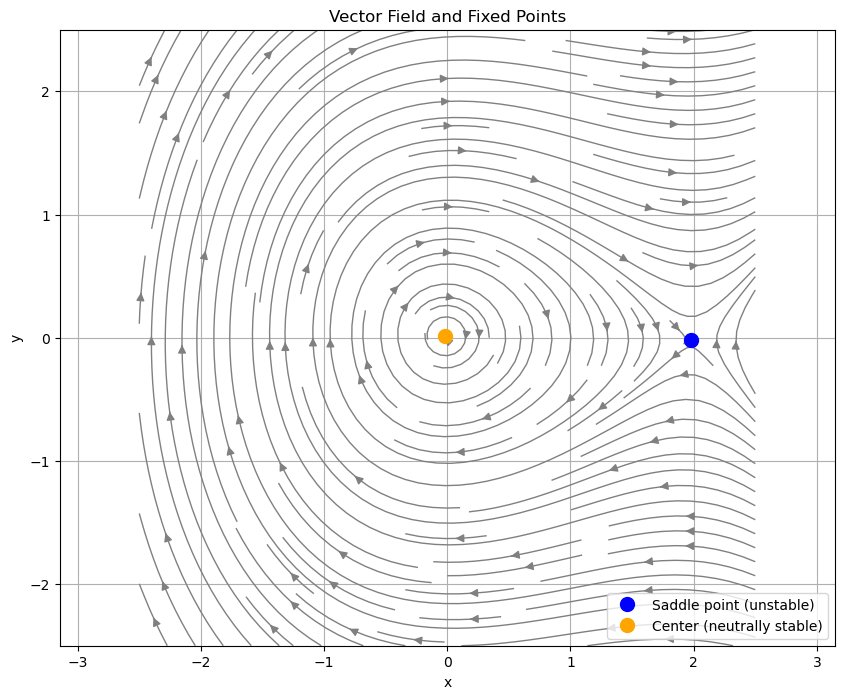

Plotting phase space for all samples for train data


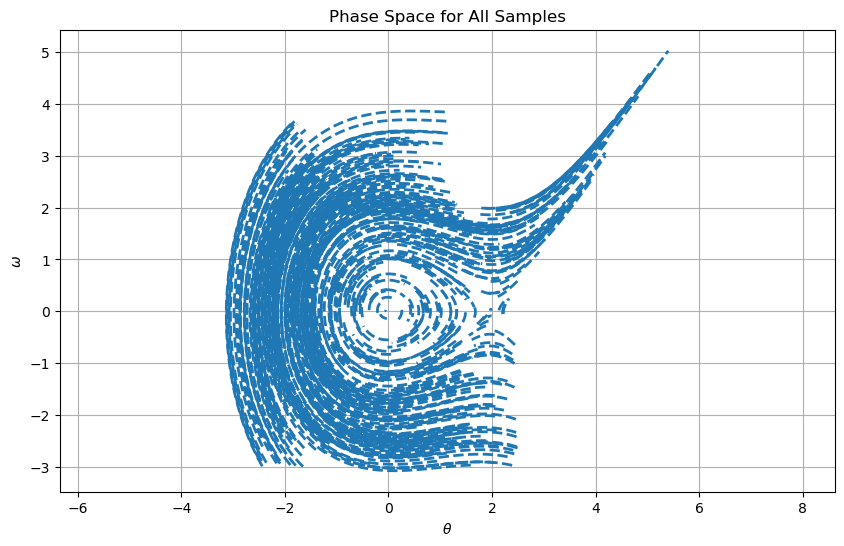

Plotting phase space for all samples for test data


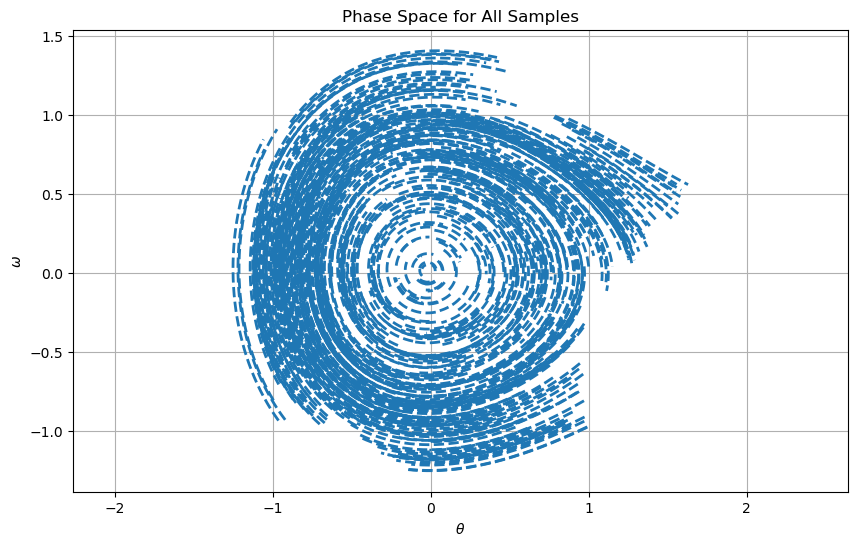

Time taken to train in seconds:  2159.0482335090637
MSE: 0.00020789503655957258
MAE: 0.010237127974590598
Chamfer: 0.0004395751205838868
Hausdorff: 0.028585025061155546


In [87]:
outputs(node=node, theta_range=(-2, 2), omega_range=(-1.5, 1.5), density=20, visualize=True,bounds=(-2.5, 2.5))

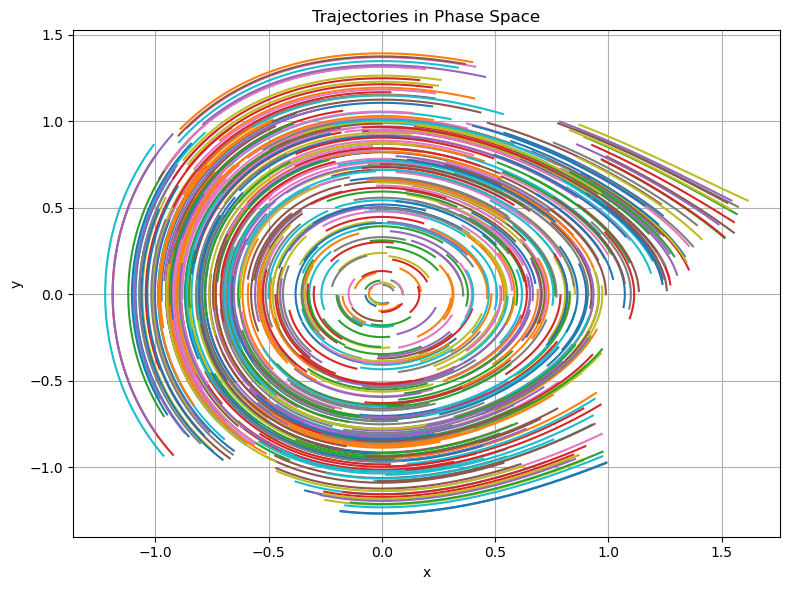

In [88]:
node.plot_trajectory_actual(node.test_data)

#### Interpolation(fast moving region)

In [89]:
node.test_data = node.generate_dataset(node.equation, num_trajectories=test_parameters_4[0], time_span=test_parameters_4[1], h=test_parameters_4[2], theta_range = test_parameters_4[3], omega_range = test_parameters_4[4],starting_points = test_parameters_4[5])

Plotting phase space from sample 0


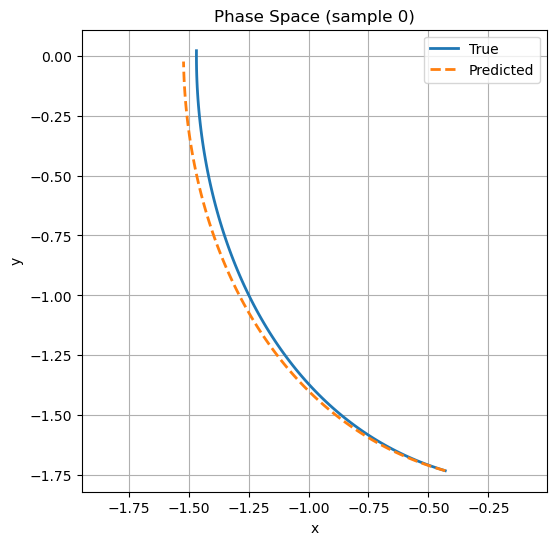

Plotting trajectory vs time from sample 0


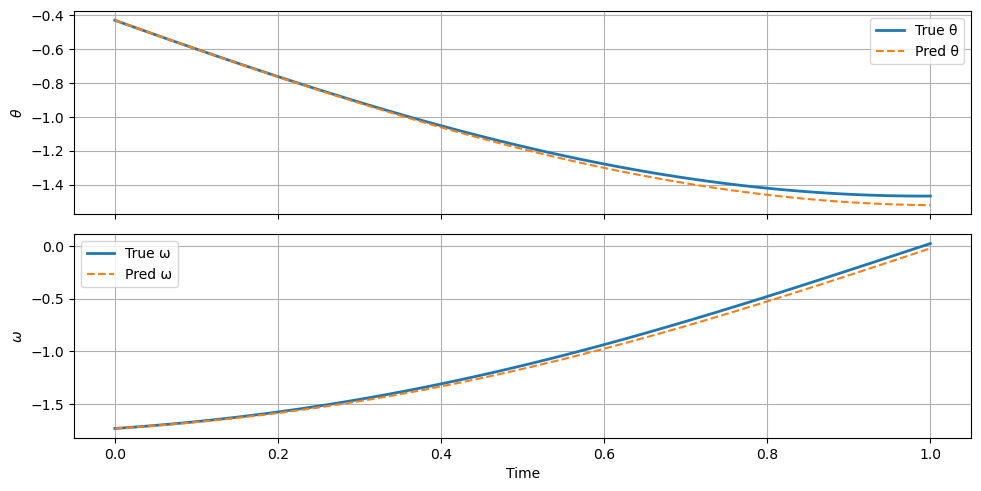

Plotting learned vector field


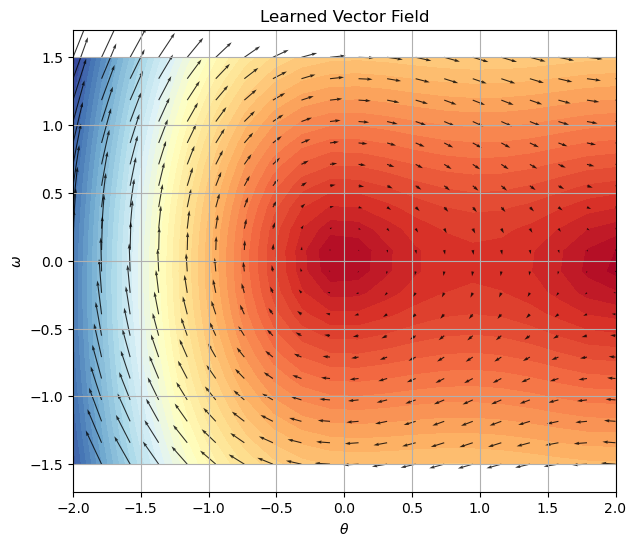

Plotting fixed points
Found 2 fixed point(s):
Fixed point 1: [ 1.9774 -0.0187]
  Eigenvalues: [ 1. -1.]
  Stability: Saddle point (unstable)
Fixed point 2: [-0.0211  0.0164]
  Eigenvalues: [0.+1.j 0.-1.j]
  Stability: Center (neutrally stable)


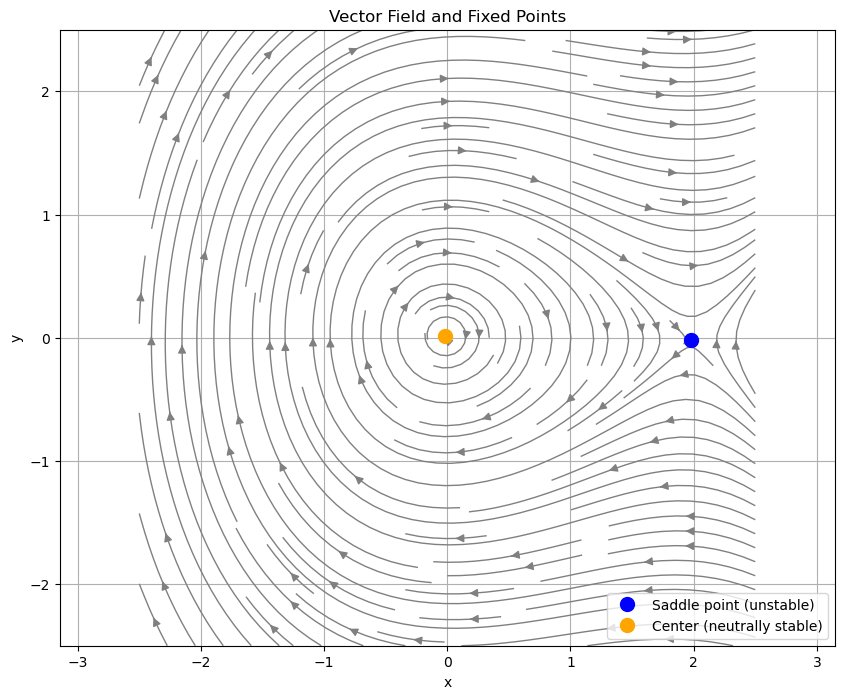

Plotting phase space for all samples for train data


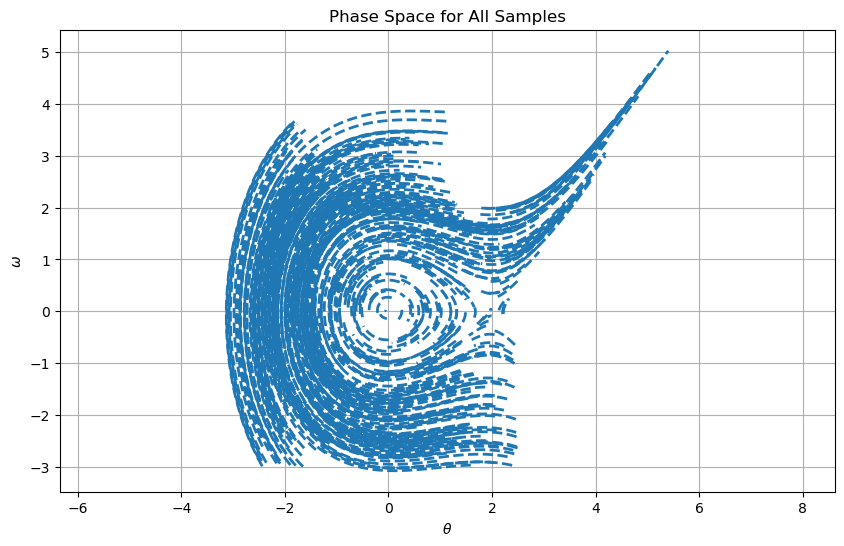

Plotting phase space for all samples for test data


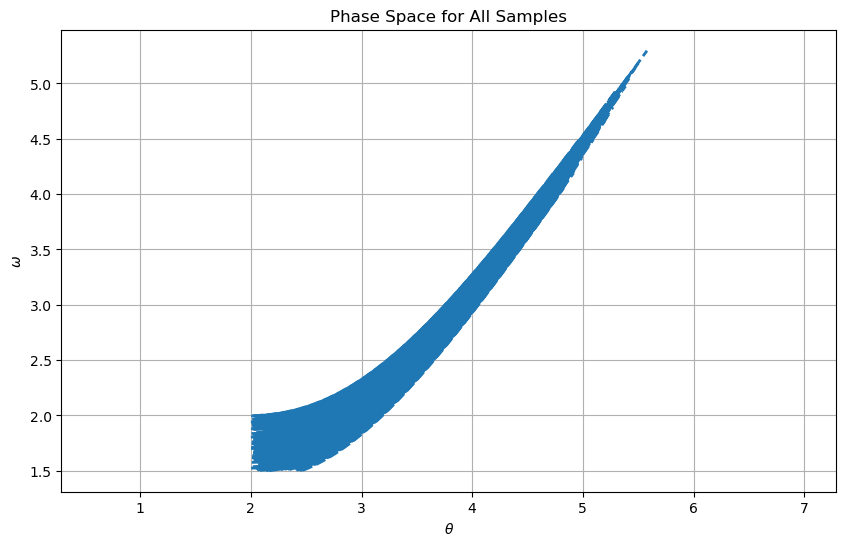

Time taken to train in seconds:  2159.0482335090637
MSE: 0.0008175784163662077
MAE: 0.017199154514819383
Chamfer: 0.0008512249083317632
Hausdorff: 0.11191074584455796


In [90]:
outputs(node=node, theta_range=(-2, 2), omega_range=(-1.5, 1.5), density=20, visualize=True,bounds=(-2.5, 2.5))

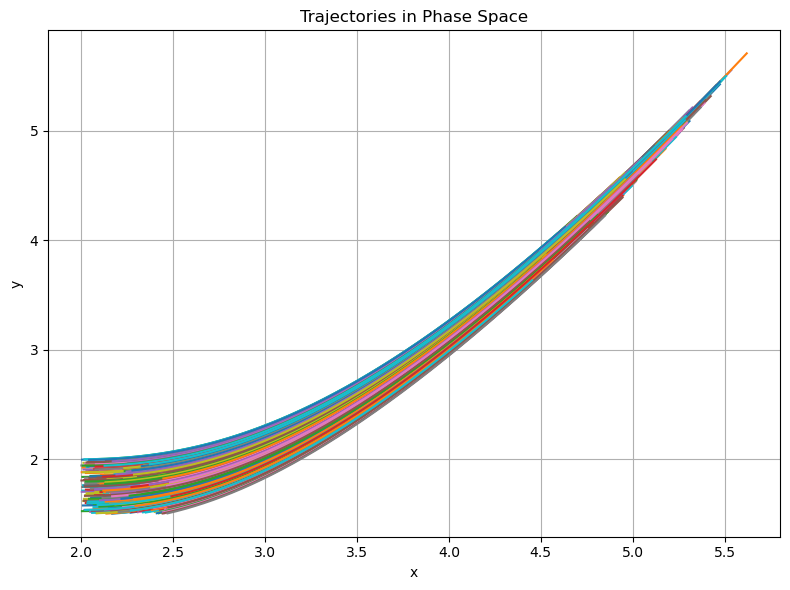

In [91]:
node.plot_trajectory_actual(node.test_data)

#### Longer evolution

In [92]:
node.test_data = node.generate_dataset(node.equation, num_trajectories=test_parameters_2[0], time_span=test_parameters_2[1], h=test_parameters_2[2], theta_range = test_parameters_2[3], omega_range = test_parameters_2[4],starting_points = test_parameters_2[5])

Plotting phase space from sample 0


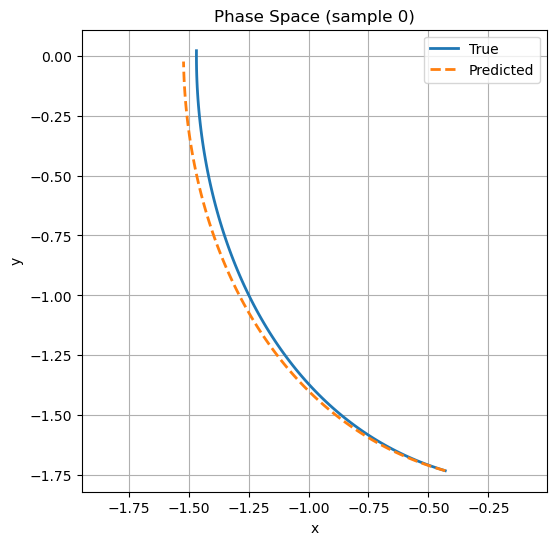

Plotting trajectory vs time from sample 0


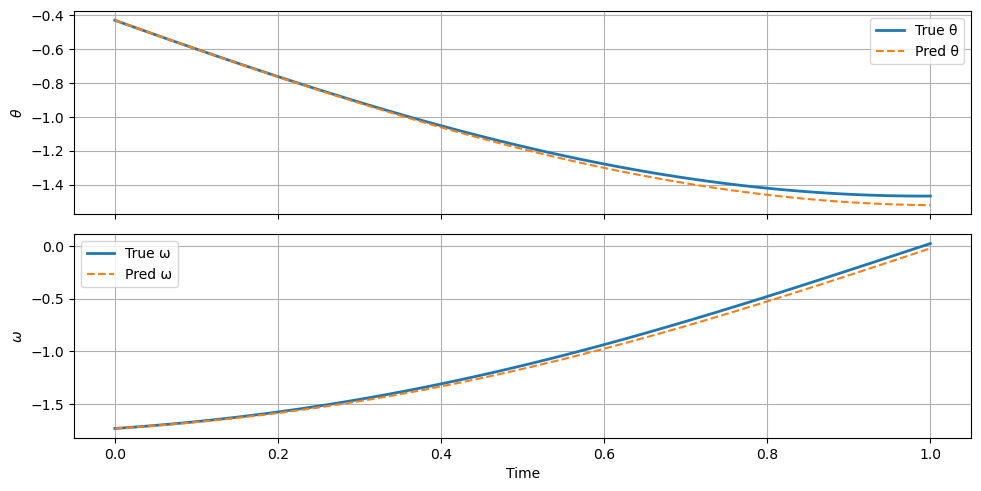

Plotting learned vector field


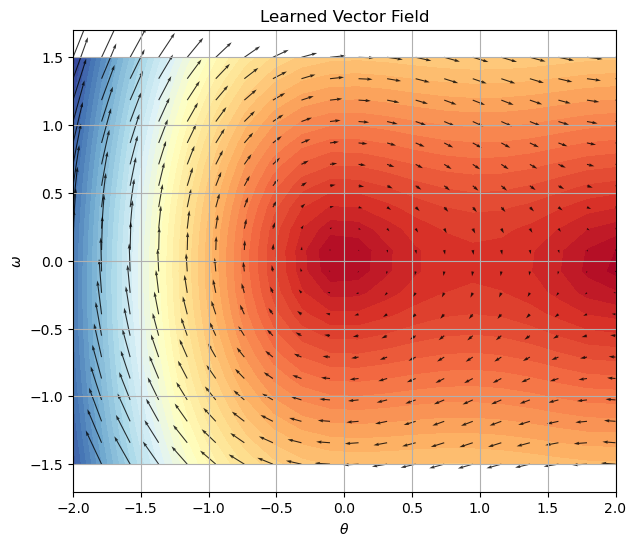

Plotting fixed points
Found 2 fixed point(s):
Fixed point 1: [ 1.9774 -0.0187]
  Eigenvalues: [ 1. -1.]
  Stability: Saddle point (unstable)
Fixed point 2: [-0.0211  0.0165]
  Eigenvalues: [0.+1.j 0.-1.j]
  Stability: Center (neutrally stable)


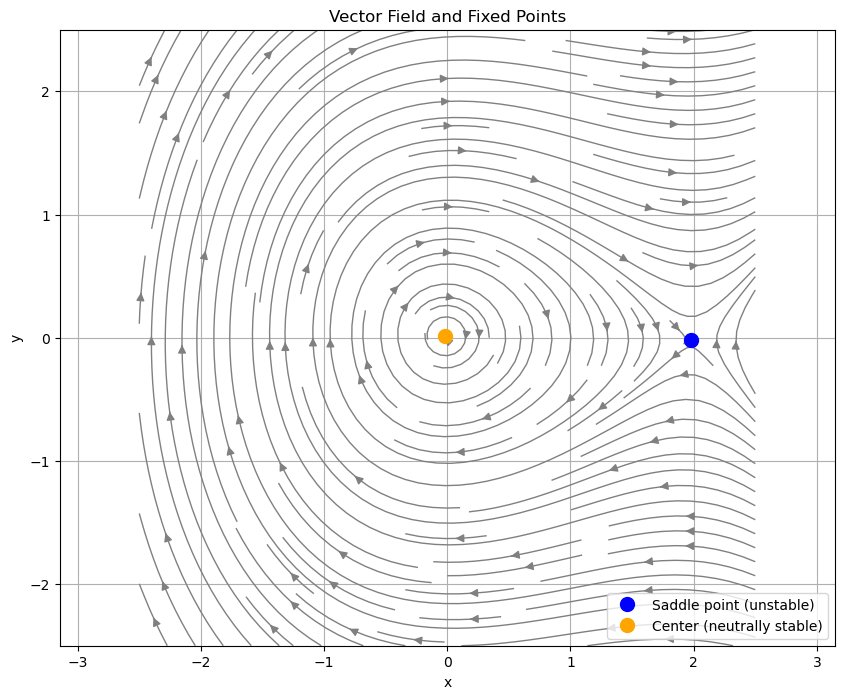

Plotting phase space for all samples for train data


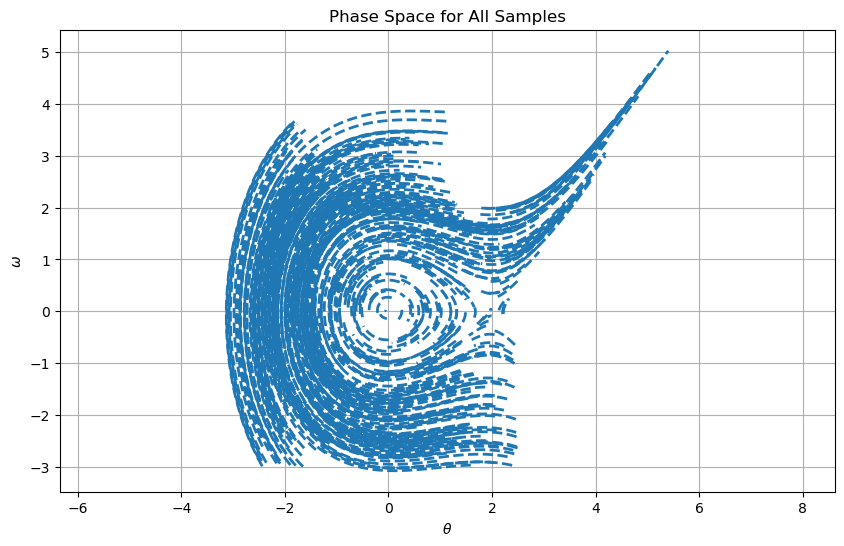

Plotting phase space for all samples for test data


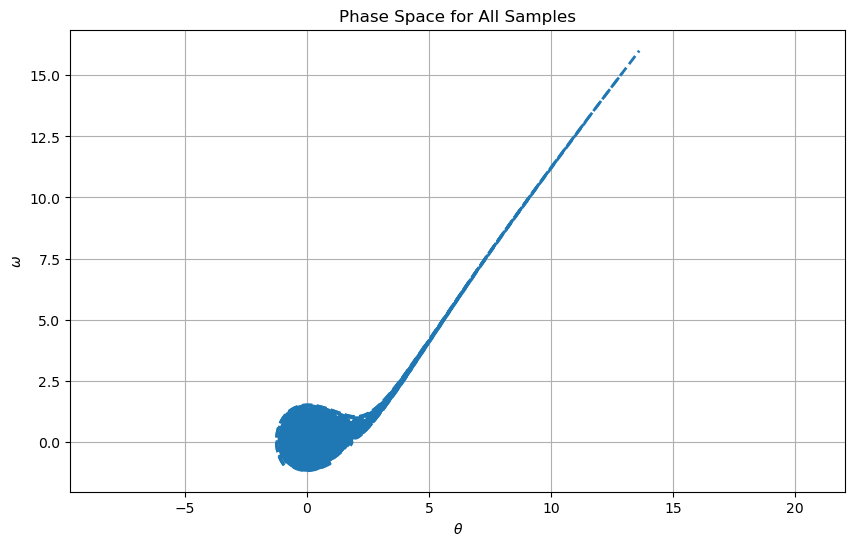

Time taken to train in seconds:  2159.0482335090637
MSE: 0.020112010878632038
MAE: 0.06486428532749415
Chamfer: 0.023274737958236074
Hausdorff: 0.33702886750262623


In [93]:
outputs(node=node, theta_range=(-2, 2), omega_range=(-1.5, 1.5), density=20, visualize=True,bounds=(-2.5, 2.5))

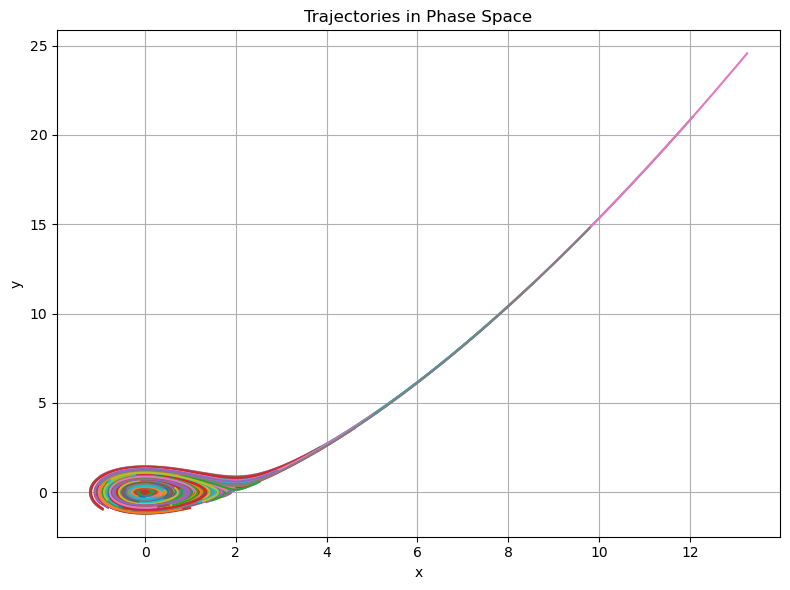

In [94]:
node.plot_trajectory_actual(node.test_data)

#### Extrapolation

In [95]:
node.test_data = node.generate_dataset(node.equation, num_trajectories=test_parameters_3[0], time_span=test_parameters_3[1], h=test_parameters_3[2], theta_range = test_parameters_3[3], omega_range = test_parameters_3[4],starting_points = test_parameters_3[5])

Plotting phase space from sample 0


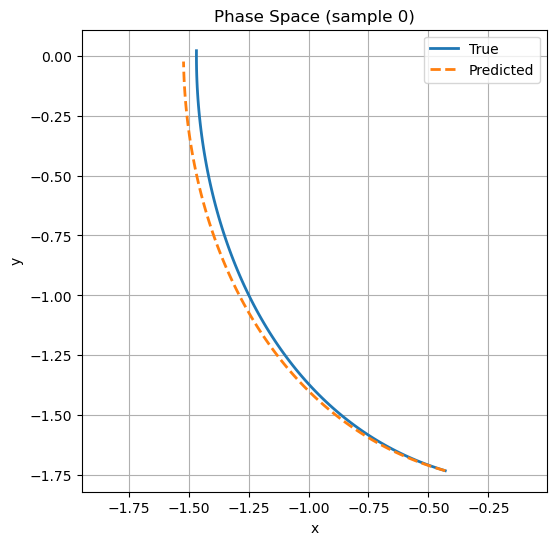

Plotting trajectory vs time from sample 0


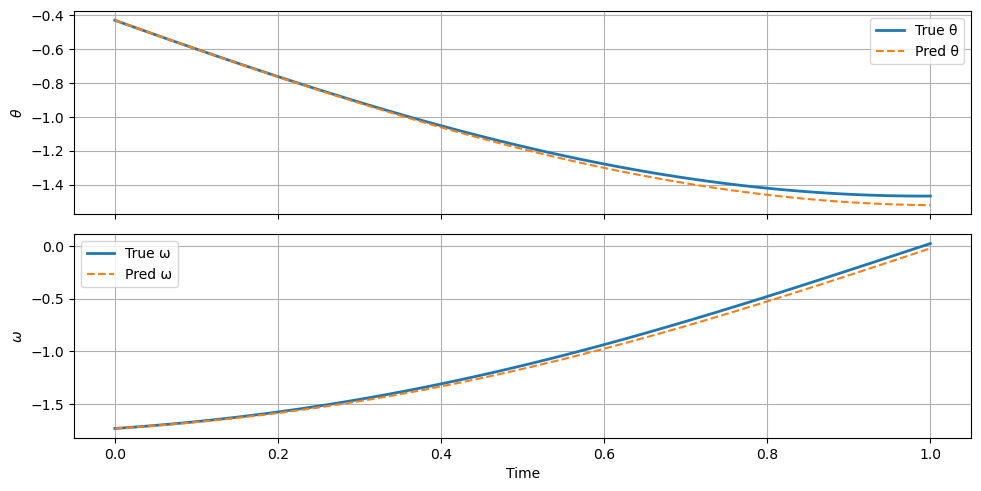

Plotting learned vector field


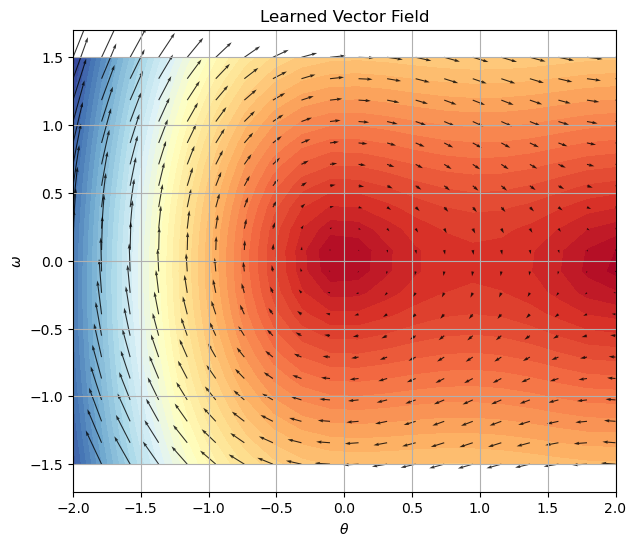

Plotting fixed points
Found 2 fixed point(s):
Fixed point 1: [-0.0211  0.0165]
  Eigenvalues: [0.+1.j 0.-1.j]
  Stability: Center (neutrally stable)
Fixed point 2: [ 1.9774 -0.0186]
  Eigenvalues: [ 1. -1.]
  Stability: Saddle point (unstable)


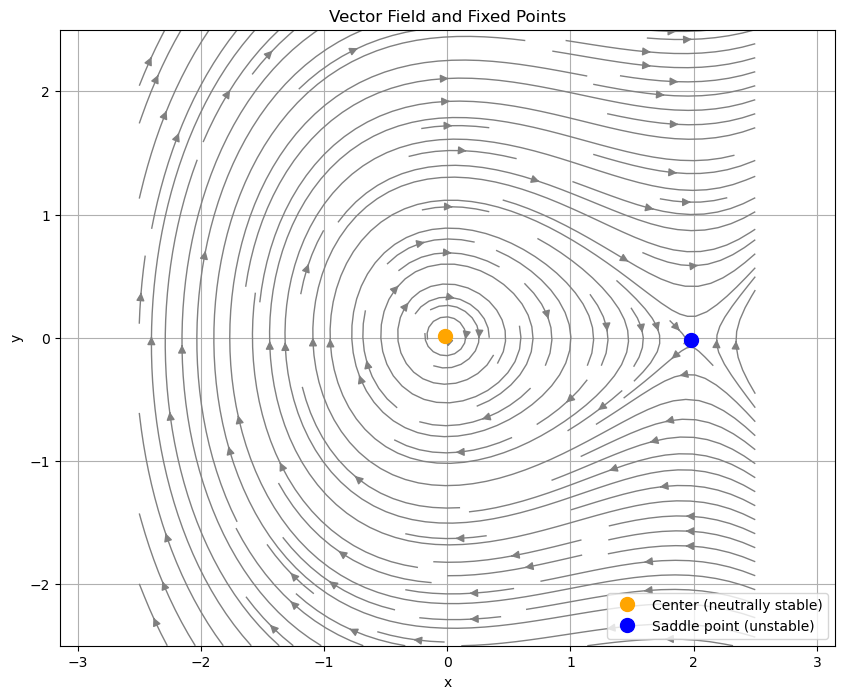

Plotting phase space for all samples for train data


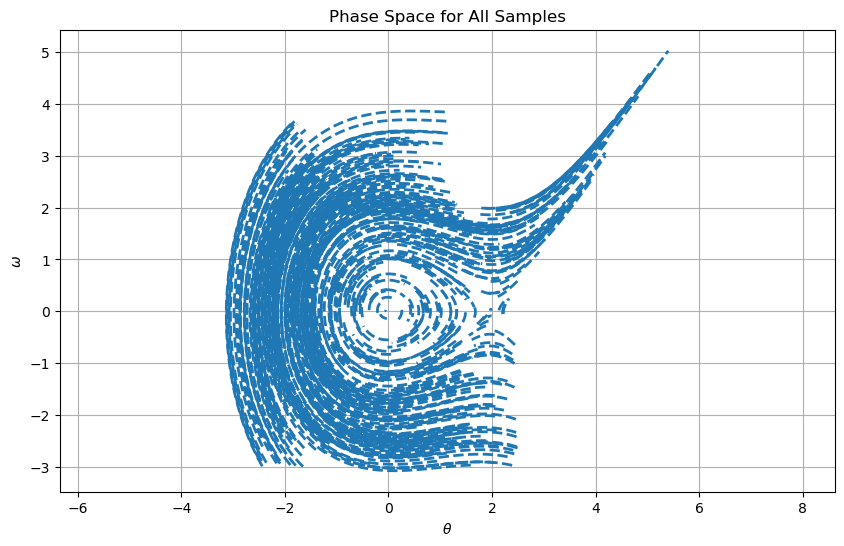

Plotting phase space for all samples for test data


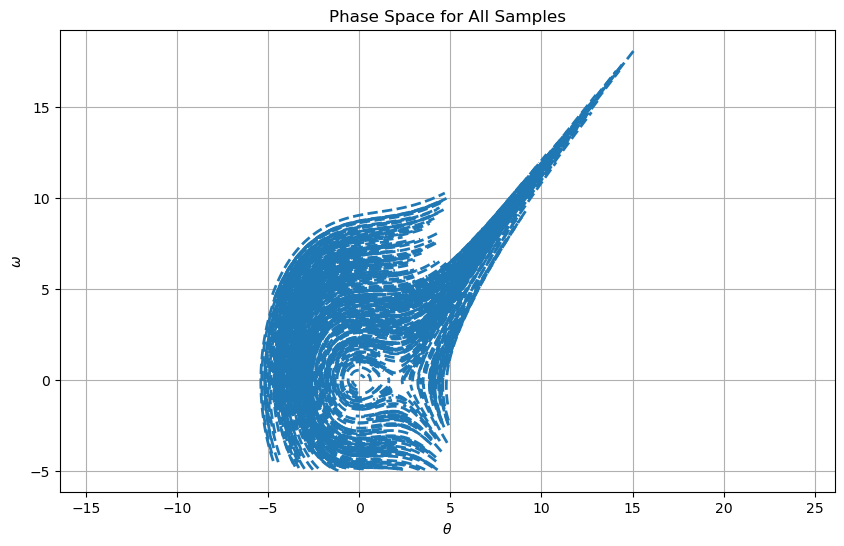

Time taken to train in seconds:  2159.0482335090637
MSE: 1.0276179334854698
MAE: 0.22067721567621143
Chamfer: 1.5461523196903484
Hausdorff: 1.379011881524094


In [96]:
outputs(node=node, theta_range=(-2, 2), omega_range=(-1.5, 1.5), density=20, visualize=True,bounds=(-2.5, 2.5))

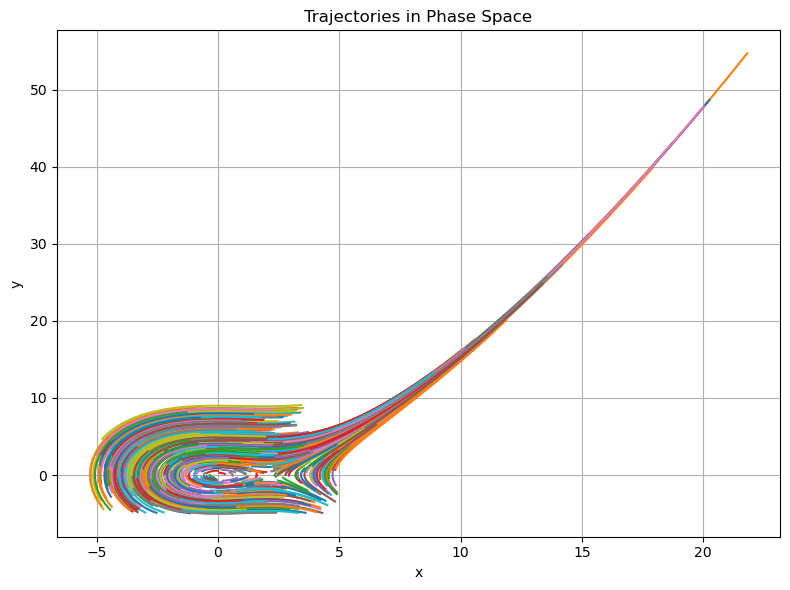

In [97]:
node.plot_trajectory_actual(node.test_data)

## 3D Systems: Lorenz

### Non Chaotic Regime

#### Input

In [124]:
def equations(x, y, z):
  σ = 10
  ρ = 10 # 0.8 for fixed, 10 for stable, 28 for butterfly chaos
  β = 8 / 3
  return np.array([
      σ * (y - x),
      x * (ρ - z) - y,
      x * y - β * z
  ])

In [125]:
def rk4(f, x0, h, n):
  v = [0] * (n + 1)
  v[0] = x0.copy()

  for i in range(1, n + 1):
      k1 = h * f(*v[i-1]) # equivalent to f(x, y, z)
      k2 = h * f(*(v[i-1] + 0.5 * k1))
      k3 = h * f(*(v[i-1] + 0.5 * k2))
      k4 = h * f(*(v[i-1] + k3))
      v[i] = v[i-1] + (k1 + 2*k2 + 2*k3 + k4) / 6

  t = np.linspace(0, n*h, n+1)
  return t, np.array(v)

In [126]:
def generate_dataset(f, num_trajectories=100, time_span=0.25, h=0.01, starting_points = None):
  n = int(time_span / h)
  t = np.linspace(0, time_span, n + 1)

  dataset = []
  if starting_points is None:
    for _ in range(num_trajectories):
      # Sample random initial conditions: x ∈ [-10, 10], y ∈ [-10, 10], z ∈ [-10, 10]
      x0 = np.random.uniform(-10, 10)
      y0 = np.random.uniform(-10, 10)
      z0 = np.random.uniform(-10, 10)

      _, v = rk4(f, np.array([x0, y0, z0]), h, n)
      dataset.append((np.array([x0, y0, z0]), t, v))
  else:
    for x0, y0, z0 in starting_points:
      _, v = rk4(f, np.array([x0, y0, z0]), h, n)
      dataset.append((np.array([x0, y0, z0]), t, v))

  return dataset

In [127]:
class Dataset(Dataset):
  def __init__(self, raw_dataset):
    self.data = raw_dataset

  def __len__(self):
    return len(self.data)

  def __getitem__(self, idx):
    x0, t, traj = self.data[idx]
    return {
        'initial': torch.tensor(x0, dtype=torch.float32),
        'trajectory': torch.tensor(traj, dtype=torch.float32),
    }

#### Neural ODE Architecture

In [128]:
class DataModule(pl.LightningDataModule):
  def __init__(self, dataset, batch_size=32):
    super().__init__()
    self.dataset = dataset
    self.batch_size = batch_size

  def setup(self, stage=None):
    total_size = len(self.dataset)
    val_size = test_size = total_size // 10
    train_size = total_size - val_size - test_size
    self.train_dataset, self.val_dataset, self.test_dataset = random_split(
        self.dataset, [train_size, val_size, test_size]
    )

  def train_dataloader(self):
    return DataLoader(self.train_dataset, batch_size=self.batch_size, shuffle=True)

  def val_dataloader(self):
    return DataLoader(self.val_dataset, batch_size=self.batch_size)

  def test_dataloader(self):
    return DataLoader(self.test_dataset, batch_size=self.batch_size)

In [129]:
class _ODEFunc(nn.Module):
  def __init__(self, module, autonomous=True):
    super().__init__()
    self.module = module
    self.autonomous = autonomous

  def forward(self, t, x):
    if not self.autonomous:
      x = torch.cat([torch.ones_like(x[:, [0]]) * t, x], 1)
    return self.module(x)


class ODEBlock(nn.Module):
  def __init__(self, odefunc: nn.Module, solver: str = 'dopri5',
              rtol: float = 1e-4, atol: float = 1e-4, adjoint: bool = True,
              autonomous: bool = True):
    super().__init__()
    self.odefunc = _ODEFunc(odefunc, autonomous=autonomous)
    self.rtol = rtol
    self.atol = atol
    self.solver = solver
    self.use_adjoint = adjoint
    self.integration_time = torch.tensor([0, 1], dtype=torch.float32)

  @property
  def ode_method(self):
    return torchdiffeq.odeint_adjoint if self.use_adjoint else torchdiffeq.odeint

  def forward(self, x: torch.Tensor, adjoint: bool = True, integration_time=None):
    integration_time = self.integration_time if integration_time is None else integration_time
    integration_time = integration_time.to(x.device)
    ode_method =  torchdiffeq.odeint_adjoint if adjoint else torchdiffeq.odeint
    out = ode_method(
      self.odefunc, x, integration_time, rtol=self.rtol,
      atol=self.atol, method=self.solver)
    return out

In [130]:
class Learner(pl.LightningModule):
  def __init__(self, model: nn.Module, t_span: torch.Tensor, learning_rate: float = 5e-3):
    super().__init__()
    self.model = model
    self.t_span = t_span
    self.learning_rate = learning_rate

  def forward(self, x, t):
    return self.model(x, integration_time=t)

  def training_step(self, batch, batch_idx):
    x0 = batch['initial']
    t = self.t_span
    y_true = batch['trajectory']
    y_pred = self.model(x0, adjoint=True, integration_time=t)
    loss = F.mse_loss(y_pred.transpose(0, 1), y_true)  # Shape [batch, time, dim]
    self.log('train_loss', loss, prog_bar=True)
    return loss

  def validation_step(self, batch, batch_idx):
    x0 = batch['initial']
    t = self.t_span
    y_true = batch['trajectory']
    y_pred = self.model(x0, adjoint=False, integration_time=t)
    loss = F.mse_loss(y_pred.transpose(0, 1), y_true)
    self.log('val_loss', loss, prog_bar=True)
    return loss

  def test_step(self, batch, batch_idx):
    x0 = batch['initial']
    t = self.t_span
    y_true = batch['trajectory']
    y_pred = self.model(x0, adjoint=False, integration_time=t)
    loss = F.mse_loss(y_pred.transpose(0, 1), y_true)
    self.log('test_loss', loss, prog_bar=True)
    return loss

  def configure_optimizers(self):
      return torch.optim.Adam(self.model.parameters(), lr=self.learning_rate)

In [131]:
def evaluate_errors(dataset=None, learner=None, t=None):
    learner.eval()

    mse_total = 0
    mae_total = 0
    chamfer_total = 0
    hausdorff_total = 0
    total = len(dataset)

    with torch.no_grad():
        for sample in dataset:
            x0 = sample['initial'].unsqueeze(0)
            true_traj = sample['trajectory'].numpy()
            pred_traj = learner(x0, t).squeeze().cpu().numpy()

            # Mean Square Error
            mse_total += np.mean((true_traj - pred_traj)**2)

            # Mean Absolute Error
            mae_total += np.mean(np.abs(true_traj - pred_traj))

            # Chamfer Distance
            d_true_to_pred = np.mean([np.min(np.sum((pred_traj - pt)**2, axis=1)) for pt in true_traj])
            d_pred_to_true = np.mean([np.min(np.sum((true_traj - pt)**2, axis=1)) for pt in pred_traj])
            chamfer_total += d_true_to_pred + d_pred_to_true

            # Hausdorff Distance (symmetric)
            hausdorff_ab = directed_hausdorff(true_traj, pred_traj)[0]
            hausdorff_ba = directed_hausdorff(pred_traj, true_traj)[0]
            hausdorff_total += max(hausdorff_ab, hausdorff_ba)

    return {
        'mse': mse_total / total,
        'mae': mae_total / total,
        'chamfer': chamfer_total / total,
        'hausdorff': hausdorff_total / total
    }
  

#### Train

In [132]:
# Create your dataset and datamodule
raw_dataset = generate_dataset(equations, num_trajectories=400, time_span=1)
dataset = Dataset(raw_dataset)
data_module = DataModule(dataset)

# Define model
f = nn.Sequential(
    nn.Linear(3, 64),
    nn.SiLU(),
    nn.Linear(64, 3)
)
model = ODEBlock(f, adjoint=True)

# Define learner
t_span = torch.tensor(raw_dataset[0][1], dtype=torch.float32)  # all have same time steps
learner = Learner(model, t_span)

# Train
start_time = time.time()
trainer = pl.Trainer(
    max_epochs=400,
    accelerator="cpu",
    devices=1,
    callbacks=[
        pl.callbacks.ModelCheckpoint(monitor="val_loss", mode="min"),
        pl.callbacks.RichProgressBar()
    ],
    log_every_n_steps=1,
    default_root_dir="/lightning_logs"
)
trainer.fit(learner, datamodule=data_module)
end_time = time.time()

# Validate and test
val_result = trainer.validate(learner, datamodule=data_module)
test_result = trainer.test(learner, datamodule=data_module)

# Evaluate errors
errors = evaluate_errors(dataset, learner, t_span)

# Print results
print(f"Time taken to train in seconds: {end_time - start_time:.2f}")
print("MSE:", errors['mse'])
print("MAE:", errors['mae'])
print("Chamfer:", errors['chamfer'])
print("Hausdorff:", errors['hausdorff'])
    

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │    0.3780452013015747     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     0.368794709444046     │
└───────────────────────────┴───────────────────────────┘

Time taken to train in seconds: 1688.67
MSE: 0.553558580102399
MAE: 0.4159983475506306
Chamfer: 1.5250155390053988
Hausdorff: 1.3832912766373178


#### Plot

In [133]:
def plot_phase_space_from_sample_3d(sample_idx, dataset, learner, t_span):
    sample = dataset[sample_idx]
    x0 = sample['initial'].unsqueeze(0)
    true_traj = sample['trajectory'].numpy()

    learner.eval()
    with torch.no_grad():
        pred_traj = learner(x0, t_span).squeeze().cpu().numpy()

    fig = plt.figure(figsize=(8, 6))
    ax = fig.add_subplot(111, projection='3d')
    ax.plot(true_traj[:, 0], true_traj[:, 1], true_traj[:, 2], label="True", lw=2)
    ax.plot(pred_traj[:, 0], pred_traj[:, 1], pred_traj[:, 2], '--', label="Predicted", lw=2)

    ax.set_xlabel(r"$x$")
    ax.set_ylabel(r"$y$")
    ax.set_zlabel(r"$z$")
    ax.set_title(f"3D Phase Space (sample {sample_idx})")
    ax.legend()
    plt.tight_layout()
    plt.show()

In [134]:
def plot_trajectory_vs_time_from_sample_3d(sample_idx, dataset, learner, t_span):
    sample = dataset[sample_idx]
    x0 = sample['initial'].unsqueeze(0)
    true_traj = sample['trajectory'].numpy()

    learner.eval()
    with torch.no_grad():
        pred_traj = learner(x0, t_span).squeeze().cpu().numpy()

    t_np = t_span.cpu().numpy()
    fig, axs = plt.subplots(3, 1, figsize=(10, 6), sharex=True)

    labels = [r"$x$", r"$y$", r"$z$"]
    for i in range(3):
        axs[i].plot(t_np, true_traj[:, i], label=f'True {labels[i]}', lw=2)
        axs[i].plot(t_np, pred_traj[:, i], '--', label=f'Pred {labels[i]}')
        axs[i].set_ylabel(labels[i])
        axs[i].legend()
        axs[i].grid(True)

    axs[-1].set_xlabel("Time")
    plt.tight_layout()
    plt.show()

In [135]:
def plot_learned_vector_field_3d(model_func, x_range=(-20, 20), y_range=(-30, 30), z_val=27, density=20):
    x = np.linspace(*x_range, density)
    y = np.linspace(*y_range, density)
    X, Y = np.meshgrid(x, y)
    Z = np.full_like(X, z_val)

    grid = np.stack([X.ravel(), Y.ravel(), Z.ravel()], axis=1)

    with torch.no_grad():
        grid_tensor = torch.tensor(grid, dtype=torch.float32)
        vectors = model_func(0, grid_tensor).cpu().numpy()

    U = vectors[:, 0].reshape(X.shape)
    V = vectors[:, 1].reshape(Y.shape)
    magnitude = np.sqrt(U**2 + V**2)

    plt.figure(figsize=(7, 6))
    plt.contourf(X, Y, magnitude, cmap='plasma', levels=50)
    plt.quiver(X, Y, U, V, color='k', alpha=0.6, width=0.002)
    plt.xlabel(r"$x$")
    plt.ylabel(r"$y$")
    plt.title(f"Vector Field Slice at z={z_val}")
    plt.grid(True)
    plt.axis('equal')
    plt.show()

In [136]:
def plot_phase_space_for_all_samples_3d(dataset, learner, t_span):
    learner.eval()
    fig = plt.figure(figsize=(10, 7))
    ax = fig.add_subplot(111, projection='3d')

    for sample in dataset:
        x0 = sample['initial'].unsqueeze(0)
        with torch.no_grad():
            pred_traj = learner(x0, t_span).squeeze().cpu().numpy()
        ax.plot(pred_traj[:, 0], pred_traj[:, 1], pred_traj[:, 2], '--', lw=0.8, alpha=0.5, color="C0")

    ax.set_xlabel(r"$x$")
    ax.set_ylabel(r"$y$")
    ax.set_zlabel(r"$z$")
    ax.set_title("3D Phase Space for All Predicted Trajectories")
    plt.tight_layout()
    plt.show()

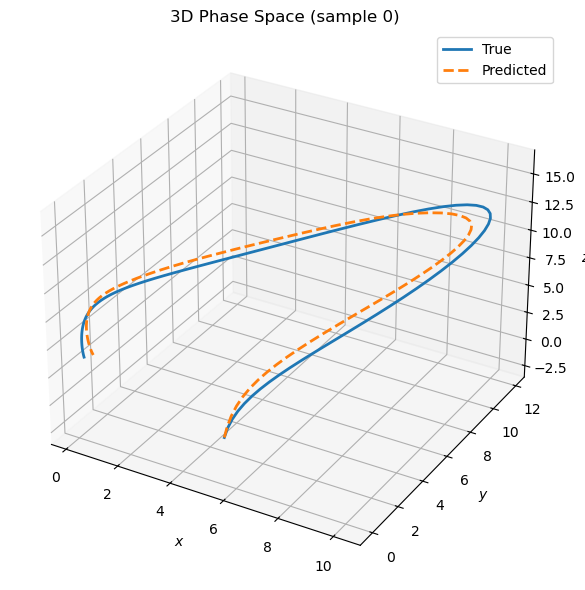

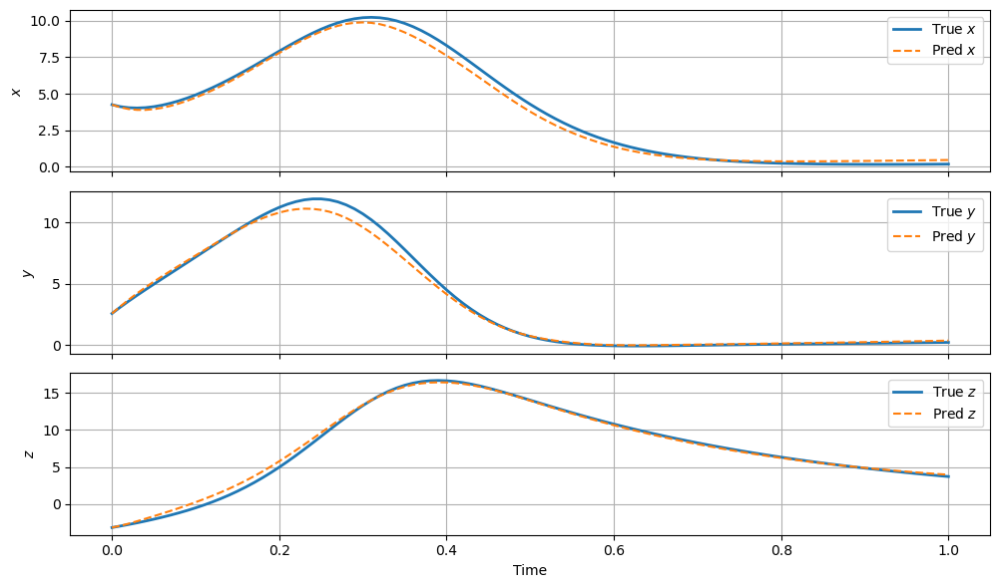

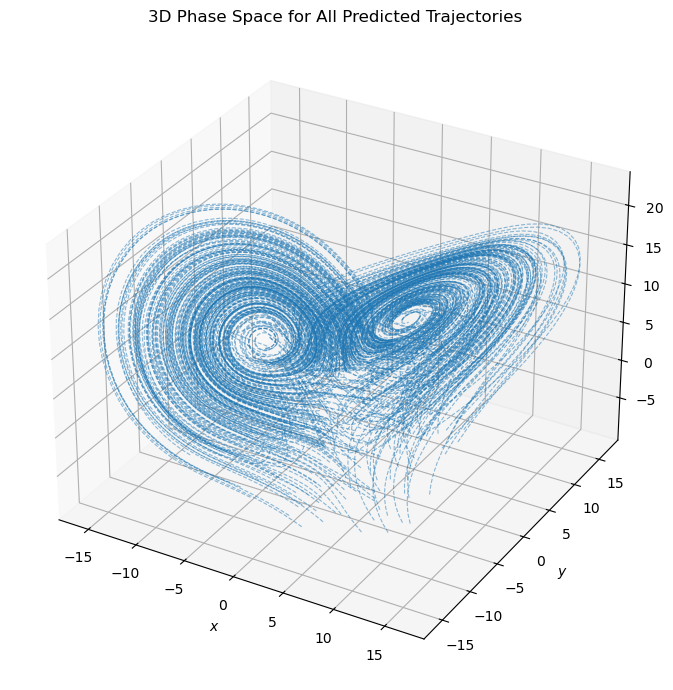

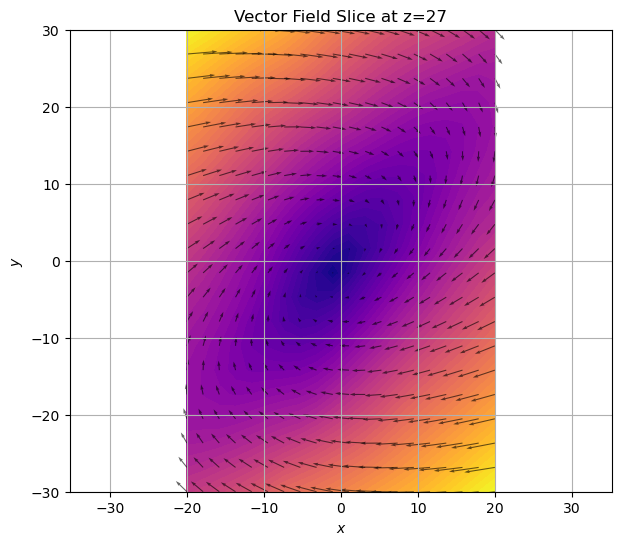

In [137]:
sample_idx = 0
plot_phase_space_from_sample_3d(sample_idx, dataset, learner, t_span)
plot_trajectory_vs_time_from_sample_3d(sample_idx, dataset, learner, t_span)
plot_phase_space_for_all_samples_3d(dataset, learner, t_span)
plot_learned_vector_field_3d(learner.model.odefunc)

#### SINDy

In [138]:
trajectories = []
time_arrays = []

for i, (x0, t, traj) in enumerate(raw_dataset):
    trajectories.append(traj)
    time_arrays.append(t)

model = ps.SINDy(
    feature_library=ps.PolynomialLibrary(degree=2),
    optimizer=ps.STLSQ(threshold=0.02, alpha=0.01, max_iter=20),
    feature_names=['x', 'y', 'z'],
    differentiation_method=ps.FiniteDifference(order=2)
)

start_time = time.time()
model.fit(trajectories, t=time_arrays, multiple_trajectories=True)
end_time = time.time()

print("\nDiscovered equations:")
print("=" * 50)
model.print()
print("=" * 50)


Discovered equations:
(x)' = -9.993 x + 9.992 y
(y)' = 9.985 x + -1.002 y + -0.998 x z
(z)' = -2.662 z + 0.998 x y


In [139]:
def make_sindy_equations(model):
    coef = model.coefficients()

    # Create a function that computes each polynomial feature manually
    def equations(x, y, z):
        input_features = np.array([
            1,
            x, y, z,
            x**2, x*y, x*z,
            y**2, y*z, z**2
        ])

        dxdt = np.dot(coef[0], input_features)
        dydt = np.dot(coef[1], input_features)
        dzdt = np.dot(coef[2], input_features)

        return np.array([dxdt, dydt, dzdt])

    return equations

test_starting_points = [
    np.random.uniform([-10, -10, -10], [10, 10, 10]) for _ in range(400)
]

real_data = generate_dataset(equations, time_span=1, starting_points=test_starting_points)
sindy_data = generate_dataset(make_sindy_equations(model), time_span=1, starting_points=test_starting_points)

In [140]:
def evaluate_errors_sindy(real_dataset=None, sindy_dataset=None):
    assert len(real_dataset) == len(sindy_dataset), "Datasets must have same length"

    mse_total = 0
    mae_total = 0
    chamfer_total = 0
    hausdorff_total = 0
    total = len(real_dataset)

    with torch.no_grad():
        for i in range(total):
            true_traj = real_dataset[i]['trajectory'].numpy()
            pred_traj = sindy_dataset[i]['trajectory'].numpy()

            # Ensure they are the same length
            n_compare = min(len(true_traj), len(pred_traj))
            true_traj = true_traj[:n_compare]
            pred_traj = pred_traj[:n_compare]

            # Mean Squared Error
            mse_total += np.mean((true_traj - pred_traj) ** 2)

            # Mean Absolute Error
            mae_total += np.mean(np.abs(true_traj - pred_traj))

            # Chamfer Distance
            d_true_to_pred = np.mean([np.min(np.sum((pred_traj - pt)**2, axis=1)) for pt in true_traj])
            d_pred_to_true = np.mean([np.min(np.sum((true_traj - pt)**2, axis=1)) for pt in pred_traj])
            chamfer_total += d_true_to_pred + d_pred_to_true

            # Hausdorff Distance (symmetric)
            hausdorff_ab = directed_hausdorff(true_traj, pred_traj)[0]
            hausdorff_ba = directed_hausdorff(pred_traj, true_traj)[0]
            hausdorff_total += max(hausdorff_ab, hausdorff_ba)

    return {
        'mse': mse_total / total,
        'mae': mae_total / total,
        'chamfer': chamfer_total / total,
        'hausdorff': hausdorff_total / total
    }

In [141]:
errors = evaluate_errors_sindy(Dataset(real_data), Dataset(sindy_data))

# Print results
print(f"Time taken to train in seconds: {end_time - start_time:.2f}")
print("MSE:", errors['mse'])
print("MAE:", errors['mae'])
print("Chamfer:", errors['chamfer'])
print("Hausdorff:", errors['hausdorff'])

Time taken to train in seconds: 0.19
MSE: 0.0005464195880244915
MAE: 0.014815309433906805
Chamfer: 0.00257935976038425
Hausdorff: 0.05323044848116022


### Chaotic Regime

#### Input

In [142]:
def equations(x, y, z):
  σ = 10
  ρ = 28 # 0.8 for fixed, 10 for stable, 28 for butterfly chaos
  β = 8 / 3
  return np.array([
      σ * (y - x),
      x * (ρ - z) - y,
      x * y - β * z
  ])

#### Train

In [143]:
# Create your dataset and datamodule
raw_dataset = generate_dataset(equations, num_trajectories=400, time_span=1)
dataset = Dataset(raw_dataset)
data_module = DataModule(dataset)

# Define model
f = nn.Sequential(
    nn.Linear(3, 64),
    nn.SiLU(),
    nn.Linear(64, 3)
)
model = ODEBlock(f, adjoint=True)

# Define learner
t_span = torch.tensor(raw_dataset[0][1], dtype=torch.float32)  # all have same time steps
learner = Learner(model, t_span)

# Train
start_time = time.time()
trainer = pl.Trainer(
    max_epochs=400,
    accelerator="cpu",
    devices=1,
    callbacks=[
        pl.callbacks.ModelCheckpoint(monitor="val_loss", mode="min"),
        pl.callbacks.RichProgressBar()
    ],
    log_every_n_steps=1,
    default_root_dir="/lightning_logs"
)
trainer.fit(learner, datamodule=data_module)
end_time = time.time()

# Validate and test
val_result = trainer.validate(learner, datamodule=data_module)
test_result = trainer.test(learner, datamodule=data_module)

# Evaluate errors
errors = evaluate_errors(dataset, learner, t_span)

# Print results
print(f"Time taken to train in seconds: {end_time - start_time:.2f}")
print("MSE:", errors['mse'])
print("MAE:", errors['mae'])
print("Chamfer:", errors['chamfer'])
print("Hausdorff:", errors['hausdorff'])

GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │    24.501976013183594     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    20.964004516601562     │
└───────────────────────────┴───────────────────────────┘

Time taken to train in seconds: 1738.28
MSE: 18.088229320645333
MAE: 2.739681834280491
Chamfer: 54.632075140476225
Hausdorff: 11.134752476975986


#### Plot

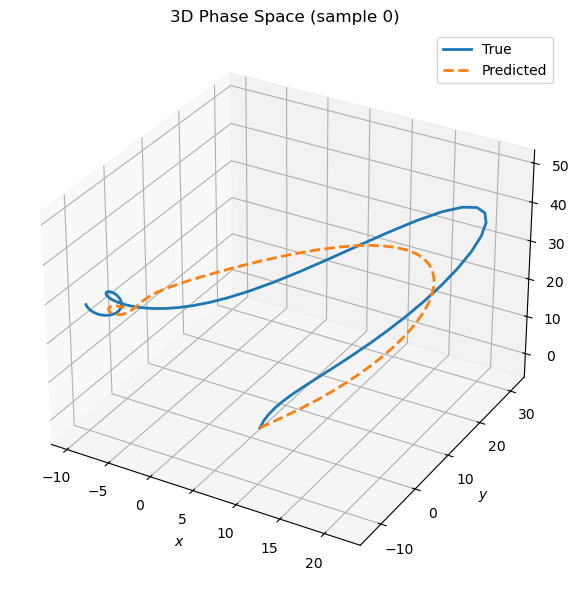

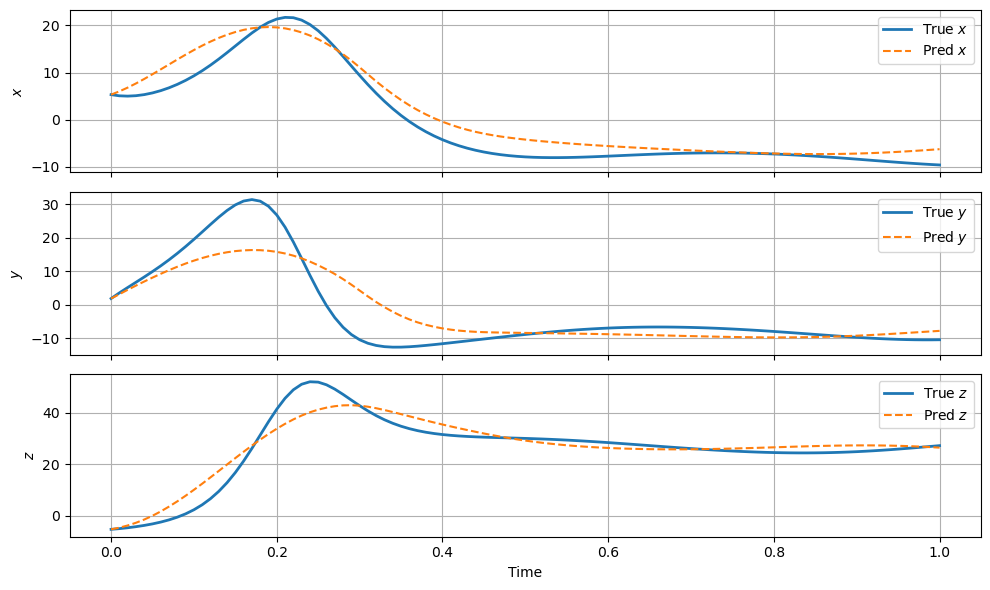

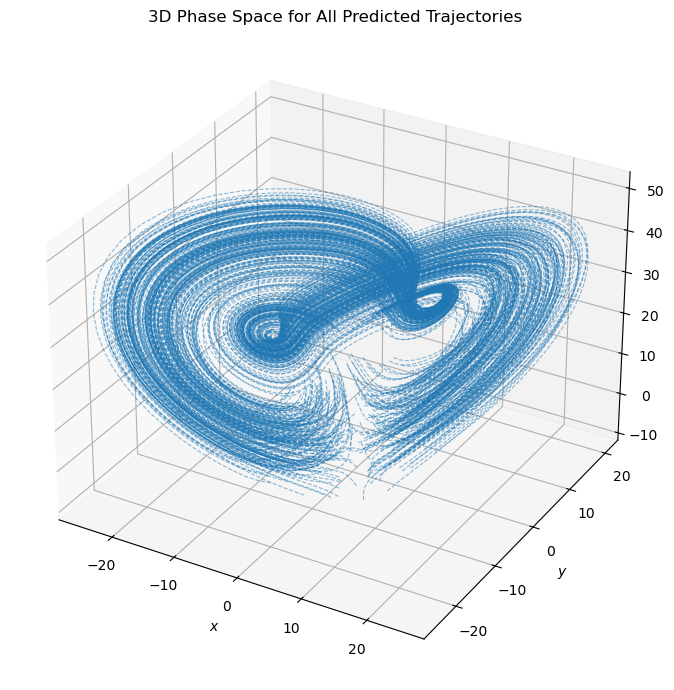

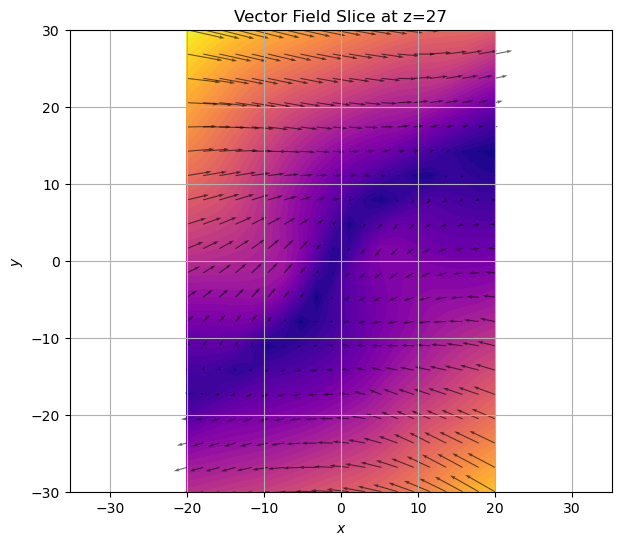

In [144]:
sample_idx = 0
plot_phase_space_from_sample_3d(sample_idx, dataset, learner, t_span)
plot_trajectory_vs_time_from_sample_3d(sample_idx, dataset, learner, t_span)
plot_phase_space_for_all_samples_3d(dataset, learner, t_span)
plot_learned_vector_field_3d(learner.model.odefunc)

#### SINDy

In [145]:
trajectories = []
time_arrays = []

for i, (x0, t, traj) in enumerate(raw_dataset):
    trajectories.append(traj)
    time_arrays.append(t)

model = ps.SINDy(
    feature_library=ps.PolynomialLibrary(degree=2),
    optimizer=ps.STLSQ(threshold=0.02, alpha=0.01, max_iter=20),
    feature_names=['x', 'y', 'z'],
    differentiation_method=ps.FiniteDifference(order=2)
)

start_time = time.time()
model.fit(trajectories, t=time_arrays, multiple_trajectories=True)
end_time = time.time()

print("\nDiscovered equations:")
print("=" * 50)
model.print()
print("=" * 50)


Discovered equations:
(x)' = -9.964 x + 9.963 y
(y)' = 27.715 x + -0.951 y + -0.992 x z
(z)' = 0.436 1 + -2.661 z + 0.994 x y


In [146]:
test_starting_points = [
    np.random.uniform([-10, -10, -10], [10, 10, 10]) for _ in range(400)
]

real_data = generate_dataset(equations, time_span=1, starting_points=test_starting_points)
sindy_data = generate_dataset(make_sindy_equations(model), time_span=1, starting_points=test_starting_points)

In [147]:
errors = evaluate_errors_sindy(Dataset(real_data), Dataset(sindy_data))

# Print results
print(f"Time taken to train in seconds: {end_time - start_time:.2f}")
print("MSE:", errors['mse'])
print("MAE:", errors['mae'])
print("Chamfer:", errors['chamfer'])
print("Hausdorff:", errors['hausdorff'])

Time taken to train in seconds: 0.18
MSE: 0.2789541202399414
MAE: 0.18978292834945024
Chamfer: 0.29322617860510947
Hausdorff: 0.8098183369275567


## Comparing Activation Functions

In [148]:
# We use Lorenz (Chaotic) for this comparison
def equations(x, y, z):
  σ = 10
  ρ = 28 # 0.8 for fixed, 10 for stable, 28 for butterfly chaos
  β = 8 / 3
  return np.array([
      σ * (y - x),
      x * (ρ - z) - y,
      x * y - β * z
  ])

In [ ]:
activations = [nn.Tanh(), nn.ReLU(), nn.Sigmoid(), nn.Softplus(), nn.LeakyReLU(), nn.ELU(), nn.SiLU(),nn.GELU()]

# Create your dataset and datamodule
raw_dataset = generate_dataset(equations, num_trajectories=400, time_span=1)
dataset = Dataset(raw_dataset)
data_module = DataModule(dataset)

for activation in tqdm(activations):
    
    # Define model
    f = nn.Sequential(
        nn.Linear(3, 64),
        activation,
        nn.Linear(64, 3)
    )
    model = ODEBlock(f, adjoint=True)

    # Define learner
    t_span = torch.tensor(raw_dataset[0][1], dtype=torch.float32)  # all have same time steps
    learner = Learner(model, t_span)

    # Train
    start_time = time.time()
    trainer = pl.Trainer(
        max_epochs=400,
        accelerator="cpu",
        devices=1,
        callbacks=[
            pl.callbacks.ModelCheckpoint(monitor="val_loss", mode="min"),
            pl.callbacks.RichProgressBar()
        ],
        log_every_n_steps=1,
        default_root_dir="/lightning_logs"
    )
    trainer.fit(learner, datamodule=data_module)
    end_time = time.time()

    # Validate and test
    val_result = trainer.validate(learner, datamodule=data_module)
    test_result = trainer.test(learner, datamodule=data_module)

    # Evaluate errors
    errors = evaluate_errors(dataset, learner, t_span)

    # Print results
    print(f"Activation: {activation}")
    print(f"Time taken to train in seconds: {end_time - start_time:.2f}")
    print("MSE:", errors['mse'])
    print("MAE:", errors['mae'])
    print("Chamfer:", errors['chamfer'])
    print("Hausdorff:", errors['hausdorff'])
    torch.save(learner.state_dict(), f"{activation}.pt")

  0%|          | 0/9 [00:00<?, ?it/s]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │     79.98480224609375     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     76.35882568359375     │
└───────────────────────────┴───────────────────────────┘

 11%|█         | 1/9 [29:06<3:52:55, 1746.95s/it]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: Tanh()
Time taken to train in seconds: 1737.90
MSE: 70.61401330471038
MAE: 5.5257313269376755
Chamfer: 208.66501050949097
Hausdorff: 29.253217539262483


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │     39.59756851196289     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │    48.753517150878906     │
└───────────────────────────┴───────────────────────────┘

 22%|██▏       | 2/9 [1:07:39<4:02:39, 2079.91s/it]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: ReLU()
Time taken to train in seconds: 2303.18
MSE: 46.988489112854005
MAE: 4.4884699004888535
Chamfer: 106.2448985004425
Hausdorff: 14.89832111199235


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │     77.08494567871094     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     83.51979064941406     │
└───────────────────────────┴───────────────────────────┘

 33%|███▎      | 3/9 [1:38:26<3:17:20, 1973.35s/it]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: Sigmoid()
Time taken to train in seconds: 1832.10
MSE: 81.50986110687256
MAE: 6.286524920463562
Chamfer: 253.11886554718018
Hausdorff: 31.939082585166567


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │     68.80833435058594     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     82.83079528808594     │
└───────────────────────────┴───────────────────────────┘

 44%|████▍     | 4/9 [2:10:35<2:42:59, 1955.99s/it]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: Softplus(beta=1.0, threshold=20.0)
Time taken to train in seconds: 1921.05
MSE: 66.524743206501
MAE: 5.352773537039757
Chamfer: 152.37140363693237
Hausdorff: 17.00713450636951


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │    59.727394104003906     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     30.2059268951416      │
└───────────────────────────┴───────────────────────────┘

 56%|█████▌    | 5/9 [2:46:54<2:15:45, 2036.33s/it]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: LeakyReLU(negative_slope=0.01)
Time taken to train in seconds: 2169.59
MSE: 53.33715685844422
MAE: 4.615514813065529
Chamfer: 121.81001482009887
Hausdorff: 15.138929916393069


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │    46.843196868896484     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     33.05756378173828     │
└───────────────────────────┴───────────────────────────┘

 67%|██████▋   | 6/9 [3:14:36<1:35:26, 1908.92s/it]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: ELU(alpha=1.0)
Time taken to train in seconds: 1653.17
MSE: 46.68462444543839
MAE: 4.709338878393173
Chamfer: 122.96692361831666
Hausdorff: 16.264036238689332


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │     50.51727294921875     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     40.95844650268555     │
└───────────────────────────┴───────────────────────────┘

 78%|███████▊  | 7/9 [3:42:10<1:00:51, 1825.63s/it]GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: SiLU()
Time taken to train in seconds: 1644.87
MSE: 33.425766900777816
MAE: 3.5891082525253295
Chamfer: 88.21157789230347
Hausdorff: 13.928571307180556


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

`Trainer.fit` stopped: `max_epochs=400` reached.


Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃      Validate metric      ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         val_loss          │     44.15105438232422     │
└───────────────────────────┴───────────────────────────┘

Output()

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│         test_loss         │     73.18937683105469     │
└───────────────────────────┴───────────────────────────┘

 89%|████████▉ | 8/9 [4:26:34<34:52, 2092.59s/it]  GPU available: False, used: False
TPU available: False, using: 0 TPU cores
HPU available: False, using: 0 HPUs


Activation: GELU(approximate='none')
Time taken to train in seconds: 2649.64
MSE: 53.25375913619995
MAE: 5.008119229078293
Chamfer: 139.9088849067688
Hausdorff: 17.999727968513362


┏━━━┳━━━━━━━┳━━━━━━━━━━┳━━━━━━━━┳━━━━━━━┓
┃   ┃ Name  ┃ Type     ┃ Params ┃ Mode  ┃
┡━━━╇━━━━━━━╇━━━━━━━━━━╇━━━━━━━━╇━━━━━━━┩
│ 0 │ model │ ODEBlock │    451 │ train │
└───┴───────┴──────────┴────────┴───────┘

Trainable params: 451                                                                                              
Non-trainable params: 0                                                                                            
Total params: 451                                                                                                  
Total estimated model params size (MB): 0                                                                          
Modules in train mode: 6                                                                                           
Modules in eval mode: 0

Output()

 89%|████████▉ | 8/9 [4:26:34<33:19, 1999.34s/it]


RuntimeError: mat1 and mat2 shapes cannot be multiplied (32x32 and 64x3)

In [150]:
activations = {
    "Tanh": nn.Tanh(),
    "ReLU": nn.ReLU(),
    "Sigmoid": nn.Sigmoid(),
    "Softplus": nn.Softplus(),
    "LeakyReLU": nn.LeakyReLU(),
    "ELU": nn.ELU(),
    "SiLU": nn.SiLU(),
    "GELU": nn.GELU(),
}
results = []
raw_dataset = generate_dataset(equations, num_trajectories=400, time_span=1)
dataset = Dataset(raw_dataset)
data_module = DataModule(dataset)
t_span = torch.tensor(raw_dataset[0][1], dtype=torch.float32)

In [151]:
for name, act in tqdm(activations.items()):
    f = nn.Sequential(
        nn.Linear(3, 64),
        act,
        nn.Linear(64, 3)
    )
    model = ODEBlock(f, adjoint=True)
    learner = Learner(model, t_span)
    learner.load_state_dict(torch.load(f"{act}.pt"))
    errors = evaluate_errors(dataset, learner, t_span)
    results.append({
        "Name": name,
        "Params": 451,
        "MSE": errors['mse'],
        "MAE": errors['mae'],
        "Chamfer": errors['chamfer'],
        "Hausdorff": errors['hausdorff']
    })


  0%|          | 0/8 [00:00<?, ?it/s]C:\Users\singh\AppData\Local\Temp\ipykernel_26764\297876817.py:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  learner.load_state_dict(

These results are different from the ones shown in the report, where we use the results from the notebook (3D__Chaos__Neural_ODE_compare_activation.ipynb) in the Appendix. However, SiLU still performs better so it does not change the overall argument.

In [152]:
df = pd.DataFrame(results)
df_sorted = df.sort_values(by="MSE")
df_sorted

,Name,Params,MSE,MAE,Chamfer,Hausdorff
6,SiLU,451,34.798450,3.669359,91.065510,14.032328
5,ELU,451,43.169737,4.556417,119.494318,16.041524
1,ReLU,451,48.108186,4.520766,104.984617,14.767367
7,GELU,451,52.939441,4.963564,136.450670,17.896485
4,LeakyReLU,451,55.473229,4.715223,125.555498,15.092452
3,Softplus,451,66.058859,5.336371,151.587915,16.811332
0,Tanh,451,71.288701,5.571841,211.065785,29.395321
2,Sigmoid,451,82.358037,6.310188,254.473744,32.121226
